# MÉTODO DE ENTRADA DE VENTANA SÓLO VALOR 288 - 96

In [1]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '1'

In [2]:
import tensorflow as tf
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error
import matplotlib.pyplot as plt
from array import *
from pickle import dump
import math

import numpy as np
import pandas as pd
import seaborn as sns

np.random.seed(123)

from sklearn.preprocessing import StandardScaler, MinMaxScaler, MaxAbsScaler
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)

In [3]:
FILEPATH = "../../datasources/THC-id-17.csv"
df_original = pd.read_csv(FILEPATH, parse_dates=True)

FILEPATH = "../../datasources/THC-id-17-preprocessed.csv"
df = pd.read_csv(FILEPATH, parse_dates=True)

In [4]:
df_original

,datetime,id,value
0,2019-01-01 03:00:00,17.0,0.087
1,2019-01-01 03:15:00,17.0,0.100
2,2019-01-01 03:30:00,17.0,0.084
3,2019-01-01 03:45:00,17.0,0.057
4,2019-01-01 04:00:00,17.0,0.167
...,...,...,...
64588,2020-11-03 22:00:00,17.0,0.031
64589,2020-11-03 22:15:00,17.0,0.055
64590,2020-11-03 22:30:00,17.0,0.019
64591,2020-11-03 22:45:00,17.0,0.021


In [5]:
df

,day_sin,day_cos,week_sin,week_cos,year_sin,year_cos,value
0,0.707107,0.707107,-0.993712,-0.111964,0.004172,0.999991,0.087
1,0.751840,0.659346,-0.994716,-0.102669,0.004351,0.999991,0.100
2,0.793353,0.608761,-0.995632,-0.093364,0.004530,0.999990,0.084
3,0.831470,0.555570,-0.996461,-0.084051,0.004709,0.999989,0.057
4,0.866025,0.500000,-0.997204,-0.074730,0.004888,0.999988,0.167
...,...,...,...,...,...,...,...
64588,-0.500000,0.866025,-0.826239,0.563320,-0.835100,0.550099,0.031
64589,-0.442289,0.896873,-0.820936,0.571021,-0.835001,0.550248,0.055
64590,-0.382683,0.923880,-0.815561,0.578671,-0.834902,0.550398,0.019
64591,-0.321439,0.946930,-0.810115,0.586271,-0.834804,0.550548,0.021


In [6]:
df

,day_sin,day_cos,week_sin,week_cos,year_sin,year_cos,value
0,0.707107,0.707107,-0.993712,-0.111964,0.004172,0.999991,0.087
1,0.751840,0.659346,-0.994716,-0.102669,0.004351,0.999991,0.100
2,0.793353,0.608761,-0.995632,-0.093364,0.004530,0.999990,0.084
3,0.831470,0.555570,-0.996461,-0.084051,0.004709,0.999989,0.057
4,0.866025,0.500000,-0.997204,-0.074730,0.004888,0.999988,0.167
...,...,...,...,...,...,...,...
64588,-0.500000,0.866025,-0.826239,0.563320,-0.835100,0.550099,0.031
64589,-0.442289,0.896873,-0.820936,0.571021,-0.835001,0.550248,0.055
64590,-0.382683,0.923880,-0.815561,0.578671,-0.834902,0.550398,0.019
64591,-0.321439,0.946930,-0.810115,0.586271,-0.834804,0.550548,0.021


### División de los datos

In [7]:
train_df, aux = train_test_split(df, test_size=0.3, shuffle=False)
test_df, val_df = train_test_split(aux, test_size=0.5, shuffle=False)

In [8]:
train_df

,day_sin,day_cos,week_sin,week_cos,year_sin,year_cos,value
0,0.707107,0.707107,-0.993712,-0.111964,0.004172,0.999991,0.087
1,0.751840,0.659346,-0.994716,-0.102669,0.004351,0.999991,0.100
2,0.793353,0.608761,-0.995632,-0.093364,0.004530,0.999990,0.084
3,0.831470,0.555570,-0.996461,-0.084051,0.004709,0.999989,0.057
4,0.866025,0.500000,-0.997204,-0.074730,0.004888,0.999988,0.167
...,...,...,...,...,...,...,...
45210,0.382683,0.923880,0.056070,0.998427,0.968510,-0.248976,0.041
45211,0.442289,0.896873,0.065403,0.997859,0.968465,-0.249150,0.024
45212,0.500000,0.866025,0.074730,0.997204,0.968420,-0.249323,0.017
45213,0.555570,0.831470,0.084051,0.996461,0.968376,-0.249497,0.046


In [9]:
test_df

,day_sin,day_cos,week_sin,week_cos,year_sin,year_cos,value
45215,6.593458e-01,0.751840,0.102669,0.994716,0.968286,-0.249844,0.016
45216,7.071068e-01,0.707107,0.111964,0.993712,0.968241,-0.250017,0.046
45217,7.518398e-01,0.659346,0.121251,0.992622,0.968197,-0.250191,0.009
45218,7.933533e-01,0.608761,0.130526,0.991445,0.968152,-0.250364,0.003
45219,8.314696e-01,0.555570,0.139790,0.990181,0.968107,-0.250538,0.034
...,...,...,...,...,...,...,...
54899,-6.540313e-02,0.997859,0.442289,-0.896873,-0.405068,-0.914287,0.018
54900,-5.539676e-12,1.000000,0.433884,-0.900969,-0.405231,-0.914214,0.018
54901,6.540313e-02,0.997859,0.425441,-0.904986,-0.405395,-0.914142,0.038
54902,1.305262e-01,0.991445,0.416961,-0.908924,-0.405559,-0.914069,0.039


In [10]:
val_df

,day_sin,day_cos,week_sin,week_cos,year_sin,year_cos,value
54904,0.258819,0.965926,0.399892,-0.916562,-0.405887,-0.913923,0.018
54905,0.321439,0.946930,0.391305,-0.920261,-0.406050,-0.913851,0.017
54906,0.382683,0.923880,0.382683,-0.923880,-0.406214,-0.913778,0.018
54907,0.442289,0.896873,0.374029,-0.927417,-0.406378,-0.913705,0.048
54908,0.500000,0.866025,0.365341,-0.930874,-0.406541,-0.913632,0.024
...,...,...,...,...,...,...,...
64588,-0.500000,0.866025,-0.826239,0.563320,-0.835100,0.550099,0.031
64589,-0.442289,0.896873,-0.820936,0.571021,-0.835001,0.550248,0.055
64590,-0.382683,0.923880,-0.815561,0.578671,-0.834902,0.550398,0.019
64591,-0.321439,0.946930,-0.810115,0.586271,-0.834804,0.550548,0.021


## Funciones auxiliares

In [11]:
def split_data(data, n_input, n_out):
    X, y = list(), list()
    in_start = 0
    
    for _ in range(len(data)):
        in_end = in_start + n_input
        out_end = in_end + n_out
        if out_end <= len(data):
            X.append(np.array(data.iloc[in_start:in_end, -1]))
            y.append(np.array(data.iloc[in_end:out_end, -1]))
        in_start += 1
        
    return np.array(X).reshape(len(X), n_input, 1), np.array(y)

In [12]:
def plot_history(history):
    hist = pd.DataFrame(history.history)
    hist['epoch'] = history.epoch
    plt.figure()
    plt.xlabel('Epoch')
    plt.ylabel('Mean Abs Error [MPG]')
    plt.plot(hist['epoch'], hist['mae'], label='Train Error')
    plt.plot(hist['epoch'], hist['val_mae'], label = 'Val Error')
    plt.ylim(bottom=0)
    plt.legend()
    plt.figure()
    plt.xlabel('Epoch')
    plt.ylabel('Mean Square Error [$MPG^2$]')
    plt.plot(hist['epoch'], hist['mse'], label='Train Error')
    plt.plot(hist['epoch'], hist['val_mse'], label = 'Val Error')
    plt.ylim(bottom=0)
    plt.legend()
    plt.show()

In [13]:
def plot_window_predictions(index_min, index_max, real_outputs, pred_outputs, num_plots, start):
    for n in range(start, start + num_plots):
        limit = index_min + n + n_entrada
        input_indices = np.array(df_original['datetime'].iloc[index_min + n : limit])
        input_values = np.array(df_original['value'].iloc[index_min + n : limit])
        output_indices = np.array(df_original['datetime'].iloc[limit : limit + n_predicciones])
        real_values = real_outputs[n]
        pred_values = pred_outputs[n]
        
        plt.figure()
        plt.xlabel('Time')
        plt.ylabel(f'Valores de prediccion - Iteracion {n+1}')
        plt.scatter(input_indices, input_values, color='b',zorder=2)
        plt.plot(input_indices, input_values, label='Inputs', color='b', zorder=1)
        plt.scatter(output_indices, real_values, edgecolors='k', label='Real output', c='#2ca02c', s=64)
        plt.scatter(output_indices, pred_values, marker='X', edgecolors='k', label='Prediction output', c='#ff7f0e', s=64)
        plt.xticks(rotation = 90)
        plt.legend()

In [14]:
def plot_window_predictions_values(index_min, pred_outputs, max_plots):
    plt.figure()
    plt.xlabel('Time')
    plt.ylabel(f'Valores de prediccion')
    plt.plot(np.array(df_original['datetime'].iloc[index_min + n_entrada : index_min + n_entrada + max_plots + n_predicciones]), 
             np.array(df_original['value'].iloc[index_min + n_entrada : index_min + n_entrada + max_plots + n_predicciones]), 
             color='b', zorder=1)
    
    for n in range(max_plots):
        limit = index_min + n + n_entrada
        output_indices = np.array(df_original['datetime'].iloc[limit : limit + n_predicciones])
        pred_values = pred_outputs[n]
        
        plt.scatter(output_indices, pred_values, marker='X', edgecolors='k', label='Prediction output', c='#ff7f0e', s=64)
        plt.xticks(rotation = 90)

In [15]:
import tensorflow.keras.backend as K

def smape(y_true, y_pred):
    return K.mean(2*K.abs(y_pred-y_true)/(K.abs(y_true)+K.abs(y_pred)))

## Parámetros
####  En este caso vamos a generar una ventana de 288 valores de entrada que corresponde a los 3 días anteriores y una salida de 96 valores que corresponden al consumo del siguiente día

In [16]:
###### PARAMETERS ######
n_epochs = 200
batch_size = 128
n_entrada = 288           # Número de mediciones en los 3 días anteriores
n_predicciones = 96       # Mediciones en un día
n_features = 1 
########################

## Extraer datos de entrada y salida

In [17]:
data_trainX, data_trainY = split_data(train_df, n_entrada, n_predicciones)
data_valX, data_valY = split_data(val_df, n_entrada, n_predicciones)
data_testX, data_testY = split_data(test_df, n_entrada, n_predicciones)

In [18]:
data_trainX.shape

(44832, 288, 1)

In [19]:
data_trainY.shape

(44832, 96)

In [20]:
data_valX.shape

(9306, 288, 1)

In [21]:
data_valY.shape

(9306, 96)

In [22]:
data_testX.shape

(9306, 288, 1)

In [23]:
data_testY.shape

(9306, 96)

In [24]:
data_trainX[0]

array([[0.087],
       [0.1  ],
       [0.084],
       [0.057],
       [0.167],
       [0.053],
       [0.057],
       [0.058],
       [0.038],
       [0.018],
       [0.06 ],
       [0.053],
       [0.055],
       [0.055],
       [0.05 ],
       [0.05 ],
       [0.02 ],
       [0.035],
       [0.051],
       [0.022],
       [0.021],
       [0.051],
       [0.027],
       [0.019],
       [0.037],
       [0.043],
       [0.014],
       [0.017],
       [0.052],
       [0.029],
       [0.014],
       [0.015],
       [0.055],
       [0.025],
       [0.014],
       [0.02 ],
       [0.052],
       [0.029],
       [0.021],
       [0.386],
       [0.493],
       [0.028],
       [0.015],
       [0.162],
       [0.038],
       [0.02 ],
       [0.017],
       [0.19 ],
       [0.035],
       [0.017],
       [0.057],
       [0.06 ],
       [0.055],
       [0.052],
       [0.045],
       [0.054],
       [0.058],
       [0.359],
       [0.353],
       [0.055],
       [0.153],
       [0.048],
       [

In [25]:
data_trainY[0]

array([0.041, 0.01 , 0.015, 0.04 , 0.007, 0.014, 0.041, 0.003, 0.013,
       0.041, 0.004, 0.01 , 0.04 , 0.004, 0.006, 0.042, 0.007, 0.005,
       0.039, 0.013, 0.004, 0.026, 0.023, 0.004, 0.012, 0.036, 0.004,
       0.004, 0.032, 0.015, 0.004, 0.012, 0.035, 0.004, 0.004, 0.11 ,
       0.424, 0.406, 0.442, 0.384, 0.162, 0.169, 0.017, 0.005, 0.122,
       0.036, 0.004, 0.097, 0.041, 0.018, 0.018, 0.185, 0.063, 0.08 ,
       0.064, 0.03 , 0.041, 0.063, 0.035, 0.116, 0.096, 0.04 , 0.039,
       0.066, 0.063, 0.063, 0.062, 0.026, 0.047, 0.063, 0.062, 0.061,
       0.061, 0.062, 0.033, 0.186, 0.09 , 0.203, 0.063, 0.198, 0.08 ,
       0.057, 0.04 , 0.098, 0.223, 0.075, 0.081, 0.048, 0.064, 0.063,
       0.027, 0.039, 0.059, 0.028, 0.032, 0.05 ])

## Estandarización y normalización de los datos

In [26]:
# Normalizado
maxabs_scaler = MaxAbsScaler()
    
maxabs_scaler.fit(data_trainX.reshape(-1, data_trainX.shape[-1]))
    
scaled_trainX = maxabs_scaler.transform(data_trainX.reshape(-1, data_trainX.shape[-1])).reshape(data_trainX.shape)
scaled_valX = maxabs_scaler.transform(data_valX.reshape(-1, data_valX.shape[-1])).reshape(data_valX.shape)
scaled_testX = maxabs_scaler.transform(data_testX.reshape(-1, data_testX.shape[-1])).reshape(data_testX.shape)

In [27]:
scaled_trainX.shape

(44832, 288, 1)

In [28]:
scaled_valX.shape

(9306, 288, 1)

In [29]:
scaled_testX.shape

(9306, 288, 1)

In [30]:
scaled_trainX[0]

array([[0.12869822],
       [0.14792899],
       [0.12426036],
       [0.08431953],
       [0.24704142],
       [0.07840237],
       [0.08431953],
       [0.08579882],
       [0.05621302],
       [0.02662722],
       [0.0887574 ],
       [0.07840237],
       [0.08136095],
       [0.08136095],
       [0.0739645 ],
       [0.0739645 ],
       [0.0295858 ],
       [0.05177515],
       [0.07544379],
       [0.03254438],
       [0.03106509],
       [0.07544379],
       [0.03994083],
       [0.02810651],
       [0.05473373],
       [0.06360947],
       [0.02071006],
       [0.02514793],
       [0.07692308],
       [0.04289941],
       [0.02071006],
       [0.02218935],
       [0.08136095],
       [0.03698225],
       [0.02071006],
       [0.0295858 ],
       [0.07692308],
       [0.04289941],
       [0.03106509],
       [0.57100592],
       [0.72928994],
       [0.04142012],
       [0.02218935],
       [0.23964497],
       [0.05621302],
       [0.0295858 ],
       [0.02514793],
       [0.281

### Algunos modelos necesitan otros tipos de entrada

In [31]:
scaled_trainX_4D = scaled_trainX.reshape(scaled_trainX.shape[0], 1, n_entrada, n_features)
scaled_valX_4D = scaled_valX.reshape(scaled_valX.shape[0], 1, n_entrada, n_features)
scaled_testX_4D = scaled_testX.reshape(scaled_testX.shape[0], 1, n_entrada, n_features)

scaled_trainX_5D = scaled_trainX.reshape(scaled_trainX.shape[0], 1, 1, n_entrada, n_features)
scaled_valX_5D = scaled_valX.reshape(scaled_valX.shape[0], 1, 1, n_entrada, n_features)
scaled_testX_5D = scaled_testX.reshape(scaled_testX.shape[0], 1, 1, n_entrada, n_features)

data_trainY_3D = data_trainY.reshape(data_trainY.shape[0], 1, n_predicciones)
data_valY_3D = data_valY.reshape(data_valY.shape[0], 1, n_predicciones)
data_testY_3D = data_testY.reshape(data_testY.shape[0], 1, n_predicciones)

data_trainY_3D_2 = data_trainY.reshape(data_trainY.shape[0], n_predicciones, 1)
data_valY_3D_2 = data_valY.reshape(data_valY.shape[0], n_predicciones, 1)
data_testY_3D_2 = data_testY.reshape(data_testY.shape[0], n_predicciones, 1)

### Early stopping

In [32]:
early_stop = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=100)

# MODELO 1: LSTM DE UNA CAPA

### Construimos el modelo

In [33]:
def build_model1():
    model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(n_entrada, n_features)),
        tf.keras.layers.LSTM(128, activation='tanh'),
        tf.keras.layers.Dense(n_predicciones)
    ])

    optimizer = tf.keras.optimizers.Adam()

    model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', smape])

    return model

In [34]:
model1 = build_model1()
model1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 128)               66560     
                                                                 
 dense (Dense)               (None, 96)                12384     
                                                                 
Total params: 78,944
Trainable params: 78,944
Non-trainable params: 0
_________________________________________________________________


2022-06-24 05:41:05.565981: I tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-06-24 05:41:06.109529: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1525] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 28460 MB memory:  -> device: 0, name: Tesla V100-PCIE-32GB, pci bus id: 0000:d7:00.0, compute capability: 7.0


### Entrenamiento del modelo

In [35]:
history1 = model1.fit(scaled_trainX, data_trainY, epochs=n_epochs, batch_size = batch_size, 
                    validation_data=(scaled_valX, data_valY), verbose = 1, callbacks=[early_stop])

Epoch 1/200


2022-06-24 05:41:07.965217: I tensorflow/stream_executor/cuda/cuda_dnn.cc:366] Loaded cuDNN version 8100


351/351 [==============================] - 14s 35ms/step - loss: 0.0065 - mae: 0.0482 - mse: 0.0065 - smape: 0.8580 - val_loss: 0.0065 - val_mae: 0.0457 - val_mse: 0.0065 - val_smape: 0.8059
Epoch 2/200
351/351 [==============================] - 12s 34ms/step - loss: 0.0060 - mae: 0.0466 - mse: 0.0060 - smape: 0.8310 - val_loss: 0.0064 - val_mae: 0.0456 - val_mse: 0.0064 - val_smape: 0.7935
Epoch 3/200
351/351 [==============================] - 12s 34ms/step - loss: 0.0059 - mae: 0.0457 - mse: 0.0059 - smape: 0.8112 - val_loss: 0.0064 - val_mae: 0.0467 - val_mse: 0.0064 - val_smape: 0.8097
Epoch 4/200
351/351 [==============================] - 12s 33ms/step - loss: 0.0058 - mae: 0.0453 - mse: 0.0058 - smape: 0.7993 - val_loss: 0.0064 - val_mae: 0.0462 - val_mse: 0.0064 - val_smape: 0.7980
Epoch 5/200
351/351 [==============================] - 12s 35ms/step - loss: 0.0057 - mae: 0.0448 - mse: 0.0057 - smape: 0.7895 - val_loss: 0.0064 - val_mae: 0.0459 - val_mse: 0.0064 - val_smape: 0.79

351/351 [==============================] - 12s 34ms/step - loss: 0.0033 - mae: 0.0352 - mse: 0.0033 - smape: 0.7395 - val_loss: 0.0079 - val_mae: 0.0463 - val_mse: 0.0079 - val_smape: 0.8100
Epoch 82/200
351/351 [==============================] - 12s 34ms/step - loss: 0.0034 - mae: 0.0354 - mse: 0.0034 - smape: 0.7397 - val_loss: 0.0081 - val_mae: 0.0470 - val_mse: 0.0081 - val_smape: 0.8126
Epoch 83/200
351/351 [==============================] - 12s 34ms/step - loss: 0.0033 - mae: 0.0350 - mse: 0.0033 - smape: 0.7385 - val_loss: 0.0082 - val_mae: 0.0479 - val_mse: 0.0082 - val_smape: 0.8179
Epoch 84/200
351/351 [==============================] - 12s 33ms/step - loss: 0.0032 - mae: 0.0349 - mse: 0.0032 - smape: 0.7374 - val_loss: 0.0082 - val_mae: 0.0475 - val_mse: 0.0082 - val_smape: 0.8173
Epoch 85/200
351/351 [==============================] - 12s 33ms/step - loss: 0.0033 - mae: 0.0350 - mse: 0.0033 - smape: 0.7386 - val_loss: 0.0081 - val_mae: 0.0472 - val_mse: 0.0081 - val_smape: 

In [36]:
hist1 = pd.DataFrame(history1.history)
hist1['epoch'] = history1.epoch
hist1

,loss,mae,mse,smape,val_loss,val_mae,val_mse,val_smape,epoch
0,0.006532,0.048202,0.006532,0.857998,0.006500,0.045725,0.006500,0.805914,0
1,0.006012,0.046566,0.006012,0.830983,0.006438,0.045587,0.006438,0.793528,1
2,0.005866,0.045716,0.005866,0.811214,0.006436,0.046670,0.006436,0.809676,2
3,0.005789,0.045260,0.005789,0.799343,0.006411,0.046152,0.006411,0.798040,3
4,0.005724,0.044791,0.005724,0.789477,0.006429,0.045870,0.006429,0.792134,4
...,...,...,...,...,...,...,...,...,...
101,0.003037,0.034071,0.003037,0.733193,0.008143,0.046909,0.008143,0.810981,101
102,0.003035,0.034061,0.003035,0.733296,0.008254,0.047657,0.008254,0.812228,102
103,0.003035,0.034060,0.003035,0.732978,0.008242,0.047165,0.008242,0.820323,103
104,0.003028,0.034026,0.003028,0.732941,0.008156,0.047066,0.008156,0.810165,104


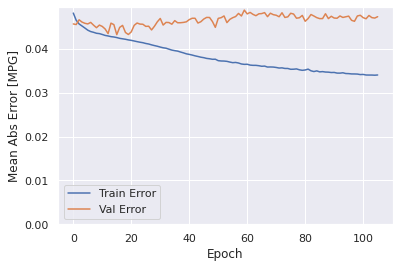

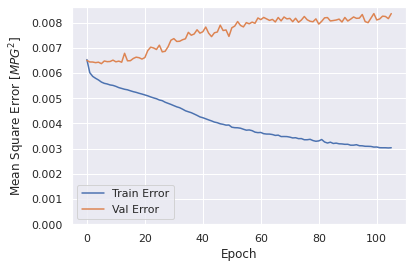

In [37]:
sns.set(rc = {'figure.figsize':(15,5), 'figure.dpi':80})
plot_history(history1)

### Evaluar predicciones

In [38]:
score_train1 = model1.evaluate(scaled_trainX, data_trainY, verbose=1)
print(f'Loss:{score_train1[0]}')
print(f'MAE:{score_train1[1]}')
print(f'MSE:{score_train1[2]}')
print(f'SMAPE:{score_train1[3]}')

1401/1401 [==============================] - 19s 13ms/step - loss: 0.0031 - mae: 0.0339 - mse: 0.0031 - smape: 0.7342
Loss:0.003064622636884451
MAE:0.033895984292030334
MSE:0.003064622636884451
SMAPE:0.7342253923416138


In [39]:
score_val1 = model1.evaluate(scaled_valX, data_valY, verbose=1)
print(f'Loss:{score_val1[0]}')
print(f'MAE:{score_val1[1]}')
print(f'MSE:{score_val1[2]}')
print(f'SMAPE:{score_val1[3]}')

291/291 [==============================] - 4s 13ms/step - loss: 0.0084 - mae: 0.0474 - mse: 0.0084 - smape: 0.8201
Loss:0.00835566408932209
MAE:0.04737890511751175
MSE:0.00835566408932209
SMAPE:0.8200663924217224


In [40]:
score_test1 = model1.evaluate(scaled_testX, data_testY, verbose=1)
print(f'Loss:{score_test1[0]}') 
print(f'MAE:{score_test1[1]}')
print(f'MSE:{score_test1[2]}')
print(f'SMAPE:{score_test1[3]}')

291/291 [==============================] - 4s 14ms/step - loss: 0.0077 - mae: 0.0479 - mse: 0.0077 - smape: 0.8174
Loss:0.007711861748248339
MAE:0.04790202155709267
MSE:0.007711861748248339
SMAPE:0.8174216747283936


### Comparativa de resultados

In [41]:
result = hist1.iloc[-1]
comparativa1 = pd.DataFrame(np.array([[result['mae'], result['mse'], result['smape'], math.sqrt(result['mse'])], 
                                      [result['val_mae'], result['val_mse'], result['val_smape'], math.sqrt(result['val_mse'])],
                                      [score_test1[1], score_test1[2], score_test1[3], math.sqrt(score_test1[2])]]),
                            columns = ['MAE', 'MSE', 'SMAPE', 'RMSE'],
                            index = ['ENTRENAMIENTO', 'VALIDACION', 'TEST'])

comparativa1.style.set_caption("Método de ventana de varios pasos - LSTM de una capa")

,MAE,MSE,SMAPE,RMSE
ENTRENAMIENTO,0.034076,0.003035,0.733233,0.055095
VALIDACION,0.047379,0.008356,0.820610,0.091409
TEST,0.047902,0.007712,0.817422,0.087817


### Obtener predicciones

In [42]:
trainPredict1 = model1.predict(scaled_trainX)
testPredict1 = model1.predict(scaled_testX)

### Visualización de las predicciones

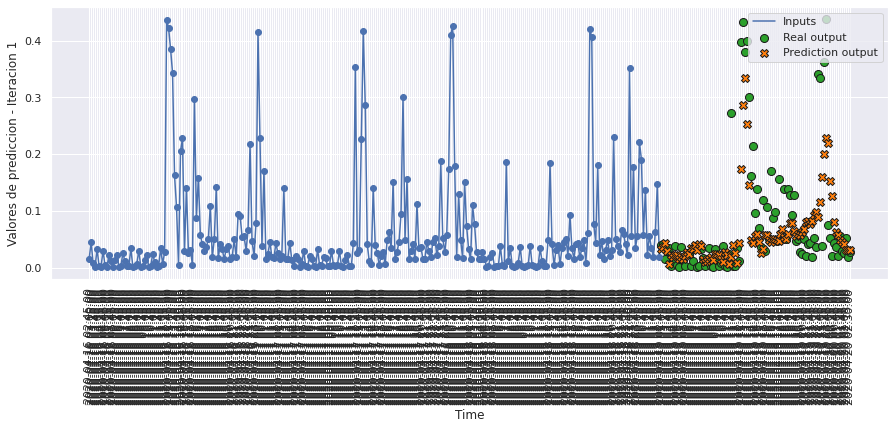

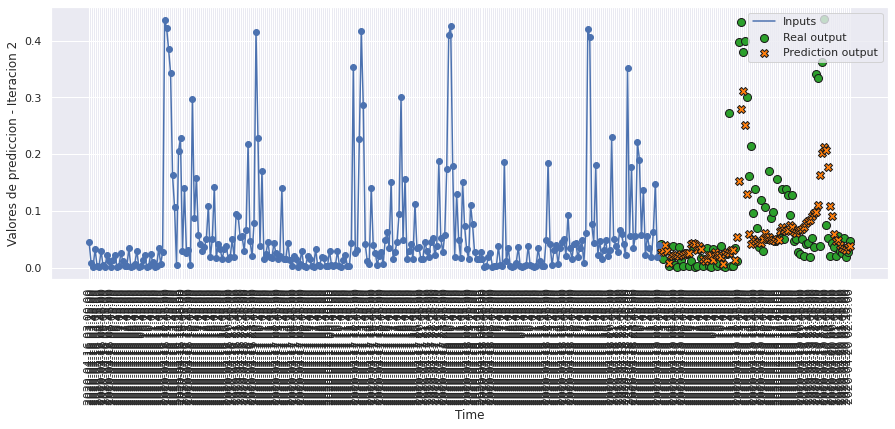

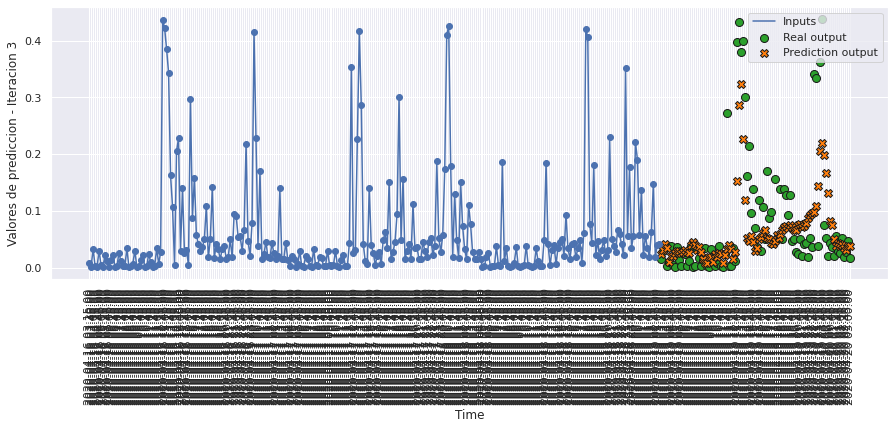

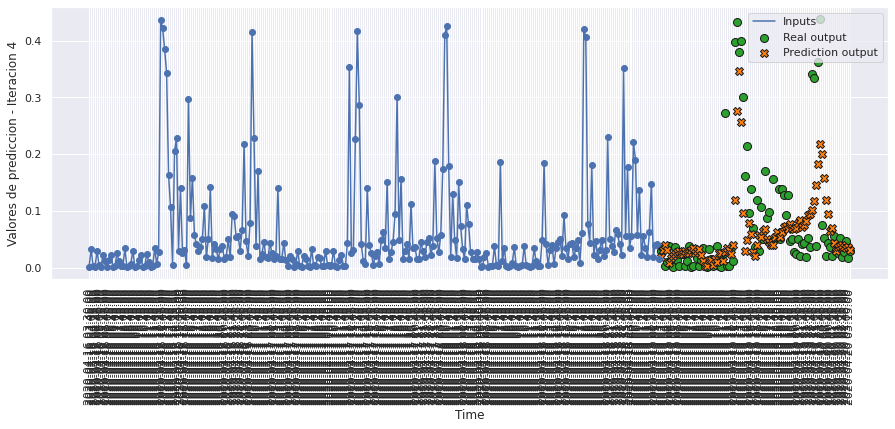

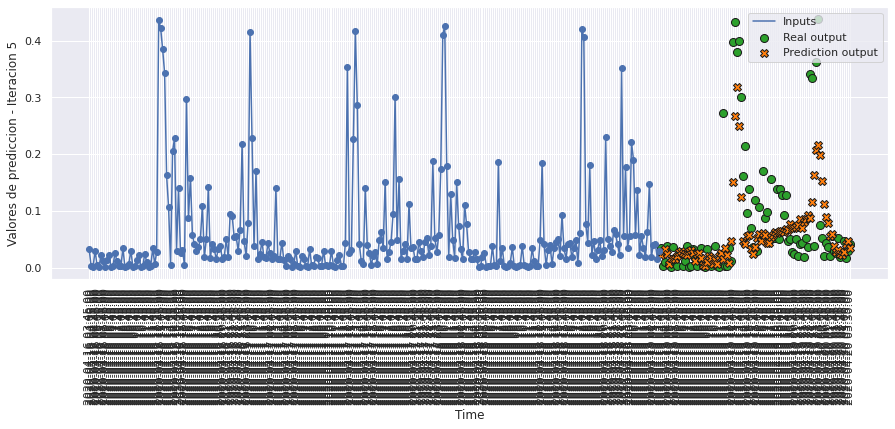

...

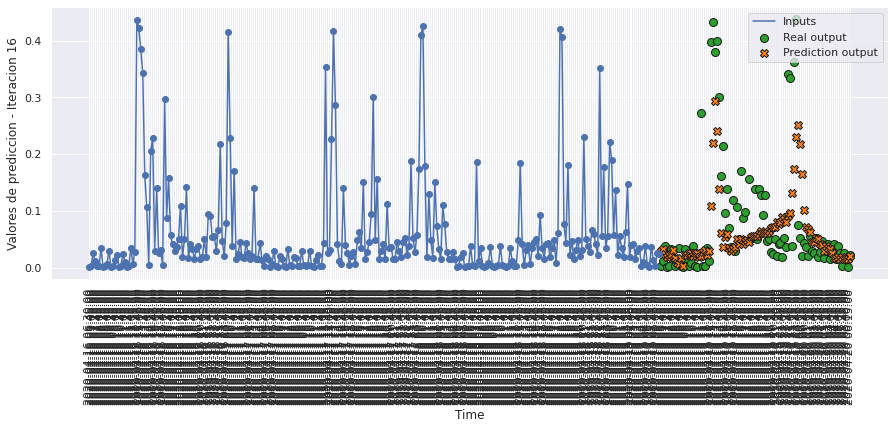

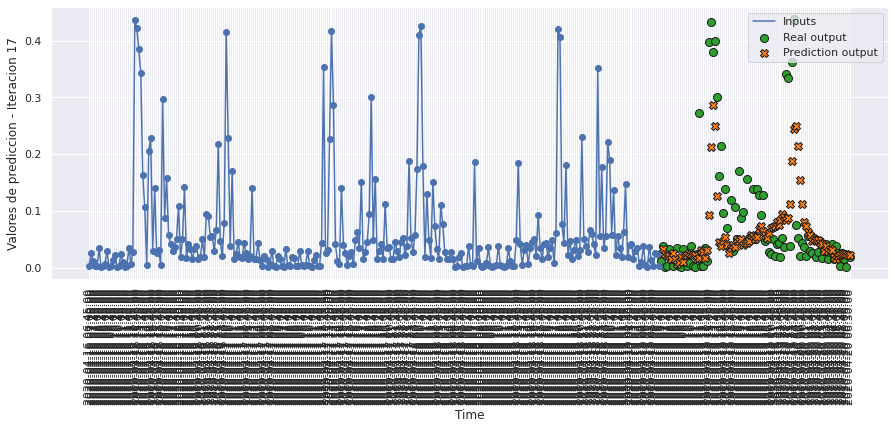

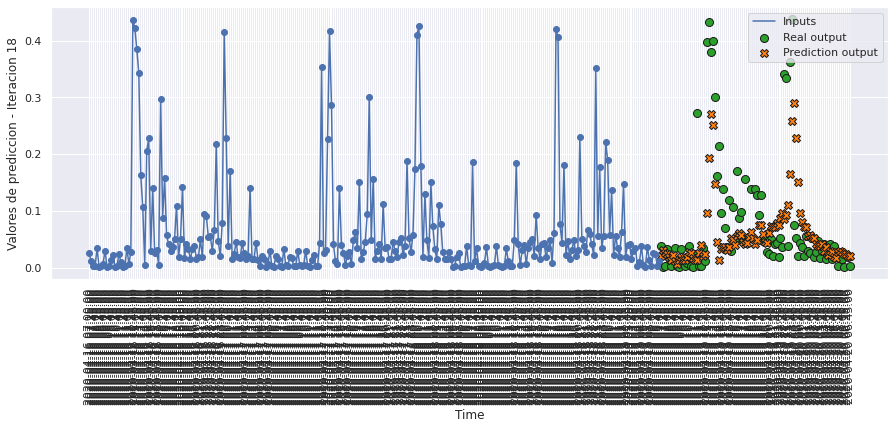

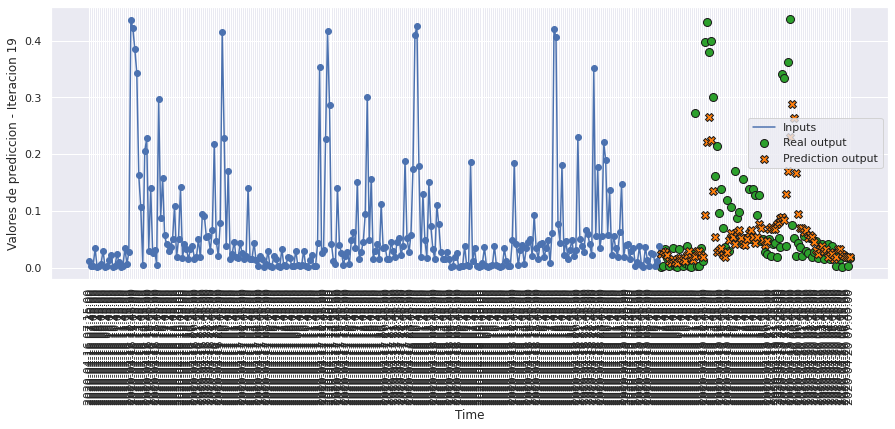

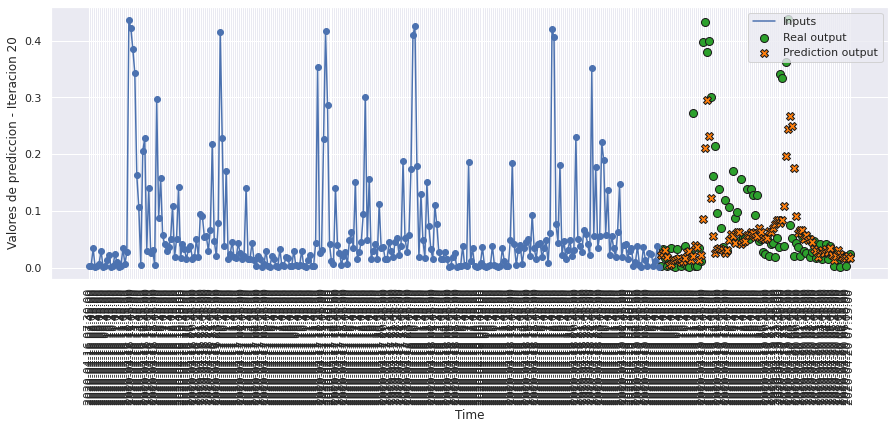

In [43]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_window_predictions(int(test_df.iloc[0].name), int(test_df.iloc[-1].name), data_testY, testPredict1, 20, 0)

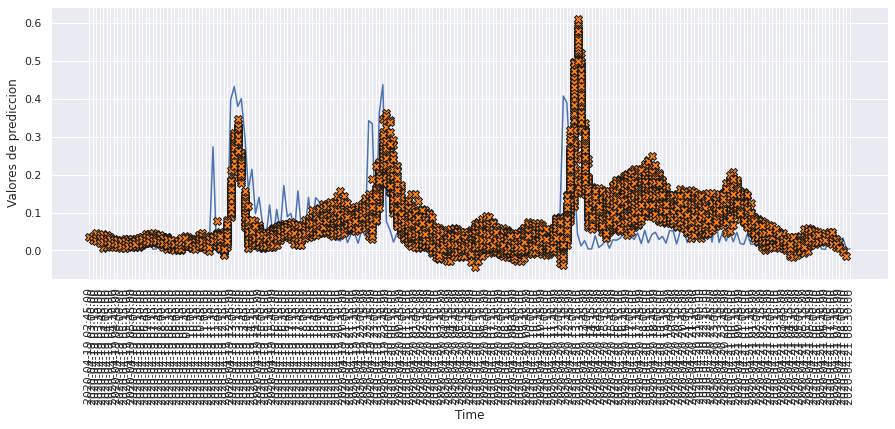

In [44]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict1, 120)

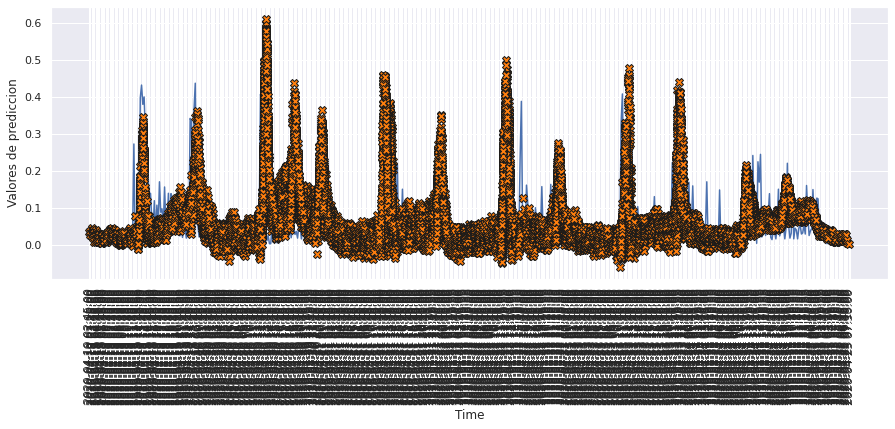

In [45]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict1, 500)

# MODELO 2: LSTM DE DOS CAPAS

### Construimos el modelo

In [46]:
def build_model2():
    model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(n_entrada, n_features)),
        tf.keras.layers.LSTM(128, activation='tanh', return_sequences = True),
        tf.keras.layers.LSTM(128, activation='tanh'),
        tf.keras.layers.Dense(n_predicciones)
    ])

    optimizer = tf.keras.optimizers.Adam()

    model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', smape])

    return model

In [47]:
model2 = build_model2()
model2.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_1 (LSTM)               (None, 288, 128)          66560     
                                                                 
 lstm_2 (LSTM)               (None, 128)               131584    
                                                                 
 dense_1 (Dense)             (None, 96)                12384     
                                                                 
Total params: 210,528
Trainable params: 210,528
Non-trainable params: 0
_________________________________________________________________


### Entrenamiento del modelo

In [48]:
history2 = model2.fit(scaled_trainX, data_trainY, epochs=n_epochs, batch_size = batch_size, 
                    validation_data=(scaled_valX, data_valY), verbose = 1, callbacks=[early_stop])

Epoch 1/200
351/351 [==============================] - 24s 64ms/step - loss: 0.0064 - mae: 0.0480 - mse: 0.0064 - smape: 0.8543 - val_loss: 0.0065 - val_mae: 0.0471 - val_mse: 0.0065 - val_smape: 0.8206
Epoch 2/200
351/351 [==============================] - 22s 63ms/step - loss: 0.0059 - mae: 0.0461 - mse: 0.0059 - smape: 0.8215 - val_loss: 0.0064 - val_mae: 0.0460 - val_mse: 0.0064 - val_smape: 0.8050
Epoch 3/200
351/351 [==============================] - 22s 63ms/step - loss: 0.0058 - mae: 0.0453 - mse: 0.0058 - smape: 0.8045 - val_loss: 0.0065 - val_mae: 0.0459 - val_mse: 0.0065 - val_smape: 0.7972
Epoch 4/200
351/351 [==============================] - 22s 62ms/step - loss: 0.0057 - mae: 0.0447 - mse: 0.0057 - smape: 0.7910 - val_loss: 0.0064 - val_mae: 0.0455 - val_mse: 0.0064 - val_smape: 0.7927
Epoch 5/200
351/351 [==============================] - 22s 63ms/step - loss: 0.0056 - mae: 0.0442 - mse: 0.0056 - smape: 0.7848 - val_loss: 0.0064 - val_mae: 0.0455 - val_mse: 0.0064 - val

351/351 [==============================] - 22s 62ms/step - loss: 0.0021 - mae: 0.0293 - mse: 0.0021 - smape: 0.6949 - val_loss: 0.0081 - val_mae: 0.0448 - val_mse: 0.0081 - val_smape: 0.7793
Epoch 82/200
351/351 [==============================] - 22s 63ms/step - loss: 0.0021 - mae: 0.0292 - mse: 0.0021 - smape: 0.6944 - val_loss: 0.0081 - val_mae: 0.0449 - val_mse: 0.0081 - val_smape: 0.7781
Epoch 83/200
351/351 [==============================] - 22s 62ms/step - loss: 0.0021 - mae: 0.0291 - mse: 0.0021 - smape: 0.6934 - val_loss: 0.0080 - val_mae: 0.0443 - val_mse: 0.0080 - val_smape: 0.7749
Epoch 84/200
351/351 [==============================] - 22s 62ms/step - loss: 0.0021 - mae: 0.0291 - mse: 0.0021 - smape: 0.6937 - val_loss: 0.0079 - val_mae: 0.0446 - val_mse: 0.0079 - val_smape: 0.7794
Epoch 85/200
351/351 [==============================] - 22s 64ms/step - loss: 0.0021 - mae: 0.0290 - mse: 0.0021 - smape: 0.6930 - val_loss: 0.0079 - val_mae: 0.0442 - val_mse: 0.0079 - val_smape: 

In [49]:
hist2 = pd.DataFrame(history2.history)
hist2['epoch'] = history2.epoch
hist2

,loss,mae,mse,smape,val_loss,val_mae,val_mse,val_smape,epoch
0,0.006435,0.047987,0.006435,0.854283,0.006476,0.047061,0.006476,0.820627,0
1,0.005928,0.046109,0.005928,0.821517,0.006441,0.045982,0.006441,0.804954,1
2,0.005794,0.045339,0.005794,0.804529,0.006493,0.045877,0.006493,0.797191,2
3,0.005700,0.044680,0.005700,0.791001,0.006365,0.045516,0.006365,0.792729,3
4,0.005611,0.044192,0.005611,0.784754,0.006444,0.045497,0.006444,0.789481,4
...,...,...,...,...,...,...,...,...,...
102,0.001872,0.027980,0.001872,0.684919,0.008000,0.044185,0.008000,0.783278,102
103,0.001850,0.027847,0.001850,0.683878,0.007910,0.043926,0.007910,0.770497,103
104,0.001839,0.027784,0.001839,0.683185,0.007933,0.044116,0.007933,0.768653,104
105,0.001833,0.027749,0.001833,0.683186,0.007907,0.043852,0.007907,0.776028,105


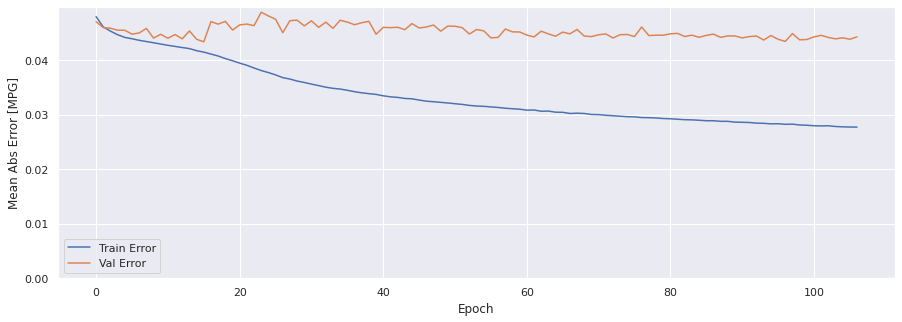

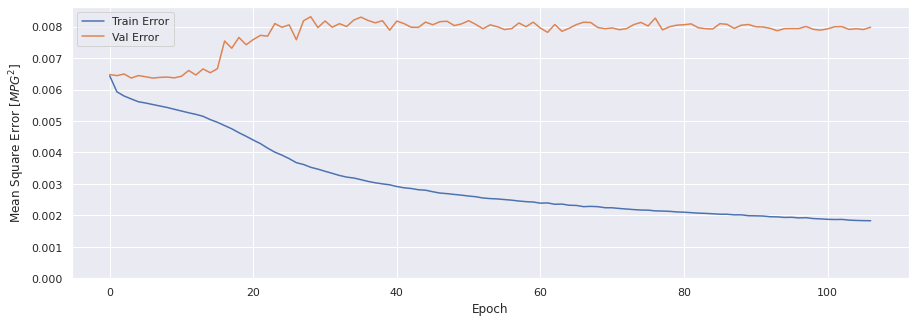

In [50]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_history(history2)

### Evaluar predicciones

In [51]:
score_train2 = model2.evaluate(scaled_trainX, data_trainY, verbose=1)
print(f'Loss:{score_train2[0]}')
print(f'MAE:{score_train2[1]}')
print(f'MSE:{score_train2[2]}')
print(f'SMAPE:{score_train2[3]}')

1401/1401 [==============================] - 28s 20ms/step - loss: 0.0018 - mae: 0.0278 - mse: 0.0018 - smape: 0.6789
Loss:0.0018281685188412666
MAE:0.02777663990855217
MSE:0.0018281685188412666
SMAPE:0.678928017616272


In [52]:
score_val2 = model2.evaluate(scaled_valX, data_valY, verbose=1)
print(f'Loss:{score_val2[0]}')
print(f'MAE:{score_val2[1]}')
print(f'MSE:{score_val2[2]}')
print(f'SMAPE:{score_val2[3]}')

291/291 [==============================] - 7s 24ms/step - loss: 0.0080 - mae: 0.0443 - mse: 0.0080 - smape: 0.7649
Loss:0.007981045171618462
MAE:0.04429306089878082
MSE:0.007981045171618462
SMAPE:0.7648848295211792


In [53]:
score_test2 = model2.evaluate(scaled_testX, data_testY, verbose=1)
print(f'Loss:{score_test2[0]}')
print(f'MAE:{score_test2[1]}')
print(f'MSE:{score_test2[2]}')
print(f'SMAPE:{score_test2[3]}')

291/291 [==============================] - 7s 24ms/step - loss: 0.0075 - mae: 0.0465 - mse: 0.0075 - smape: 0.7820
Loss:0.007535635028034449
MAE:0.04645724222064018
MSE:0.007535635028034449
SMAPE:0.7820347547531128


### Comparativa de resultados

In [54]:
result = hist2.iloc[-1]
comparativa2 = pd.DataFrame(np.array([[result['mae'], result['mse'], result['smape'], math.sqrt(result['mse'])], 
                                      [result['val_mae'], result['val_mse'], result['val_smape'], math.sqrt(result['val_mse'])],
                                      [score_test2[1], score_test2[2], score_test2[3], math.sqrt(score_test2[2])]]),
                            columns = ['MAE', 'MSE', 'SMAPE', 'RMSE'],
                            index = ['ENTRENAMIENTO', 'VALIDACION', 'TEST'])

comparativa2.style.set_caption("Método de ventana de varios pasos - LSTM de dos capas")

,MAE,MSE,SMAPE,RMSE
ENTRENAMIENTO,0.027737,0.001830,0.683130,0.042780
VALIDACION,0.044293,0.007981,0.765565,0.089337
TEST,0.046457,0.007536,0.782035,0.086808


### Obtener predicciones

In [55]:
trainPredict2 = model2.predict(scaled_trainX)
testPredict2 = model2.predict(scaled_testX)

### Visualización de las predicciones

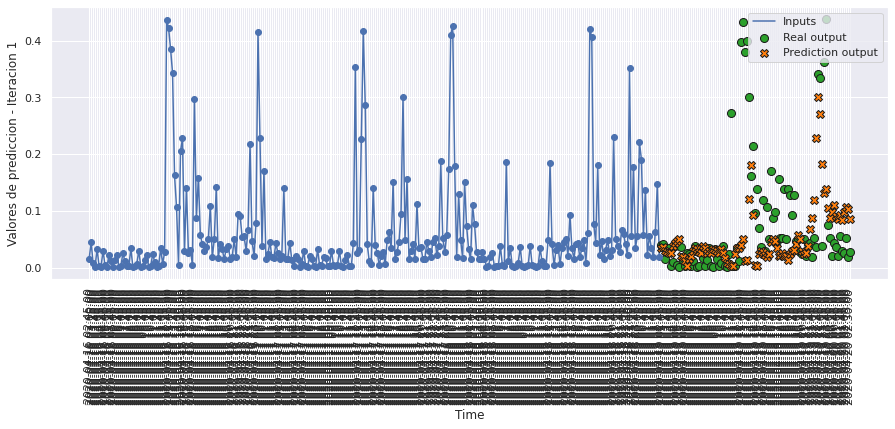

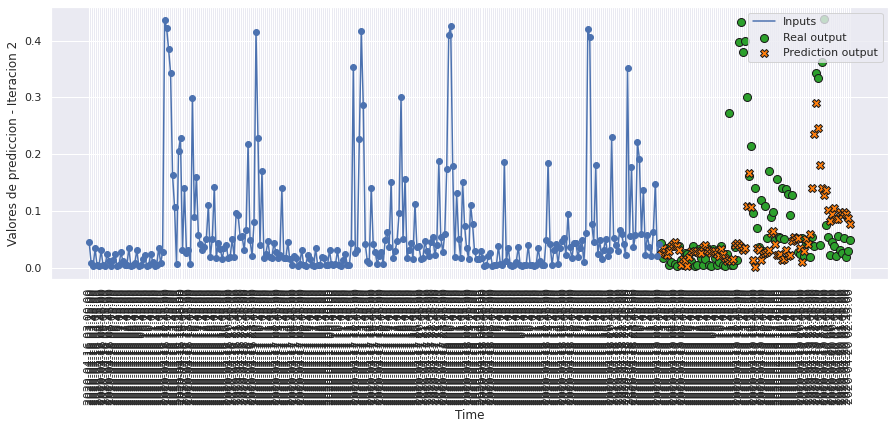

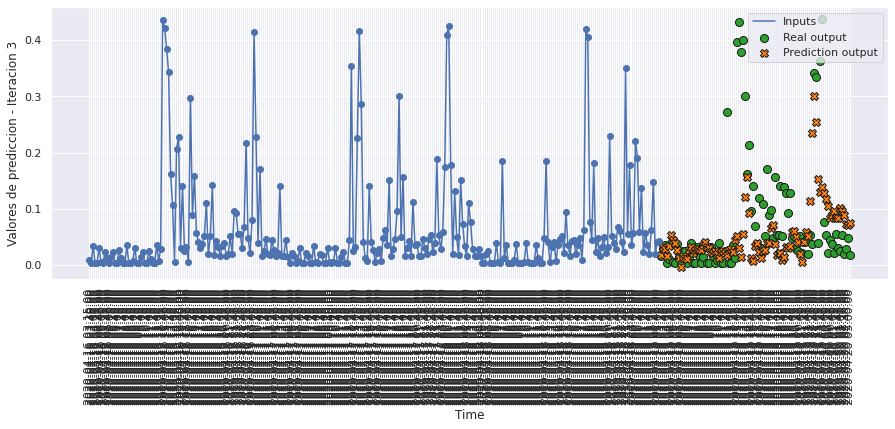

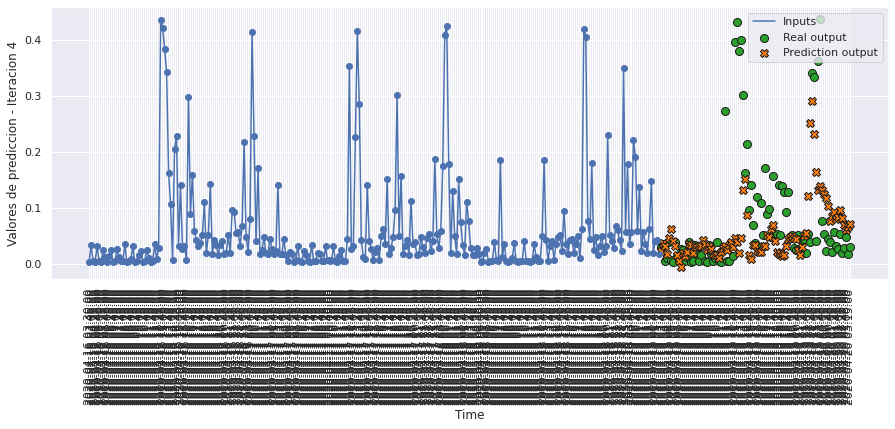

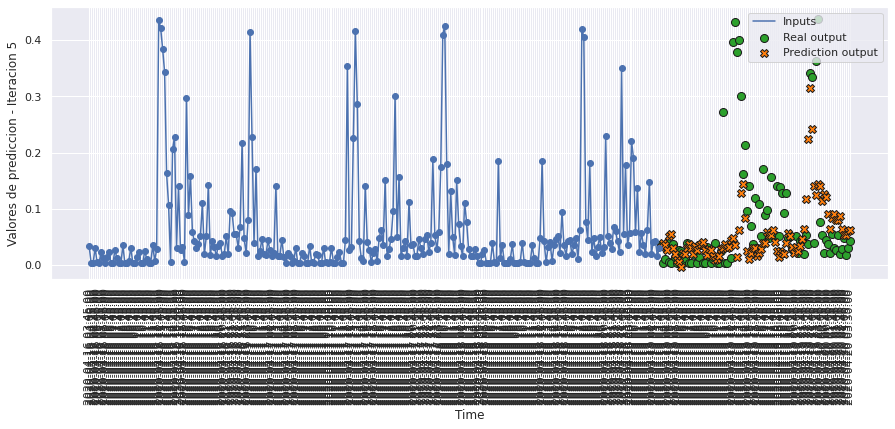

...

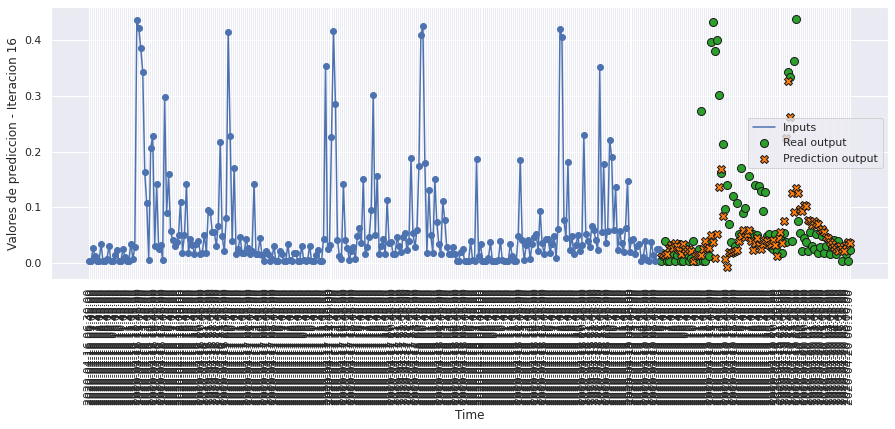

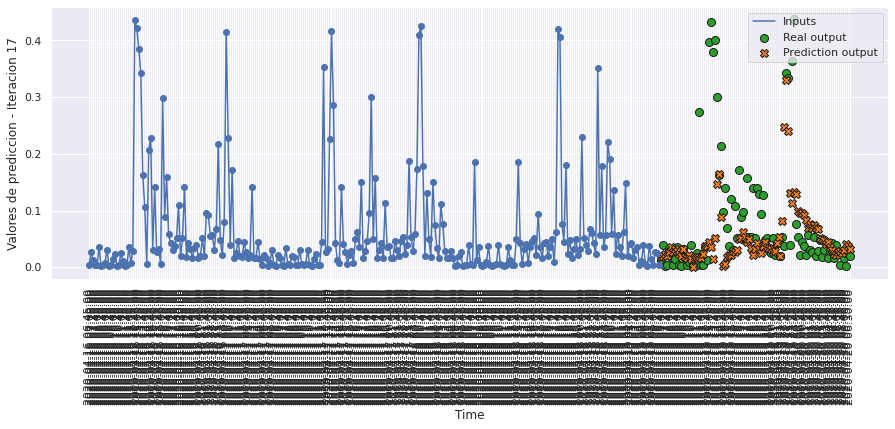

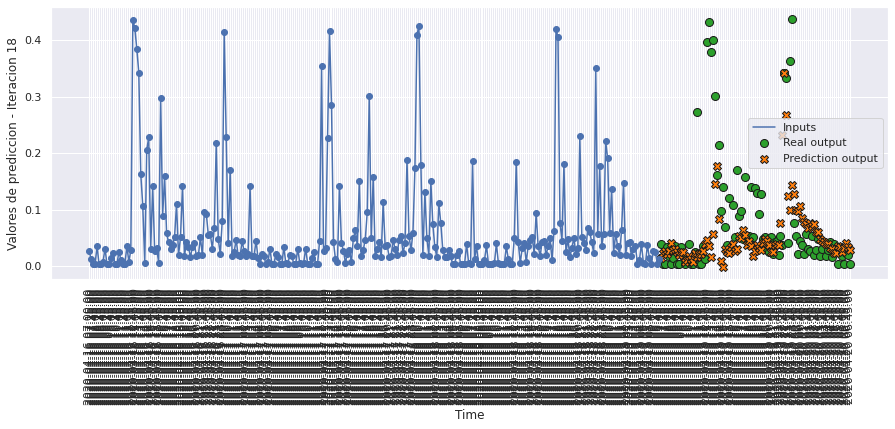

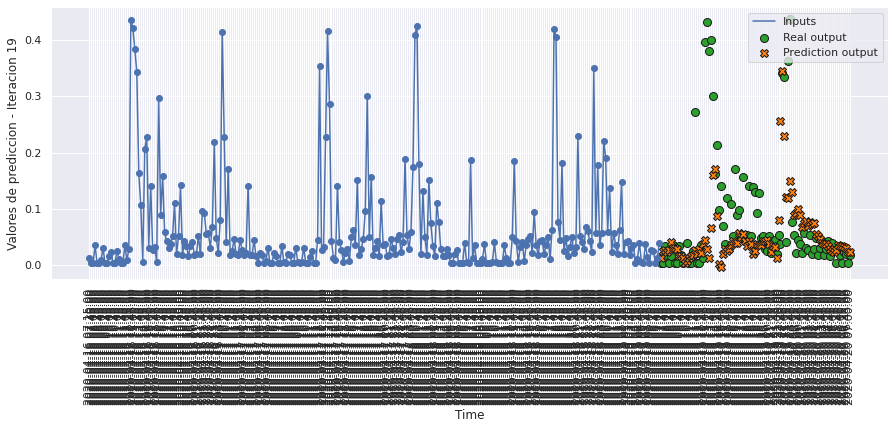

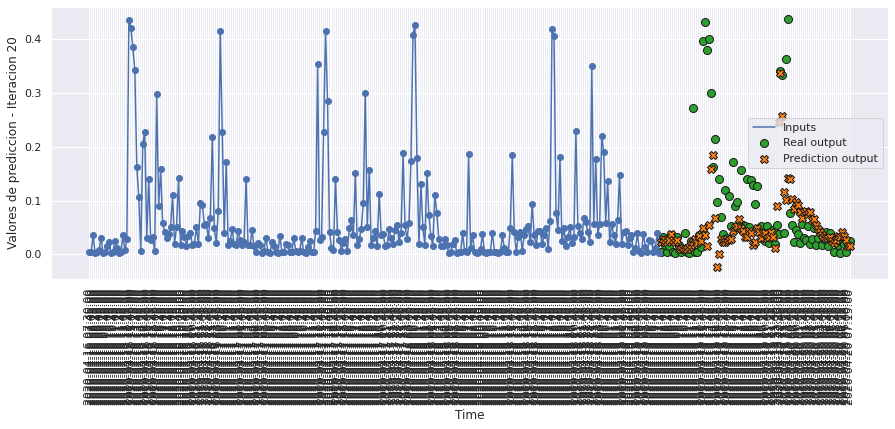

In [56]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_window_predictions(int(test_df.iloc[0].name), int(test_df.iloc[-1].name), data_testY, testPredict2, 20, 0)

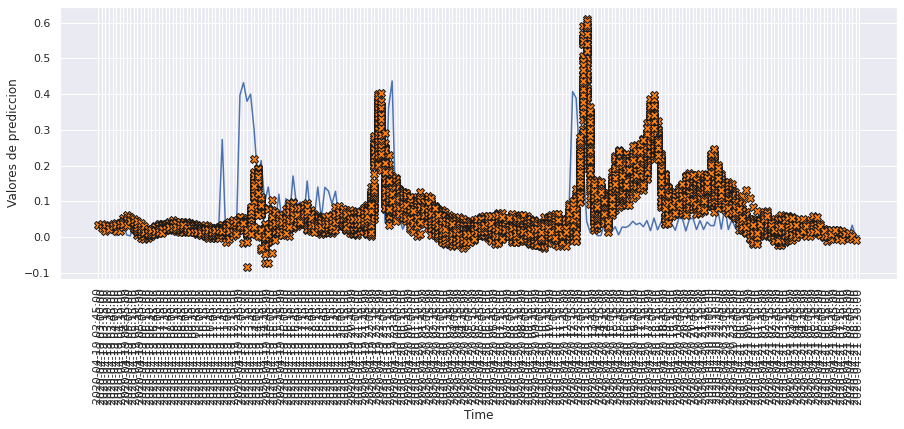

In [57]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict2, 120)

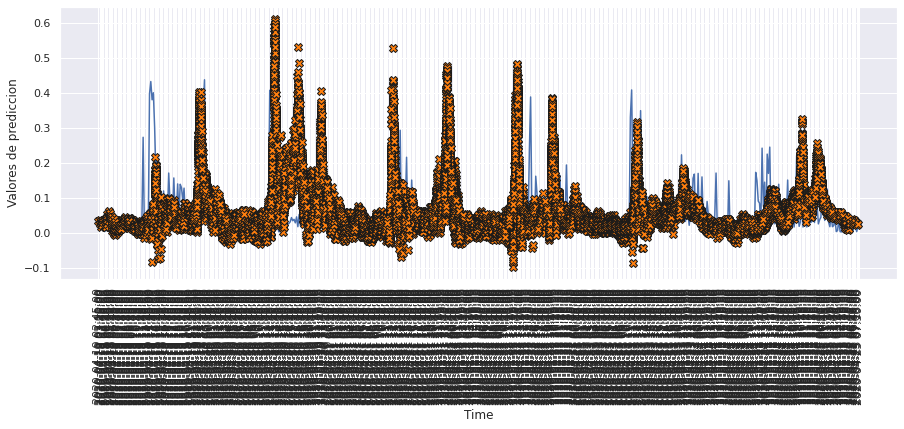

In [58]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict2, 500)

# MODELO 3: LSTM DE 3 CAPAS

### Construimos el modelo

In [59]:
def build_model3():
    model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(n_entrada, n_features)),
        tf.keras.layers.LSTM(128, activation='tanh', return_sequences=True),
        tf.keras.layers.LSTM(128, activation='tanh', return_sequences=True),
        tf.keras.layers.LSTM(64, activation='tanh'),
        tf.keras.layers.Dense(n_predicciones)
    ])

    optimizer = tf.keras.optimizers.Adam()

    model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', smape])

    return model

In [60]:
model3 = build_model3()
model3.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_3 (LSTM)               (None, 288, 128)          66560     
                                                                 
 lstm_4 (LSTM)               (None, 288, 128)          131584    
                                                                 
 lstm_5 (LSTM)               (None, 64)                49408     
                                                                 
 dense_2 (Dense)             (None, 96)                6240      
                                                                 
Total params: 253,792
Trainable params: 253,792
Non-trainable params: 0
_________________________________________________________________


### Entrenamiento del modelo

In [61]:
history3 = model3.fit(scaled_trainX, data_trainY, epochs=n_epochs, batch_size = batch_size, 
                    validation_data=(scaled_valX, data_valY), verbose = 1, callbacks=[early_stop])

Epoch 1/200
351/351 [==============================] - 34s 90ms/step - loss: 0.0064 - mae: 0.0479 - mse: 0.0064 - smape: 0.8552 - val_loss: 0.0065 - val_mae: 0.0476 - val_mse: 0.0065 - val_smape: 0.8344
Epoch 2/200
351/351 [==============================] - 31s 90ms/step - loss: 0.0059 - mae: 0.0460 - mse: 0.0059 - smape: 0.8180 - val_loss: 0.0064 - val_mae: 0.0467 - val_mse: 0.0064 - val_smape: 0.8105
Epoch 3/200
351/351 [==============================] - 32s 91ms/step - loss: 0.0058 - mae: 0.0452 - mse: 0.0058 - smape: 0.7997 - val_loss: 0.0064 - val_mae: 0.0462 - val_mse: 0.0064 - val_smape: 0.7975
Epoch 4/200
351/351 [==============================] - 32s 90ms/step - loss: 0.0057 - mae: 0.0445 - mse: 0.0057 - smape: 0.7856 - val_loss: 0.0064 - val_mae: 0.0451 - val_mse: 0.0064 - val_smape: 0.7812
Epoch 5/200
351/351 [==============================] - 32s 90ms/step - loss: 0.0056 - mae: 0.0440 - mse: 0.0056 - smape: 0.7788 - val_loss: 0.0065 - val_mae: 0.0458 - val_mse: 0.0065 - val

351/351 [==============================] - 31s 89ms/step - loss: 0.0021 - mae: 0.0290 - mse: 0.0021 - smape: 0.6881 - val_loss: 0.0078 - val_mae: 0.0450 - val_mse: 0.0078 - val_smape: 0.7740
Epoch 82/200
351/351 [==============================] - 31s 89ms/step - loss: 0.0020 - mae: 0.0288 - mse: 0.0020 - smape: 0.6874 - val_loss: 0.0079 - val_mae: 0.0453 - val_mse: 0.0079 - val_smape: 0.7745
Epoch 83/200
351/351 [==============================] - 31s 89ms/step - loss: 0.0021 - mae: 0.0291 - mse: 0.0021 - smape: 0.6902 - val_loss: 0.0080 - val_mae: 0.0457 - val_mse: 0.0080 - val_smape: 0.7769
Epoch 84/200
351/351 [==============================] - 31s 88ms/step - loss: 0.0020 - mae: 0.0287 - mse: 0.0020 - smape: 0.6872 - val_loss: 0.0077 - val_mae: 0.0443 - val_mse: 0.0077 - val_smape: 0.7701
Epoch 85/200
351/351 [==============================] - 32s 90ms/step - loss: 0.0020 - mae: 0.0287 - mse: 0.0020 - smape: 0.6871 - val_loss: 0.0078 - val_mae: 0.0444 - val_mse: 0.0078 - val_smape: 

In [62]:
hist3 = pd.DataFrame(history3.history)
hist3['epoch'] = history3.epoch
hist3

,loss,mae,mse,smape,val_loss,val_mae,val_mse,val_smape,epoch
0,0.006442,0.047933,0.006442,0.855230,0.006495,0.047583,0.006495,0.834416,0
1,0.005901,0.045964,0.005901,0.818044,0.006414,0.046694,0.006414,0.810520,1
2,0.005773,0.045176,0.005773,0.799729,0.006404,0.046175,0.006404,0.797460,2
3,0.005680,0.044494,0.005680,0.785609,0.006449,0.045102,0.006449,0.781156,3
4,0.005602,0.044017,0.005602,0.778814,0.006509,0.045833,0.006509,0.784149,4
...,...,...,...,...,...,...,...,...,...
98,0.001836,0.027821,0.001836,0.683320,0.007865,0.044979,0.007865,0.773676,98
99,0.001853,0.027928,0.001853,0.684361,0.008012,0.045222,0.008012,0.778027,99
100,0.001809,0.027678,0.001809,0.682627,0.007975,0.045002,0.007975,0.779305,100
101,0.001802,0.027629,0.001802,0.682306,0.008020,0.045516,0.008020,0.778563,101


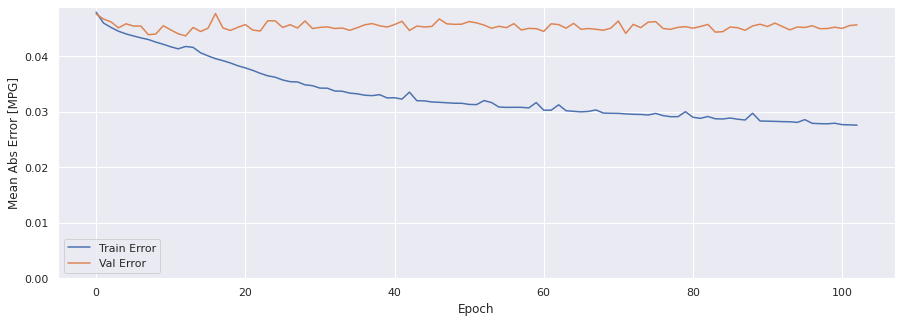

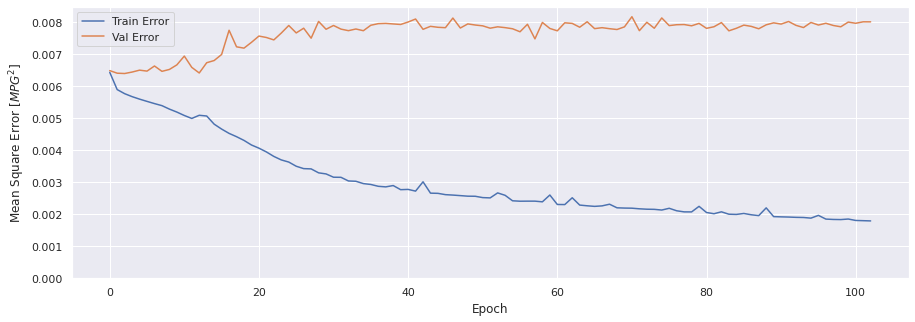

In [63]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_history(history3)

### Evaluar predicciones

In [64]:
score_train3 = model3.evaluate(scaled_trainX, data_trainY, verbose=1)
print(f'Loss:{score_train3[0]}')
print(f'MAE:{score_train3[1]}')
print(f'MSE:{score_train3[2]}')
print(f'SMAPE:{score_train3[3]}')

1401/1401 [==============================] - 45s 31ms/step - loss: 0.0018 - mae: 0.0275 - mse: 0.0018 - smape: 0.6805
Loss:0.0017710705287754536
MAE:0.027498867362737656
MSE:0.0017710705287754536
SMAPE:0.6805329322814941


In [65]:
score_val3 = model3.evaluate(scaled_valX, data_valY, verbose=1)
print(f'Loss:{score_val3[0]}')
print(f'MAE:{score_val3[1]}')
print(f'MSE:{score_val3[2]}')
print(f'SMAPE:{score_val3[3]}')

291/291 [==============================] - 10s 34ms/step - loss: 0.0080 - mae: 0.0456 - mse: 0.0080 - smape: 0.7819
Loss:0.00801931880414486
MAE:0.045645102858543396
MSE:0.00801931880414486
SMAPE:0.781880795955658


In [66]:
score_test3 = model3.evaluate(scaled_testX, data_testY, verbose=1)
print(f'Loss:{score_test3[0]}')
print(f'MAE:{score_test3[1]}')
print(f'MSE:{score_test3[2]}')
print(f'SMAPE:{score_test3[3]}')

291/291 [==============================] - 10s 34ms/step - loss: 0.0081 - mae: 0.0493 - mse: 0.0081 - smape: 0.8112
Loss:0.008070258423686028
MAE:0.049304522573947906
MSE:0.008070258423686028
SMAPE:0.8112369775772095


### Comparativa de resultados

In [67]:
result = hist3.iloc[-1]
comparativa3 = pd.DataFrame(np.array([[result['mae'], result['mse'], result['smape'], math.sqrt(result['mse'])], 
                                      [result['val_mae'], result['val_mse'], result['val_smape'], math.sqrt(result['val_mse'])],
                                      [score_test3[1], score_test3[2], score_test3[3], math.sqrt(score_test3[2])]]),
                            columns = ['MAE', 'MSE', 'SMAPE', 'RMSE'],
                            index = ['ENTRENAMIENTO', 'VALIDACION', 'TEST'])

comparativa3.style.set_caption("Método de ventana de varios pasos - LSTM de tres capas")

,MAE,MSE,SMAPE,RMSE
ENTRENAMIENTO,0.027585,0.001794,0.682220,0.042360
VALIDACION,0.045645,0.008019,0.782600,0.089551
TEST,0.049305,0.008070,0.811237,0.089835


### Obtener predicciones

In [68]:
trainPredict3 = model3.predict(scaled_trainX)
testPredict3 = model3.predict(scaled_testX)

### Visualización de las predicciones

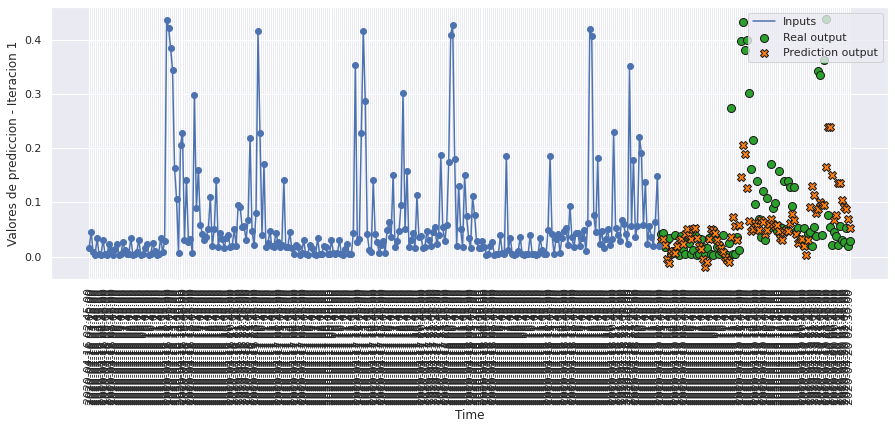

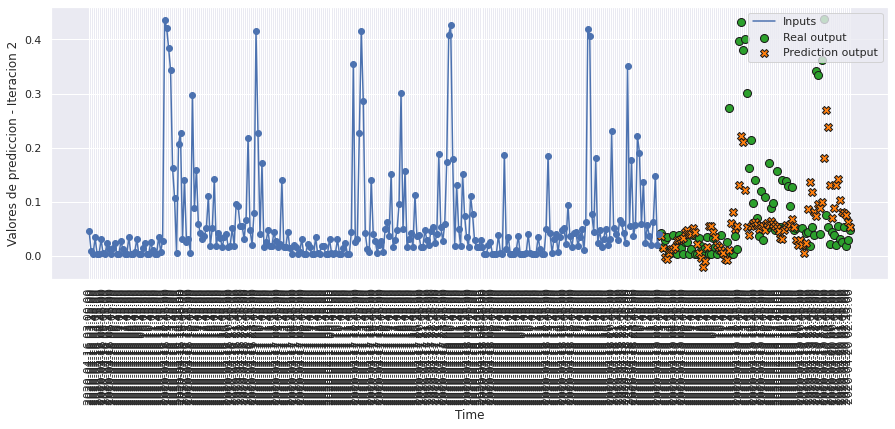

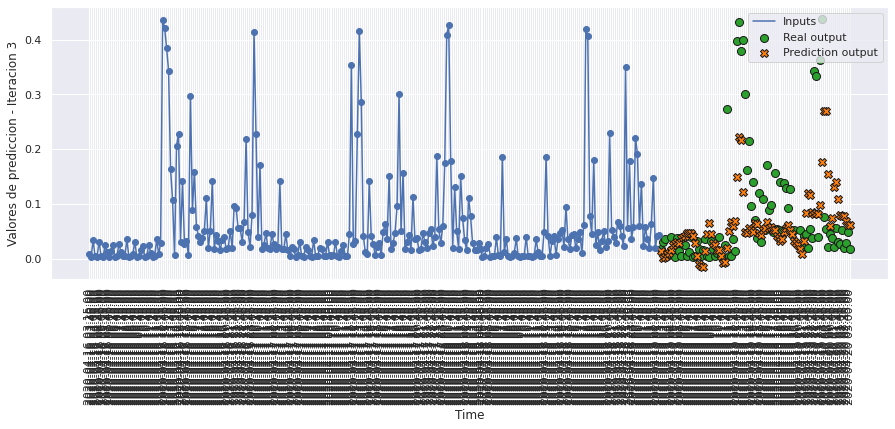

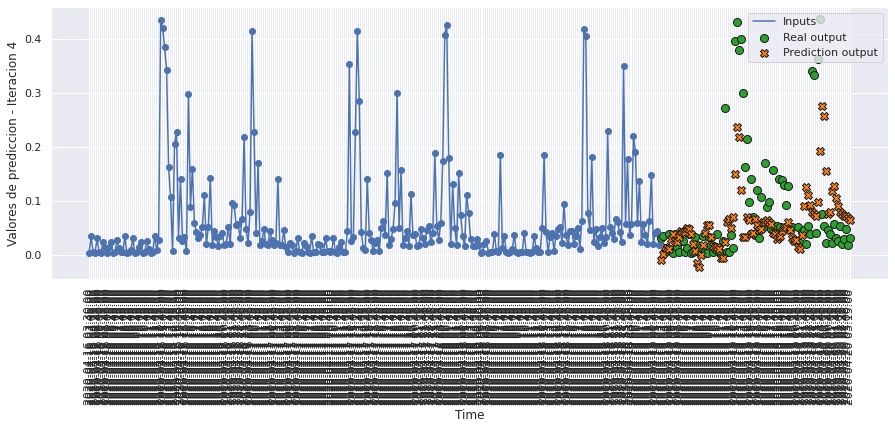

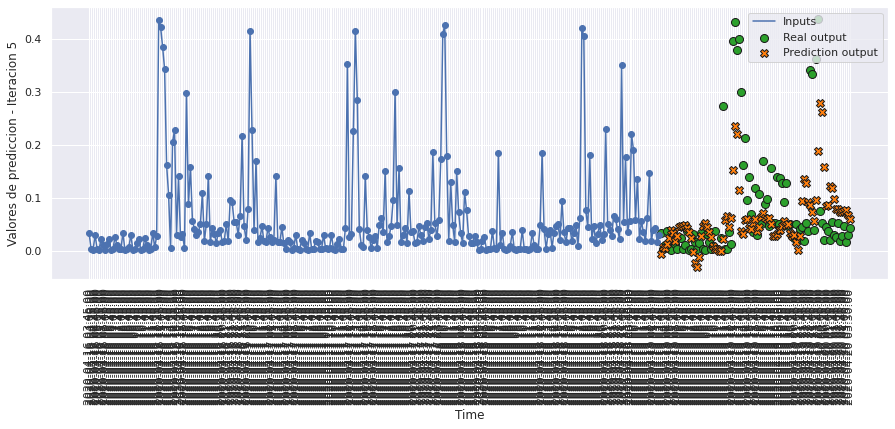

...

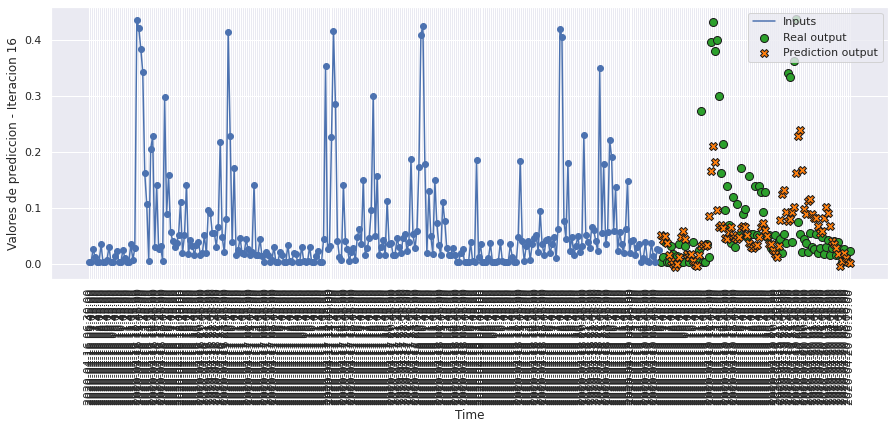

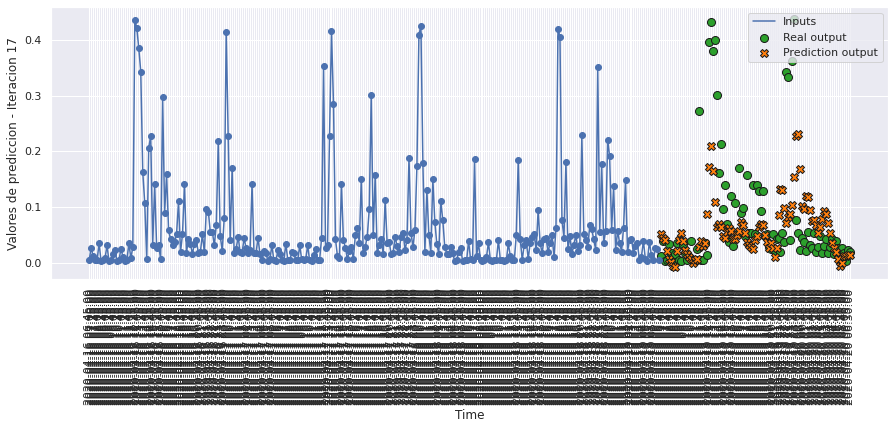

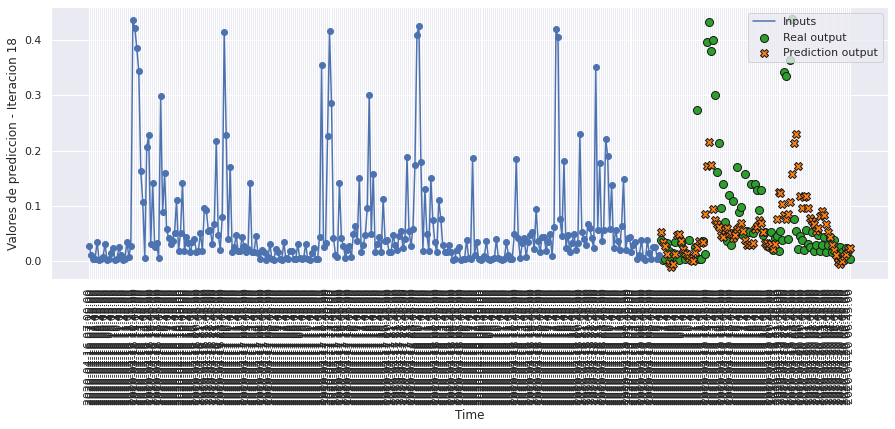

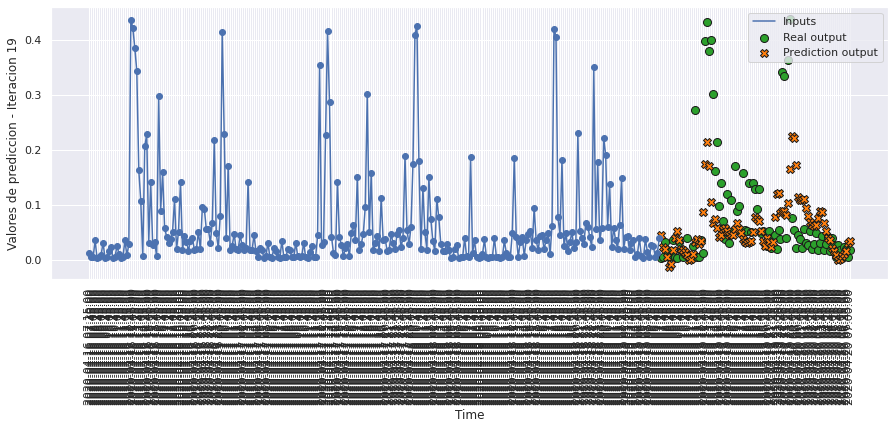

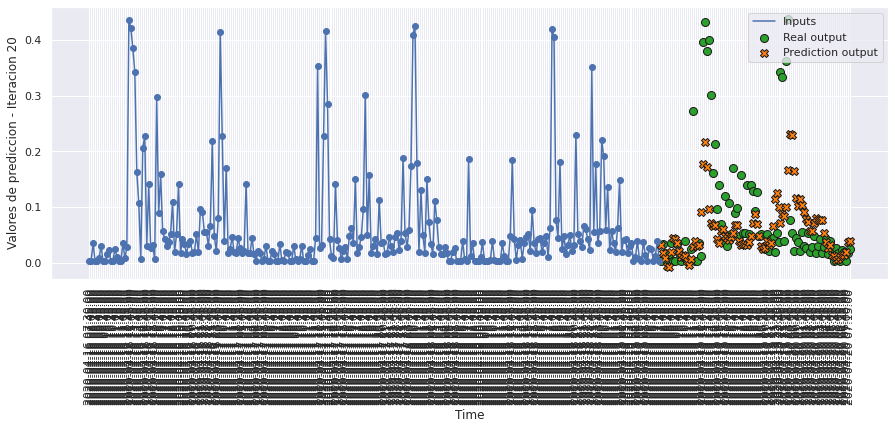

In [69]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_window_predictions(int(test_df.iloc[0].name), int(test_df.iloc[-1].name), data_testY, testPredict3, 20, 0)

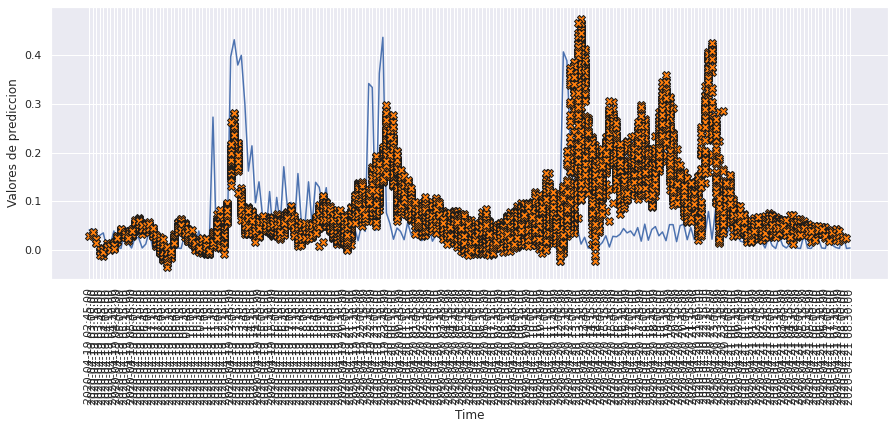

In [70]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict3, 120)

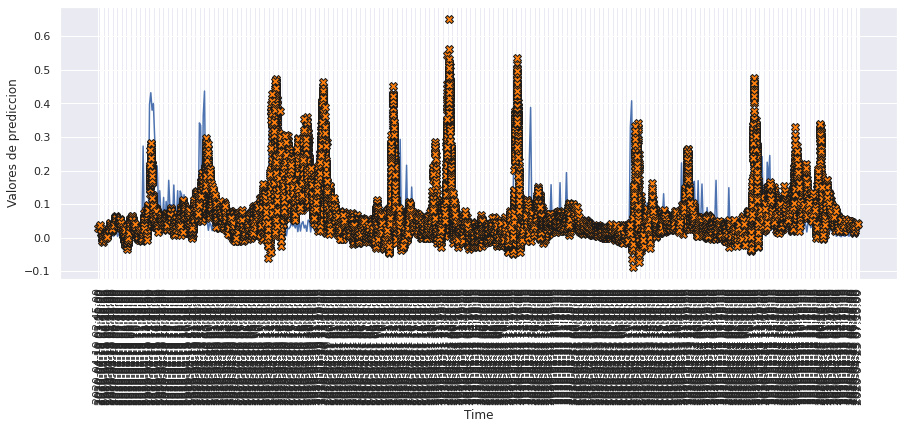

In [71]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict3, 500)

# MODELO 4: LSTM BIDIRECCIONAL

### Construimos el modelo

In [72]:
def build_model4():
    model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(n_entrada, n_features)),
        tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(128, activation='tanh')),
        tf.keras.layers.Dense(n_predicciones)
    ])

    optimizer = tf.keras.optimizers.Adam()

    model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', smape])

    return model

In [73]:
model4 = build_model4()
model4.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 bidirectional (Bidirectiona  (None, 256)              133120    
 l)                                                              
                                                                 
 dense_3 (Dense)             (None, 96)                24672     
                                                                 
Total params: 157,792
Trainable params: 157,792
Non-trainable params: 0
_________________________________________________________________


### Entrenamiento del modelo

In [74]:
history4 = model4.fit(scaled_trainX, data_trainY, epochs=n_epochs, batch_size = batch_size, 
                    validation_data=(scaled_valX, data_valY), verbose = 1, callbacks=[early_stop])

Epoch 1/200
351/351 [==============================] - 24s 62ms/step - loss: 0.0064 - mae: 0.0476 - mse: 0.0064 - smape: 0.8484 - val_loss: 0.0065 - val_mae: 0.0456 - val_mse: 0.0065 - val_smape: 0.8045
Epoch 2/200
351/351 [==============================] - 22s 62ms/step - loss: 0.0060 - mae: 0.0462 - mse: 0.0060 - smape: 0.8240 - val_loss: 0.0065 - val_mae: 0.0467 - val_mse: 0.0065 - val_smape: 0.8203
Epoch 3/200
351/351 [==============================] - 22s 62ms/step - loss: 0.0058 - mae: 0.0456 - mse: 0.0058 - smape: 0.8140 - val_loss: 0.0064 - val_mae: 0.0453 - val_mse: 0.0064 - val_smape: 0.7996
Epoch 4/200
351/351 [==============================] - 22s 61ms/step - loss: 0.0057 - mae: 0.0452 - mse: 0.0057 - smape: 0.8034 - val_loss: 0.0064 - val_mae: 0.0464 - val_mse: 0.0064 - val_smape: 0.8106
Epoch 5/200
351/351 [==============================] - 22s 62ms/step - loss: 0.0057 - mae: 0.0450 - mse: 0.0057 - smape: 0.8010 - val_loss: 0.0066 - val_mae: 0.0466 - val_mse: 0.0066 - val

351/351 [==============================] - 21s 61ms/step - loss: 0.0029 - mae: 0.0337 - mse: 0.0029 - smape: 0.7419 - val_loss: 0.0077 - val_mae: 0.0466 - val_mse: 0.0077 - val_smape: 0.8278
Epoch 82/200
351/351 [==============================] - 21s 61ms/step - loss: 0.0029 - mae: 0.0337 - mse: 0.0029 - smape: 0.7414 - val_loss: 0.0076 - val_mae: 0.0461 - val_mse: 0.0076 - val_smape: 0.8211
Epoch 83/200
351/351 [==============================] - 22s 62ms/step - loss: 0.0029 - mae: 0.0336 - mse: 0.0029 - smape: 0.7407 - val_loss: 0.0075 - val_mae: 0.0460 - val_mse: 0.0075 - val_smape: 0.8161
Epoch 84/200
351/351 [==============================] - 21s 61ms/step - loss: 0.0029 - mae: 0.0337 - mse: 0.0029 - smape: 0.7415 - val_loss: 0.0077 - val_mae: 0.0467 - val_mse: 0.0077 - val_smape: 0.8353
Epoch 85/200
351/351 [==============================] - 21s 61ms/step - loss: 0.0029 - mae: 0.0335 - mse: 0.0029 - smape: 0.7404 - val_loss: 0.0077 - val_mae: 0.0460 - val_mse: 0.0077 - val_smape: 

In [75]:
hist4 = pd.DataFrame(history4.history)
hist4['epoch'] = history4.epoch
hist4

,loss,mae,mse,smape,val_loss,val_mae,val_mse,val_smape,epoch
0,0.006353,0.047610,0.006353,0.848388,0.006480,0.045618,0.006480,0.804469,0
1,0.005971,0.046232,0.005971,0.823958,0.006468,0.046665,0.006468,0.820342,1
2,0.005825,0.045623,0.005825,0.814015,0.006439,0.045319,0.006439,0.799578,2
3,0.005742,0.045160,0.005742,0.803414,0.006391,0.046419,0.006391,0.810635,3
4,0.005693,0.044972,0.005693,0.801030,0.006591,0.046573,0.006591,0.820938,4
...,...,...,...,...,...,...,...,...,...
99,0.002670,0.032627,0.002670,0.734738,0.007517,0.045416,0.007517,0.817989,99
100,0.002637,0.032475,0.002637,0.733762,0.007575,0.045939,0.007575,0.819872,100
101,0.002646,0.032518,0.002646,0.734083,0.007675,0.046250,0.007675,0.829675,101
102,0.002629,0.032448,0.002629,0.733715,0.007600,0.045407,0.007600,0.827086,102


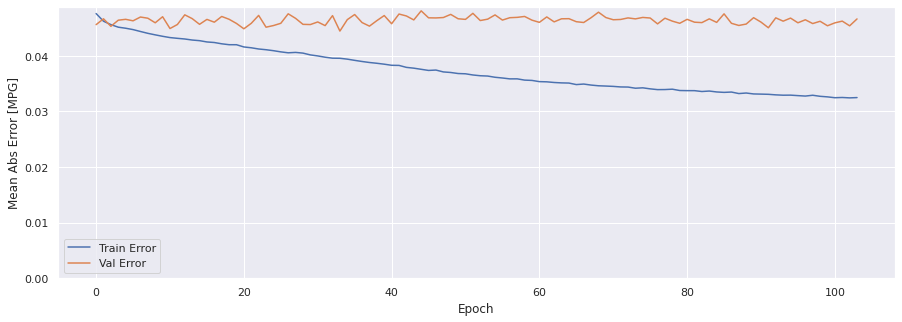

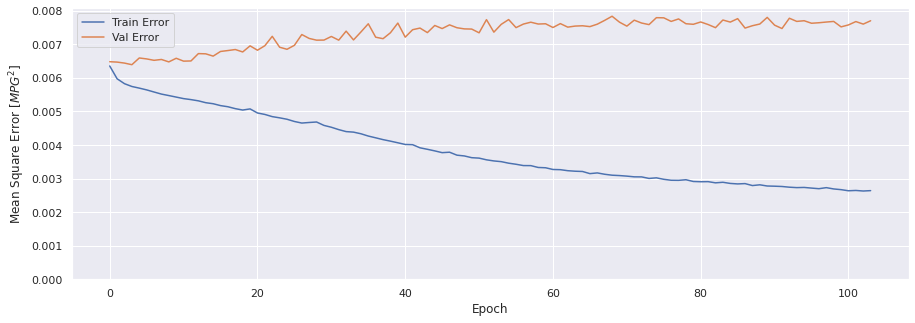

In [76]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_history(history4)

### Evaluar predicciones

In [77]:
score_train4 = model4.evaluate(scaled_trainX, data_trainY, verbose=1)
print(f'Loss:{score_train4[0]}')
print(f'MAE:{score_train4[1]}')
print(f'MSE:{score_train4[2]}')
print(f'SMAPE:{score_train4[3]}')

1401/1401 [==============================] - 35s 25ms/step - loss: 0.0026 - mae: 0.0324 - mse: 0.0026 - smape: 0.7310
Loss:0.0025942802894860506
MAE:0.0324346162378788
MSE:0.0025942802894860506
SMAPE:0.731026291847229


In [78]:
score_val4 = model4.evaluate(scaled_valX, data_valY, verbose=1)
print(f'Loss:{score_val4[0]}')
print(f'MAE:{score_val4[1]}')
print(f'MSE:{score_val4[2]}')
print(f'SMAPE:{score_val4[3]}')

291/291 [==============================] - 7s 24ms/step - loss: 0.0077 - mae: 0.0466 - mse: 0.0077 - smape: 0.8270
Loss:0.007699303794652224
MAE:0.04664457589387894
MSE:0.007699303794652224
SMAPE:0.8269867897033691


In [79]:
score_test4 = model4.evaluate(scaled_testX, data_testY, verbose=1)
print(f'Loss:{score_test4[0]}')
print(f'MAE:{score_test4[1]}')
print(f'MSE:{score_test4[2]}')
print(f'SMAPE:{score_test4[3]}')

291/291 [==============================] - 7s 25ms/step - loss: 0.0073 - mae: 0.0481 - mse: 0.0073 - smape: 0.8229
Loss:0.00733463978394866
MAE:0.04812893643975258
MSE:0.00733463978394866
SMAPE:0.8229395747184753


### Comparativa de resultados

In [80]:
result = hist4.iloc[-1]
comparativa4 = pd.DataFrame(np.array([[result['mae'], result['mse'], result['smape'], math.sqrt(result['mse'])], 
                                      [result['val_mae'], result['val_mse'], result['val_smape'], math.sqrt(result['val_mse'])],
                                      [score_test4[1], score_test4[2], score_test4[3], math.sqrt(score_test4[2])]]),
                            columns = ['MAE', 'MSE', 'SMAPE', 'RMSE'],
                            index = ['ENTRENAMIENTO', 'VALIDACION', 'TEST'])

comparativa4.style.set_caption("Método de ventana de varios pasos - Bidireccional LSTM")

,MAE,MSE,SMAPE,RMSE
ENTRENAMIENTO,0.032500,0.002641,0.734132,0.051386
VALIDACION,0.046645,0.007699,0.827912,0.087746
TEST,0.048129,0.007335,0.822940,0.085643


### Obtener predicciones

In [81]:
trainPredict4 = model4.predict(scaled_trainX)
testPredict4 = model4.predict(scaled_testX)

### Visualización de las predicciones

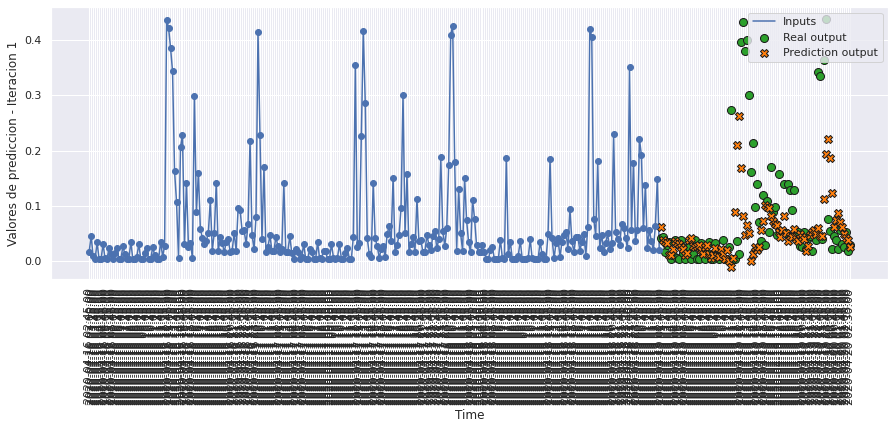

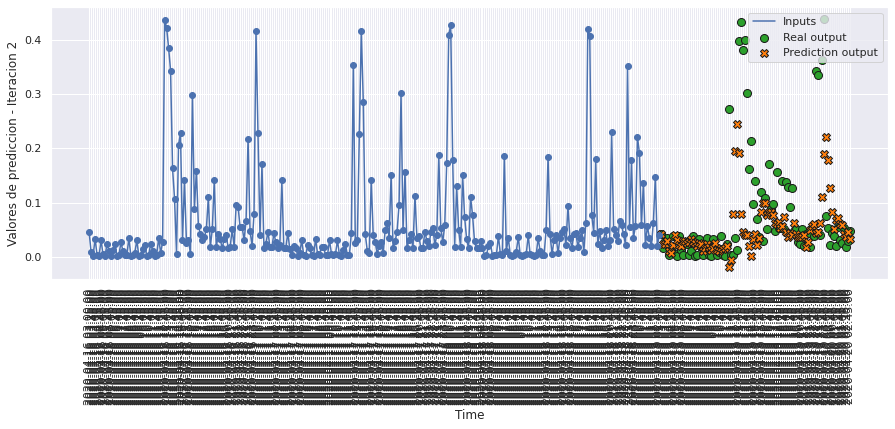

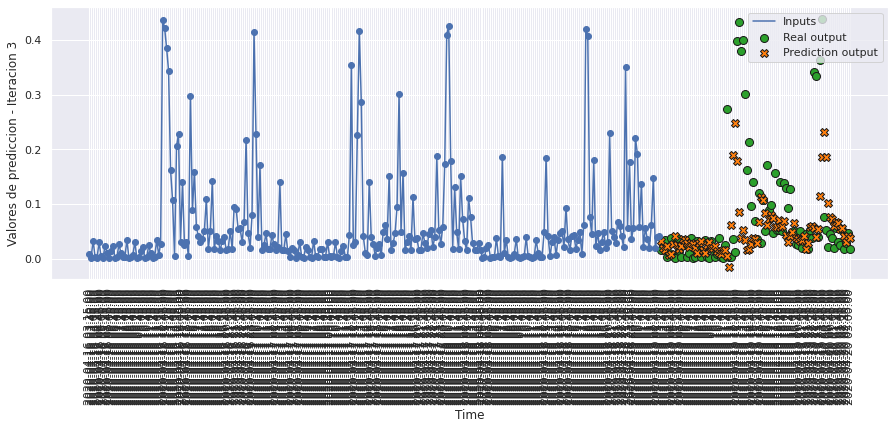

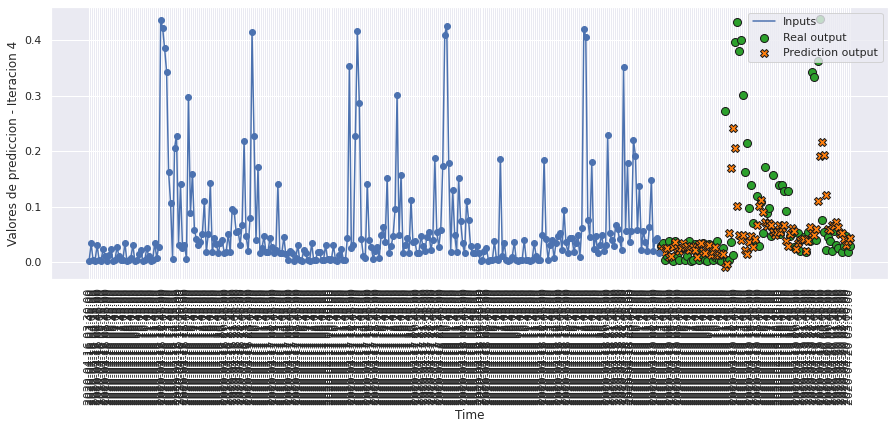

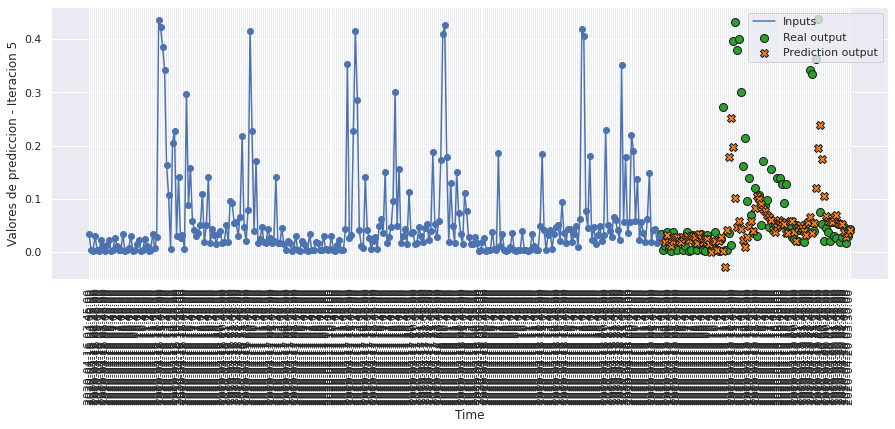

...

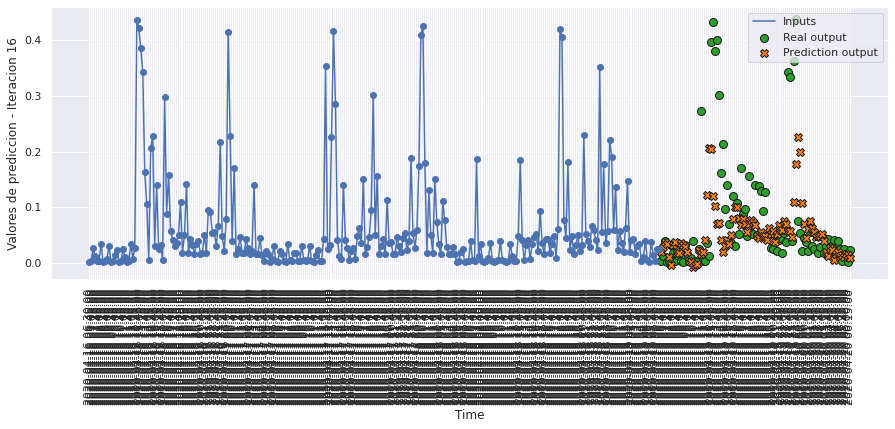

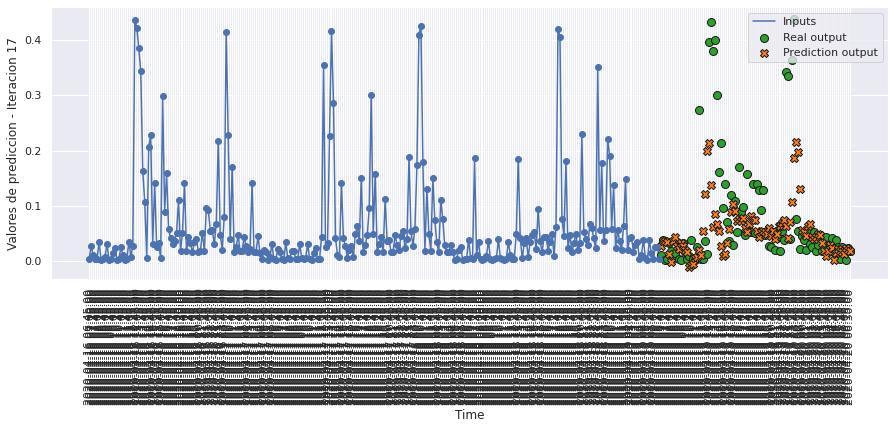

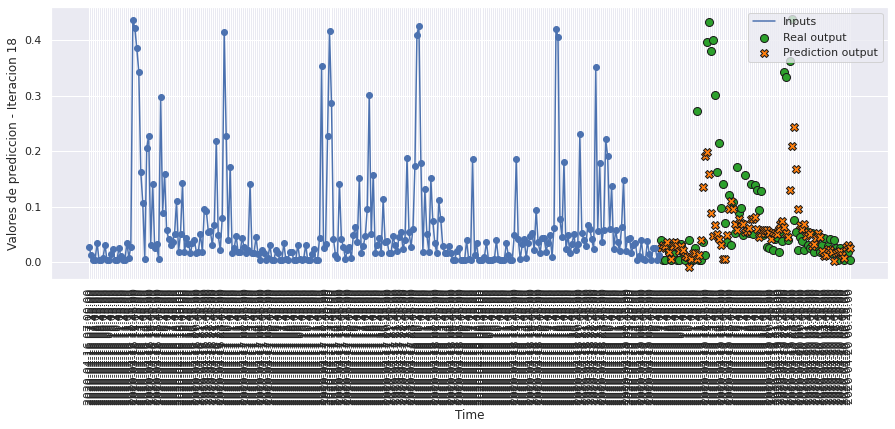

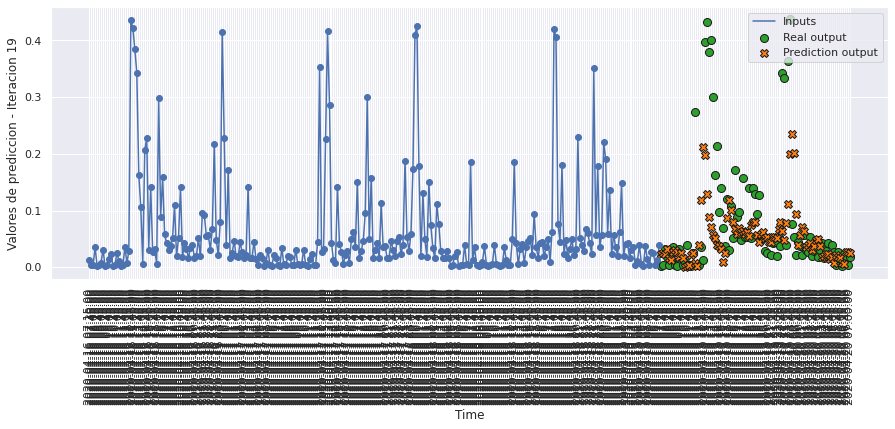

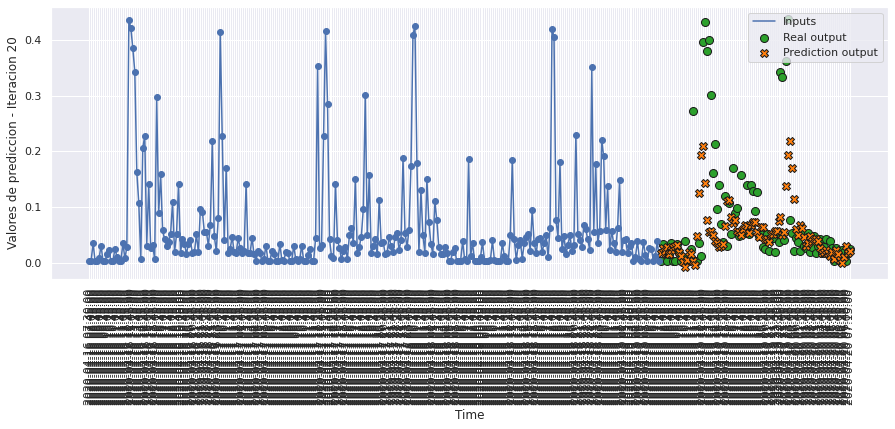

In [82]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_window_predictions(int(test_df.iloc[0].name), int(test_df.iloc[-1].name), data_testY, testPredict4, 20, 0)

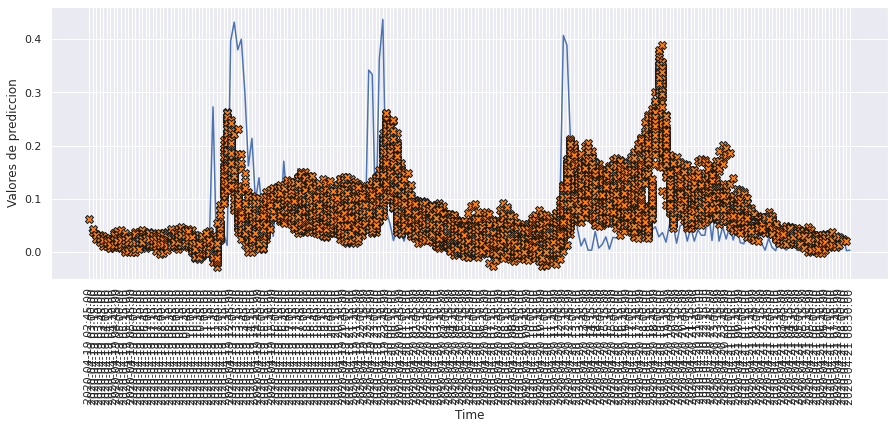

In [83]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict4, 120)

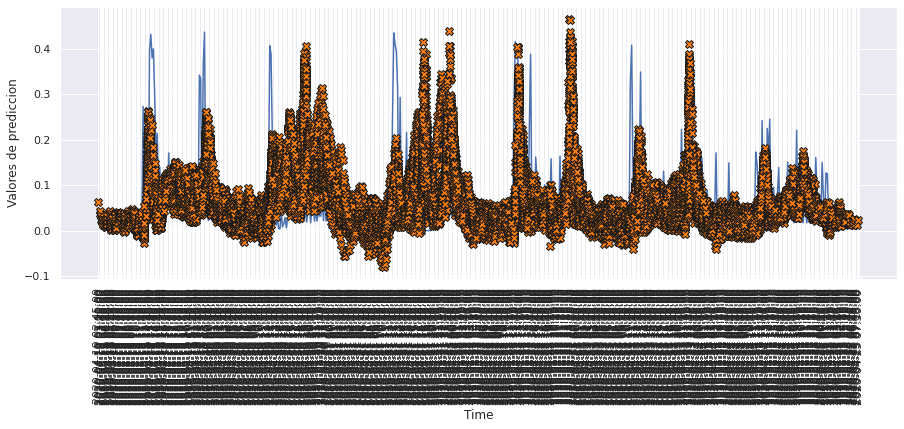

In [84]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict4, 500)

# MODELO 5: CONVOLUCIONAL 1D

### Construimos el modelo

In [85]:
def build_model5():
    model = tf.keras.Sequential([
        tf.keras.layers.TimeDistributed(tf.keras.layers.Conv1D(filters=64, kernel_size=1, activation='relu'), 
                                        input_shape=(None, n_entrada, n_features)),
        tf.keras.layers.TimeDistributed(tf.keras.layers.MaxPooling1D(pool_size=2)),
        tf.keras.layers.TimeDistributed(tf.keras.layers.Flatten()),
        tf.keras.layers.Dense(n_predicciones)
    ])

    optimizer = tf.keras.optimizers.Adam()

    model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', smape])

    return model

In [86]:
model5 = build_model5()
model5.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 time_distributed (TimeDistr  (None, None, 288, 64)    128       
 ibuted)                                                         
                                                                 
 time_distributed_1 (TimeDis  (None, None, 144, 64)    0         
 tributed)                                                       
                                                                 
 time_distributed_2 (TimeDis  (None, None, 9216)       0         
 tributed)                                                       
                                                                 
 dense_4 (Dense)             (None, None, 96)          884832    
                                                                 
Total params: 884,960
Trainable params: 884,960
Non-trainable params: 0
________________________________________________

### Entrenamiento del modelo

In [87]:
history5 = model5.fit(scaled_trainX_4D, data_trainY_3D, epochs=n_epochs, batch_size = batch_size, 
                    validation_data=(scaled_valX_4D, data_valY_3D), verbose = 1, callbacks=[early_stop])

Epoch 1/200
351/351 [==============================] - 4s 8ms/step - loss: 0.0059 - mae: 0.0455 - mse: 0.0059 - smape: 0.8083 - val_loss: 0.0064 - val_mae: 0.0435 - val_mse: 0.0064 - val_smape: 0.7685
Epoch 2/200
351/351 [==============================] - 3s 9ms/step - loss: 0.0057 - mae: 0.0444 - mse: 0.0057 - smape: 0.7867 - val_loss: 0.0064 - val_mae: 0.0434 - val_mse: 0.0064 - val_smape: 0.7686
Epoch 3/200
351/351 [==============================] - 2s 7ms/step - loss: 0.0057 - mae: 0.0442 - mse: 0.0057 - smape: 0.7845 - val_loss: 0.0064 - val_mae: 0.0446 - val_mse: 0.0064 - val_smape: 0.7815
Epoch 4/200
351/351 [==============================] - 2s 7ms/step - loss: 0.0056 - mae: 0.0442 - mse: 0.0056 - smape: 0.7846 - val_loss: 0.0064 - val_mae: 0.0441 - val_mse: 0.0064 - val_smape: 0.7772
Epoch 5/200
351/351 [==============================] - 2s 7ms/step - loss: 0.0056 - mae: 0.0441 - mse: 0.0056 - smape: 0.7848 - val_loss: 0.0064 - val_mae: 0.0442 - val_mse: 0.0064 - val_smape: 0.

Epoch 82/200
351/351 [==============================] - 3s 7ms/step - loss: 0.0054 - mae: 0.0437 - mse: 0.0054 - smape: 0.7958 - val_loss: 0.0063 - val_mae: 0.0434 - val_mse: 0.0063 - val_smape: 0.7892
Epoch 83/200
351/351 [==============================] - 2s 7ms/step - loss: 0.0054 - mae: 0.0436 - mse: 0.0054 - smape: 0.7951 - val_loss: 0.0064 - val_mae: 0.0444 - val_mse: 0.0064 - val_smape: 0.8006
Epoch 84/200
351/351 [==============================] - 2s 7ms/step - loss: 0.0054 - mae: 0.0437 - mse: 0.0054 - smape: 0.7955 - val_loss: 0.0063 - val_mae: 0.0433 - val_mse: 0.0063 - val_smape: 0.7833
Epoch 85/200
351/351 [==============================] - 2s 7ms/step - loss: 0.0054 - mae: 0.0437 - mse: 0.0054 - smape: 0.7951 - val_loss: 0.0064 - val_mae: 0.0444 - val_mse: 0.0064 - val_smape: 0.8021
Epoch 86/200
351/351 [==============================] - 2s 7ms/step - loss: 0.0054 - mae: 0.0437 - mse: 0.0054 - smape: 0.7957 - val_loss: 0.0064 - val_mae: 0.0454 - val_mse: 0.0064 - val_smap

In [88]:
hist5 = pd.DataFrame(history5.history)
hist5['epoch'] = history5.epoch
hist5

,loss,mae,mse,smape,val_loss,val_mae,val_mse,val_smape,epoch
0,0.005880,0.045465,0.005880,0.808306,0.006433,0.043463,0.006433,0.768466,0
1,0.005697,0.044408,0.005697,0.786693,0.006384,0.043385,0.006384,0.768566,1
2,0.005651,0.044229,0.005651,0.784508,0.006386,0.044580,0.006386,0.781490,2
3,0.005628,0.044177,0.005628,0.784578,0.006366,0.044068,0.006366,0.777180,3
4,0.005608,0.044122,0.005608,0.784763,0.006373,0.044204,0.006373,0.782423,4
...,...,...,...,...,...,...,...,...,...
134,0.005365,0.043635,0.005365,0.799061,0.006351,0.044111,0.006351,0.798252,134
135,0.005365,0.043625,0.005365,0.798836,0.006352,0.043858,0.006352,0.795369,135
136,0.005364,0.043621,0.005364,0.798848,0.006348,0.044080,0.006348,0.796267,136
137,0.005364,0.043632,0.005364,0.798999,0.006349,0.044485,0.006349,0.798990,137


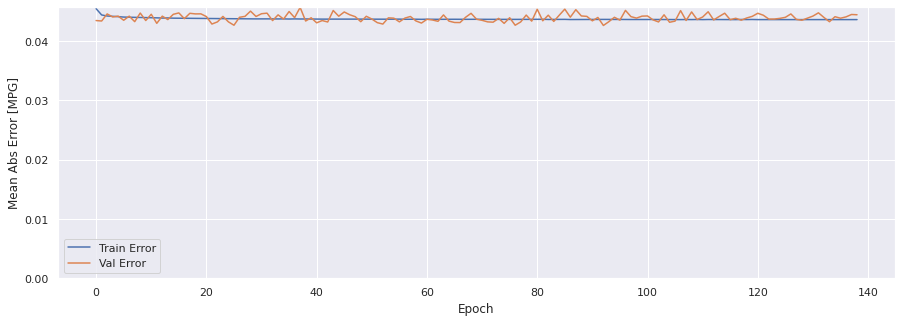

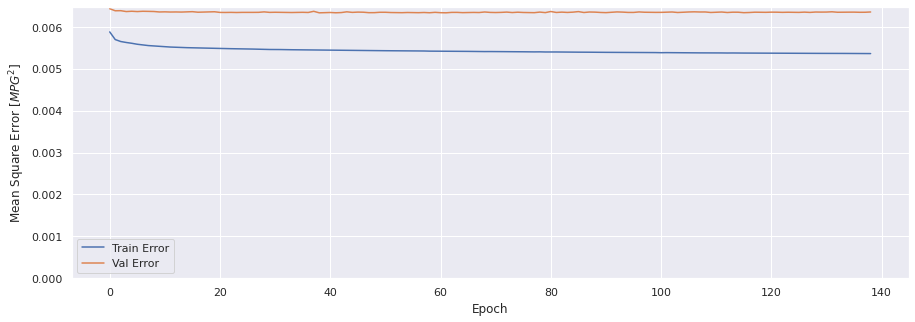

In [89]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_history(history5)

### Evaluar predicciones

In [90]:
score_train5 = model5.evaluate(scaled_trainX_4D, data_trainY_3D, verbose=1)
print(f'Loss:{score_train5[0]}')
print(f'MAE:{score_train5[1]}')
print(f'MSE:{score_train5[2]}')
print(f'SMAPE:{score_train5[3]}')

1401/1401 [==============================] - 7s 5ms/step - loss: 0.0053 - mae: 0.0439 - mse: 0.0053 - smape: 0.7985
Loss:0.005331594031304121
MAE:0.04386221244931221
MSE:0.005331594031304121
SMAPE:0.7985408306121826


In [91]:
score_val5 = model5.evaluate(scaled_valX_4D, data_valY_3D, verbose=1)
print(f'Loss:{score_val5[0]}')
print(f'MAE:{score_val5[1]}')
print(f'MSE:{score_val5[2]}')
print(f'SMAPE:{score_val5[3]}')

291/291 [==============================] - 1s 4ms/step - loss: 0.0064 - mae: 0.0444 - mse: 0.0064 - smape: 0.8002
Loss:0.006355551071465015
MAE:0.04444042965769768
MSE:0.006355551071465015
SMAPE:0.8001836538314819


In [92]:
score_test5 = model5.evaluate(scaled_testX_4D, data_testY_3D, verbose=1)
print(f'Loss:{score_test5[0]}')
print(f'MAE:{score_test5[1]}')
print(f'MSE:{score_test5[2]}')
print(f'SMAPE:{score_test5[3]}')

291/291 [==============================] - 1s 4ms/step - loss: 0.0061 - mae: 0.0467 - mse: 0.0061 - smape: 0.8127
Loss:0.006148067303001881
MAE:0.04674552008509636
MSE:0.006148067303001881
SMAPE:0.8127457499504089


### Comparativa de resultados

In [93]:
result = hist5.iloc[-1]
comparativa5 = pd.DataFrame(np.array([[result['mae'], result['mse'], result['smape'], math.sqrt(result['mse'])], 
                                      [result['val_mae'], result['val_mse'], result['val_smape'], math.sqrt(result['val_mse'])],
                                      [score_test5[1], score_test5[2], score_test5[3], math.sqrt(score_test5[2])]]),
                            columns = ['MAE', 'MSE', 'SMAPE', 'RMSE'],
                            index = ['ENTRENAMIENTO', 'VALIDACION', 'TEST'])

comparativa5.style.set_caption("Método de ventana de varios pasos - Convolucional 1D")

,MAE,MSE,SMAPE,RMSE
ENTRENAMIENTO,0.043624,0.005363,0.798959,0.073232
VALIDACION,0.044440,0.006356,0.800832,0.079722
TEST,0.046746,0.006148,0.812746,0.078410


### Obtener predicciones

In [94]:
trainPredict5 = model5.predict(scaled_trainX_4D)
testPredict5 = model5.predict(scaled_testX_4D)

### Visualización de las predicciones

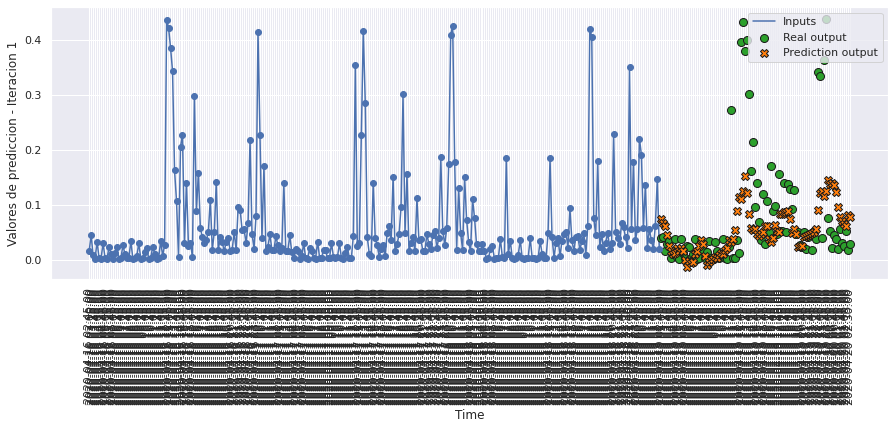

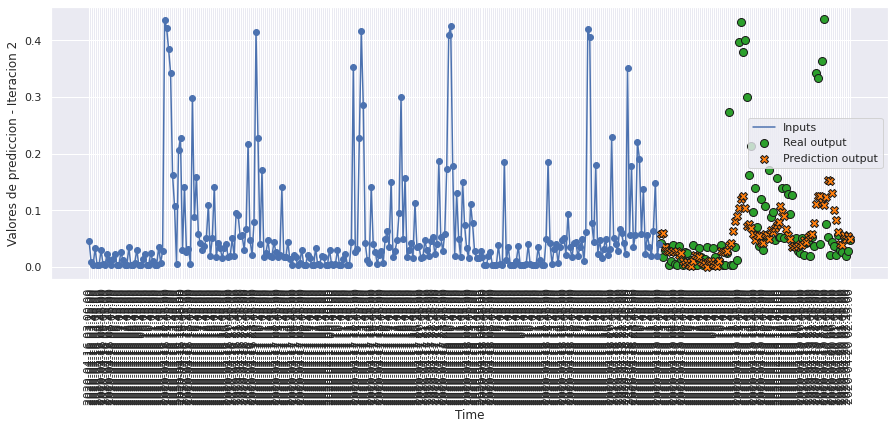

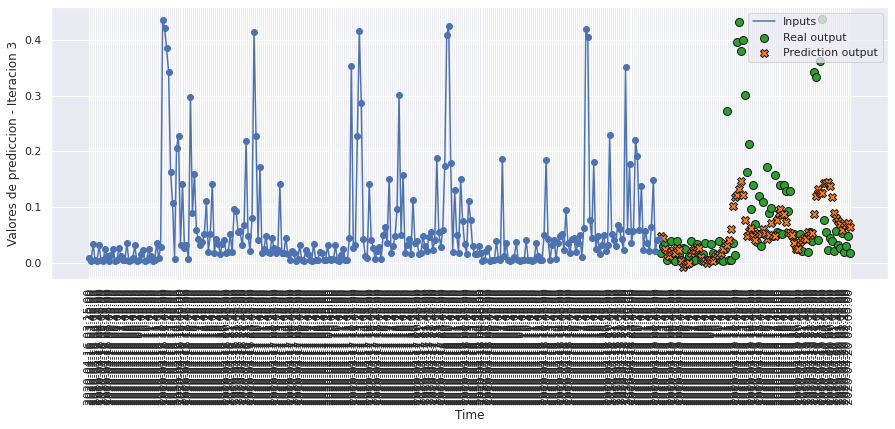

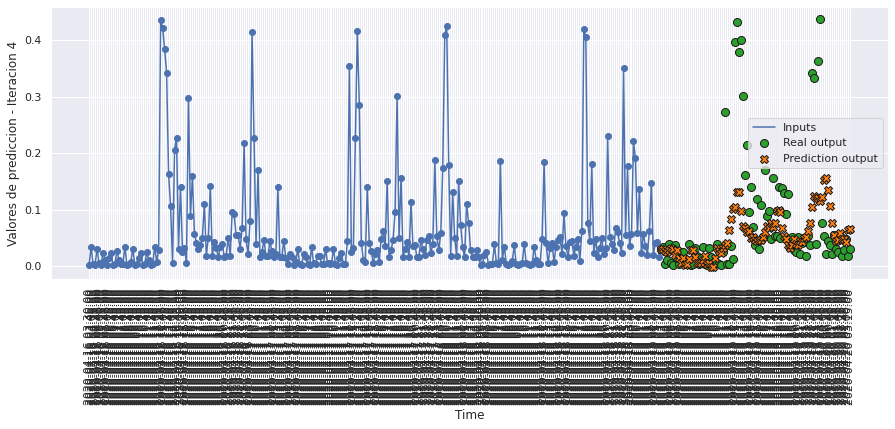

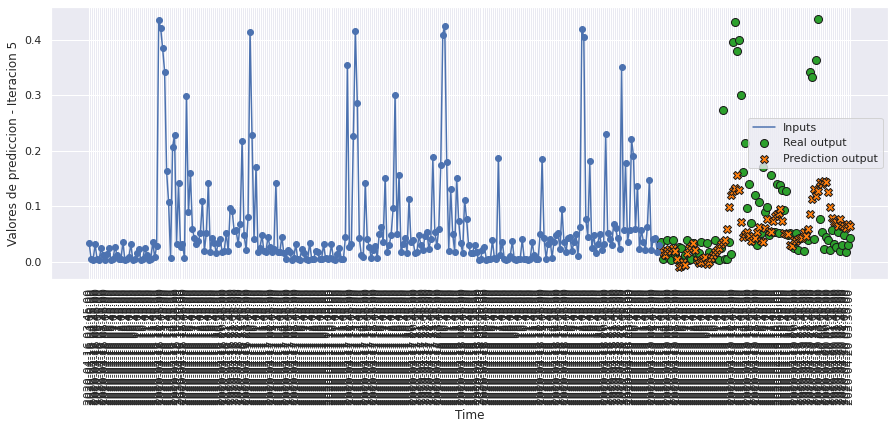

...

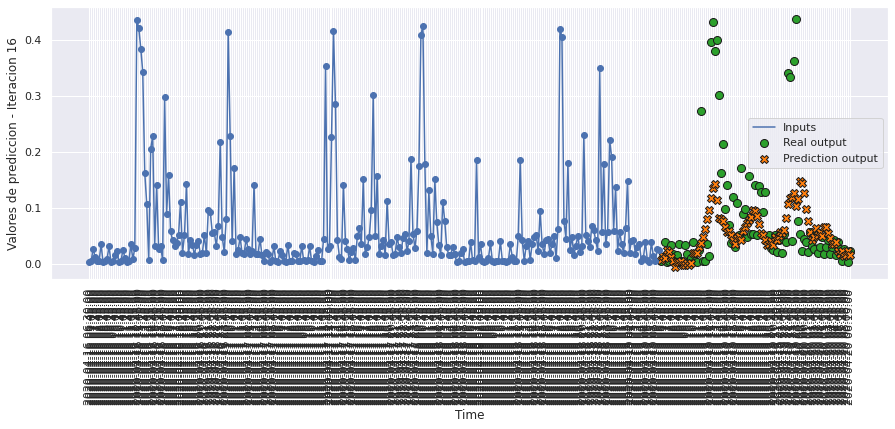

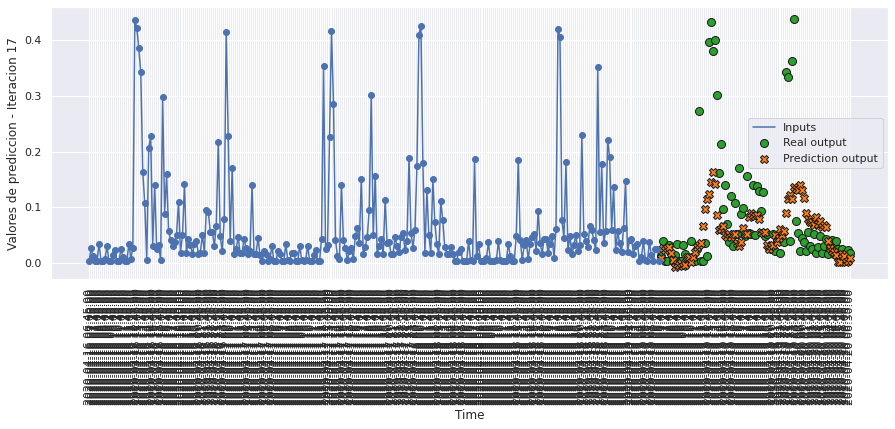

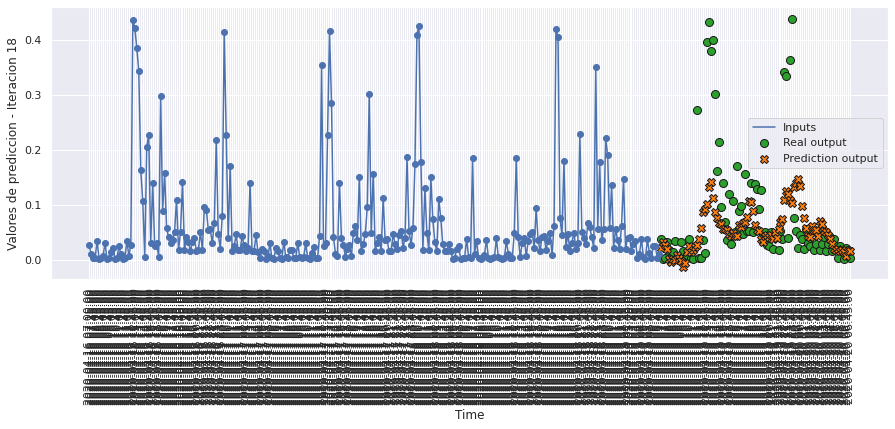

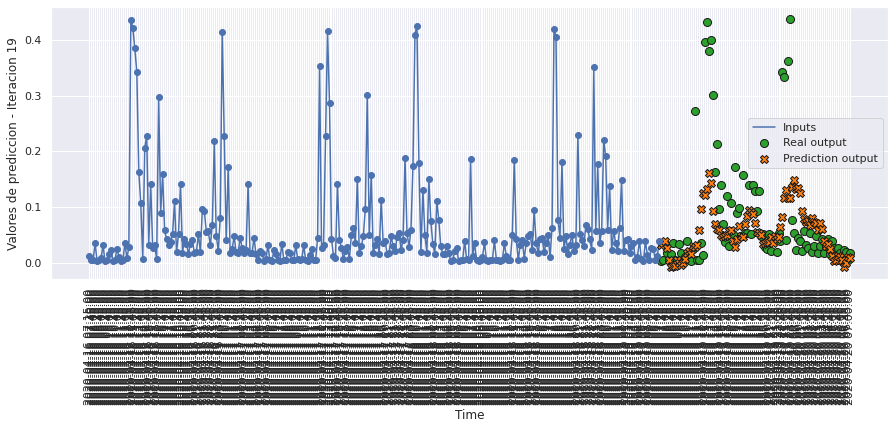

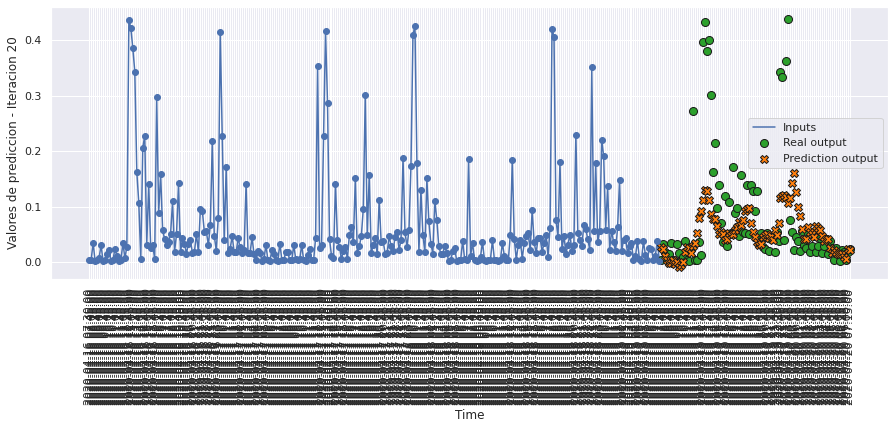

In [95]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_window_predictions(int(test_df.iloc[0].name), int(test_df.iloc[-1].name), data_testY, 
                        testPredict5.reshape(testPredict5.shape[0],n_predicciones), 20, 0)

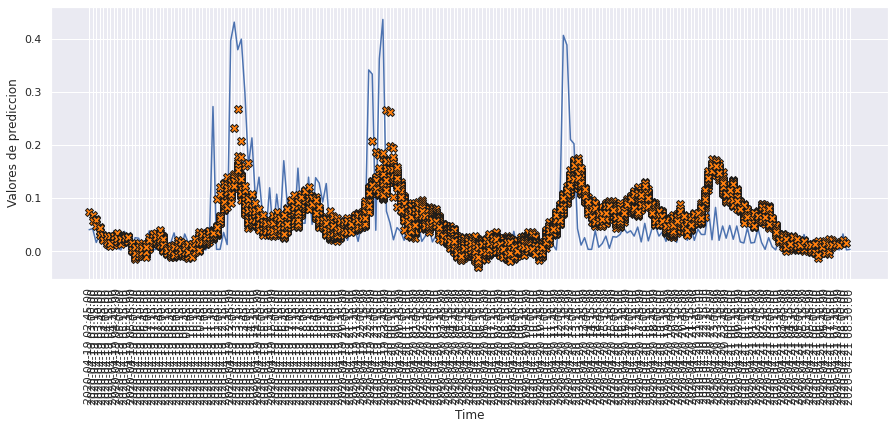

In [96]:
plot_window_predictions_values(int(test_df.iloc[0].name), 
                               testPredict5.reshape(testPredict5.shape[0],n_predicciones), 120)

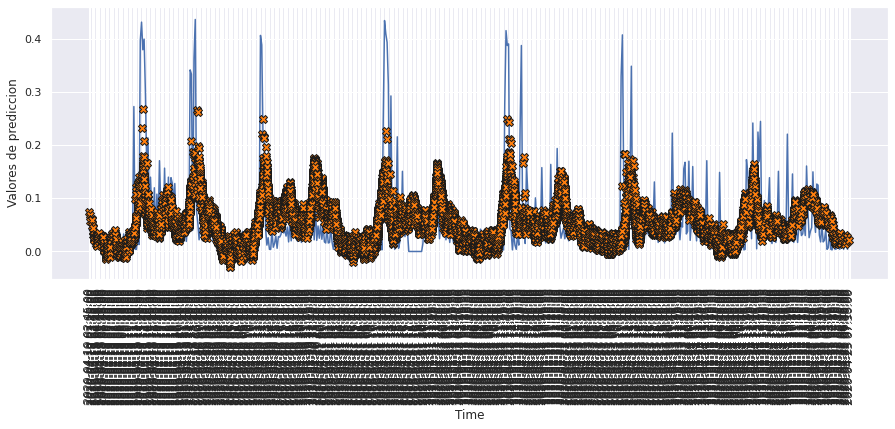

In [97]:
plot_window_predictions_values(int(test_df.iloc[0].name), 
                               testPredict5.reshape(testPredict5.shape[0],n_predicciones), 500)

# MODELO 6: CONVOLUCIONAL 1D CON LSTM 

### Construimos el modelo

In [98]:
def build_model6():
    model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(None, n_entrada, n_features)),
        tf.keras.layers.TimeDistributed(tf.keras.layers.Conv1D(filters=64, kernel_size=1, activation='relu')), 
        tf.keras.layers.TimeDistributed(tf.keras.layers.MaxPooling1D(pool_size=2)),
        tf.keras.layers.TimeDistributed(tf.keras.layers.Flatten()),
        tf.keras.layers.LSTM(128, activation='tanh', return_sequences=True),
        tf.keras.layers.Dense(n_predicciones)
    ])

    optimizer = tf.keras.optimizers.Adam()

    model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', smape])

    return model

In [99]:
model6 = build_model6()
model6.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 time_distributed_3 (TimeDis  (None, None, 288, 64)    128       
 tributed)                                                       
                                                                 
 time_distributed_4 (TimeDis  (None, None, 144, 64)    0         
 tributed)                                                       
                                                                 
 time_distributed_5 (TimeDis  (None, None, 9216)       0         
 tributed)                                                       
                                                                 
 lstm_7 (LSTM)               (None, None, 128)         4784640   
                                                                 
 dense_5 (Dense)             (None, None, 96)          12384     
                                                      

### Entrenamiento del modelo

In [100]:
history6 = model6.fit(scaled_trainX_4D, data_trainY_3D, epochs=n_epochs, batch_size = batch_size, 
                    validation_data=(scaled_valX_4D, data_valY_3D), verbose = 1, callbacks=[early_stop])

Epoch 1/200
351/351 [==============================] - 5s 11ms/step - loss: 0.0058 - mae: 0.0452 - mse: 0.0058 - smape: 0.8023 - val_loss: 0.0064 - val_mae: 0.0441 - val_mse: 0.0064 - val_smape: 0.7788
Epoch 2/200
351/351 [==============================] - 3s 10ms/step - loss: 0.0056 - mae: 0.0442 - mse: 0.0056 - smape: 0.7862 - val_loss: 0.0063 - val_mae: 0.0441 - val_mse: 0.0063 - val_smape: 0.7825
Epoch 3/200
351/351 [==============================] - 3s 10ms/step - loss: 0.0056 - mae: 0.0440 - mse: 0.0056 - smape: 0.7867 - val_loss: 0.0064 - val_mae: 0.0454 - val_mse: 0.0064 - val_smape: 0.7962
Epoch 4/200
351/351 [==============================] - 3s 9ms/step - loss: 0.0055 - mae: 0.0438 - mse: 0.0055 - smape: 0.7866 - val_loss: 0.0063 - val_mae: 0.0445 - val_mse: 0.0063 - val_smape: 0.7886
Epoch 5/200
351/351 [==============================] - 3s 10ms/step - loss: 0.0055 - mae: 0.0437 - mse: 0.0055 - smape: 0.7865 - val_loss: 0.0064 - val_mae: 0.0442 - val_mse: 0.0064 - val_smape

351/351 [==============================] - 3s 10ms/step - loss: 0.0042 - mae: 0.0400 - mse: 0.0042 - smape: 0.7913 - val_loss: 0.0079 - val_mae: 0.0519 - val_mse: 0.0079 - val_smape: 0.9354
Epoch 82/200
351/351 [==============================] - 4s 10ms/step - loss: 0.0042 - mae: 0.0399 - mse: 0.0042 - smape: 0.7914 - val_loss: 0.0080 - val_mae: 0.0524 - val_mse: 0.0080 - val_smape: 0.9507
Epoch 83/200
351/351 [==============================] - 4s 10ms/step - loss: 0.0042 - mae: 0.0399 - mse: 0.0042 - smape: 0.7908 - val_loss: 0.0082 - val_mae: 0.0528 - val_mse: 0.0082 - val_smape: 0.9640
Epoch 84/200
351/351 [==============================] - 3s 10ms/step - loss: 0.0042 - mae: 0.0399 - mse: 0.0042 - smape: 0.7904 - val_loss: 0.0081 - val_mae: 0.0528 - val_mse: 0.0081 - val_smape: 0.9535
Epoch 85/200
351/351 [==============================] - 3s 10ms/step - loss: 0.0042 - mae: 0.0398 - mse: 0.0042 - smape: 0.7904 - val_loss: 0.0081 - val_mae: 0.0524 - val_mse: 0.0081 - val_smape: 0.949

In [101]:
hist6 = pd.DataFrame(history6.history)
hist6['epoch'] = history6.epoch
hist6

,loss,mae,mse,smape,val_loss,val_mae,val_mse,val_smape,epoch
0,0.005849,0.045180,0.005849,0.802349,0.006373,0.044059,0.006373,0.778793,0
1,0.005613,0.044160,0.005613,0.786173,0.006345,0.044117,0.006345,0.782504,1
2,0.005553,0.043951,0.005553,0.786688,0.006360,0.045363,0.006360,0.796179,2
3,0.005508,0.043792,0.005508,0.786565,0.006328,0.044494,0.006328,0.788601,3
4,0.005467,0.043656,0.005467,0.786516,0.006406,0.044229,0.006406,0.823663,4
...,...,...,...,...,...,...,...,...,...
99,0.004109,0.039402,0.004109,0.786190,0.008298,0.053283,0.008298,0.954394,99
100,0.004102,0.039377,0.004102,0.785891,0.008355,0.053506,0.008355,0.957498,100
101,0.004097,0.039346,0.004097,0.785481,0.008319,0.053448,0.008319,0.953845,101
102,0.004092,0.039328,0.004092,0.785376,0.008320,0.053186,0.008320,0.953045,102


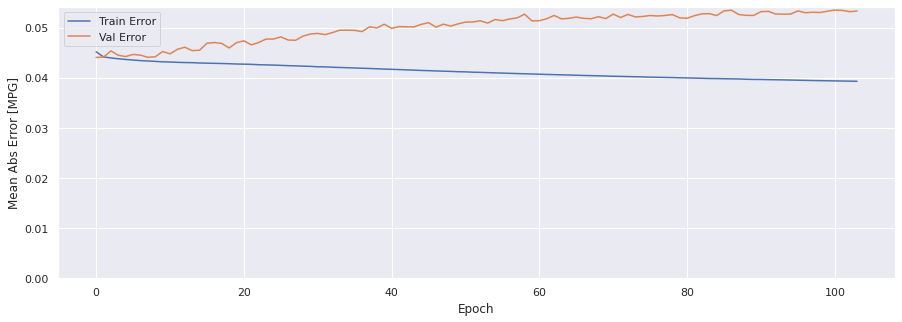

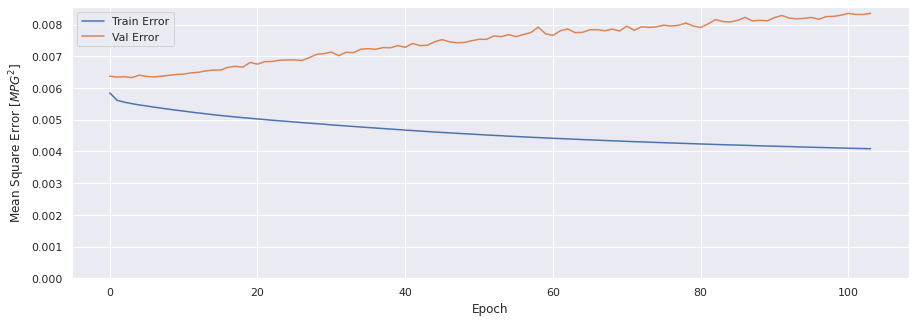

In [102]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_history(history6)

### Evaluar predicciones

In [103]:
score_train6 = model6.evaluate(scaled_trainX_4D, data_trainY_3D, verbose=1)
print(f'Loss:{score_train6[0]}')
print(f'MAE:{score_train6[1]}')
print(f'MSE:{score_train6[2]}')
print(f'SMAPE:{score_train6[3]}')

1401/1401 [==============================] - 8s 6ms/step - loss: 0.0040 - mae: 0.0390 - mse: 0.0040 - smape: 0.7819
Loss:0.004025703761726618
MAE:0.03897657245397568
MSE:0.004025703761726618
SMAPE:0.7818803191184998


In [104]:
score_val6 = model6.evaluate(scaled_valX_4D, data_valY_3D, verbose=1)
print(f'Loss:{score_val6[0]}')
print(f'MAE:{score_val6[1]}')
print(f'MSE:{score_val6[2]}')
print(f'SMAPE:{score_val6[3]}')

291/291 [==============================] - 2s 5ms/step - loss: 0.0084 - mae: 0.0533 - mse: 0.0084 - smape: 0.9544
Loss:0.008358093909919262
MAE:0.0533059760928154
MSE:0.008358093909919262
SMAPE:0.9543555378913879


In [105]:
score_test6 = model6.evaluate(scaled_testX_4D, data_testY_3D, verbose=1)
print(f'Loss:{score_test6[0]}')
print(f'MAE:{score_test6[1]}')
print(f'MSE:{score_test6[2]}')
print(f'SMAPE:{score_test6[3]}')

291/291 [==============================] - 2s 5ms/step - loss: 0.0072 - mae: 0.0508 - mse: 0.0072 - smape: 0.9023
Loss:0.007160965818911791
MAE:0.050811946392059326
MSE:0.007160965818911791
SMAPE:0.9022585153579712


### Comparativa de resultados

In [106]:
result = hist6.iloc[-1]
comparativa6 = pd.DataFrame(np.array([[result['mae'], result['mse'], result['smape'], math.sqrt(result['mse'])], 
                                      [result['val_mae'], result['val_mse'], result['val_smape'], math.sqrt(result['val_mse'])],
                                      [score_test6[1], score_test6[2], score_test6[3], math.sqrt(score_test6[2])]]),
                            columns = ['MAE', 'MSE', 'SMAPE', 'RMSE'],
                            index = ['ENTRENAMIENTO', 'VALIDACION', 'TEST'])

comparativa6.style.set_caption("Método de ventana de varios pasos - Convolucional 1D con LSTM")

,MAE,MSE,SMAPE,RMSE
ENTRENAMIENTO,0.039294,0.004087,0.784905,0.063930
VALIDACION,0.053306,0.008358,0.955181,0.091423
TEST,0.050812,0.007161,0.902259,0.084622


### Obtener predicciones

In [107]:
trainPredict6 = model6.predict(scaled_trainX_4D)
testPredict6 = model6.predict(scaled_testX_4D)

### Visualización de las predicciones

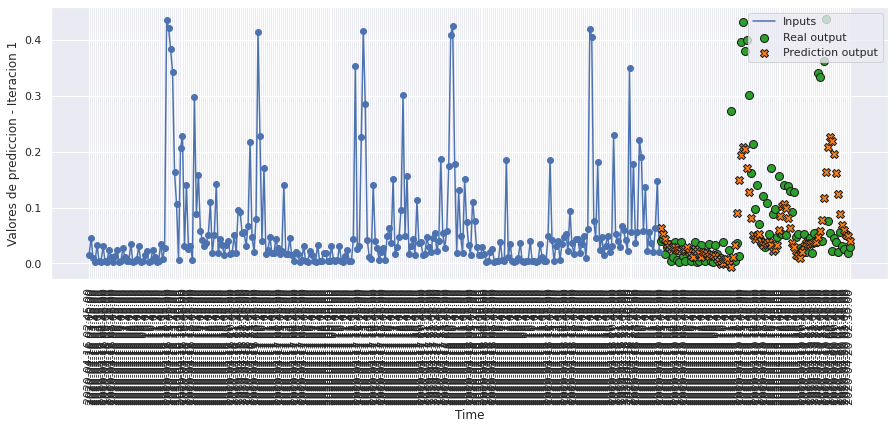

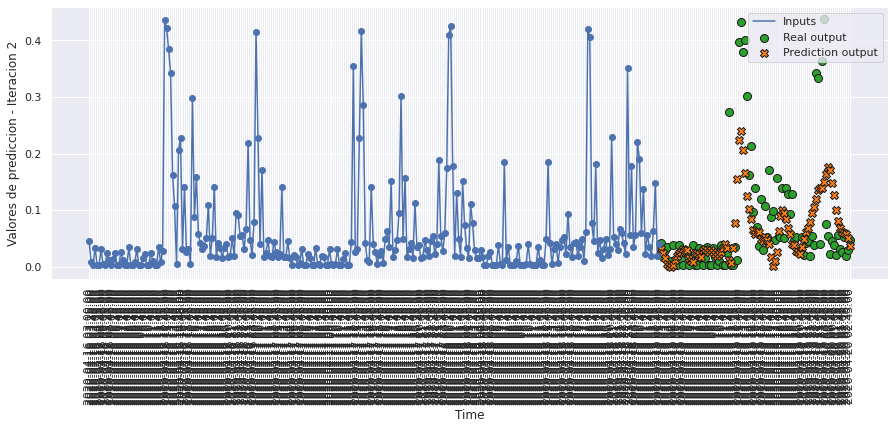

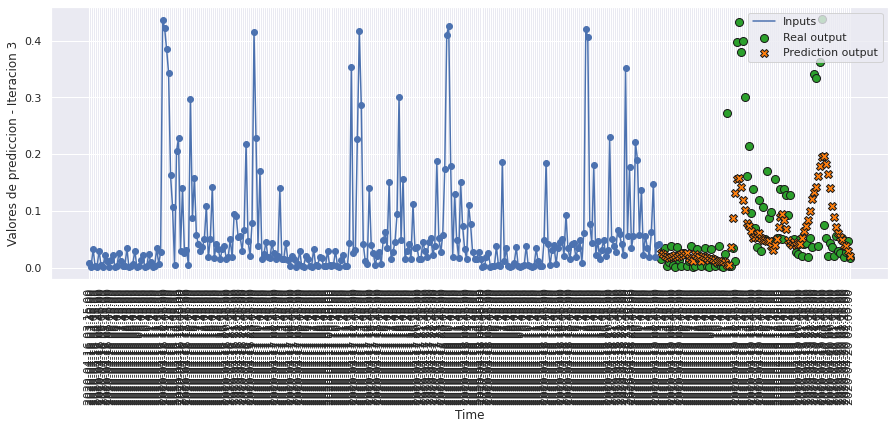

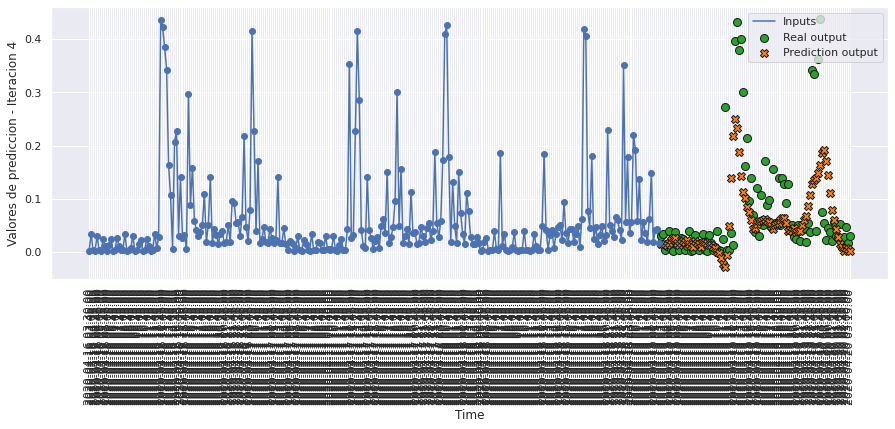

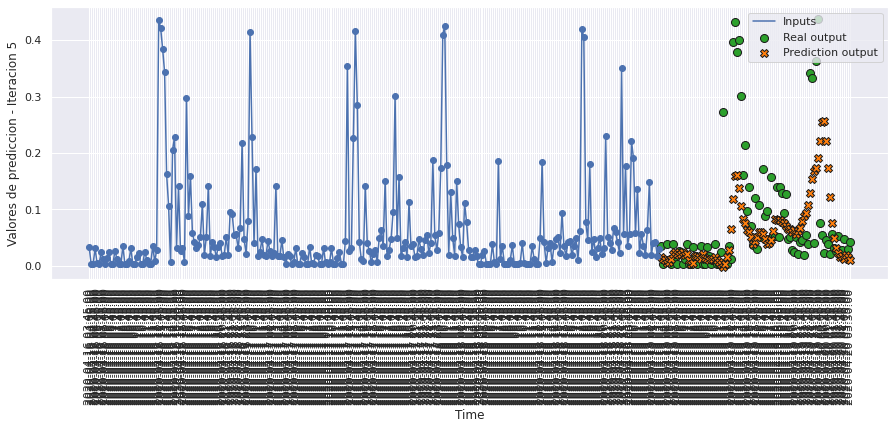

...

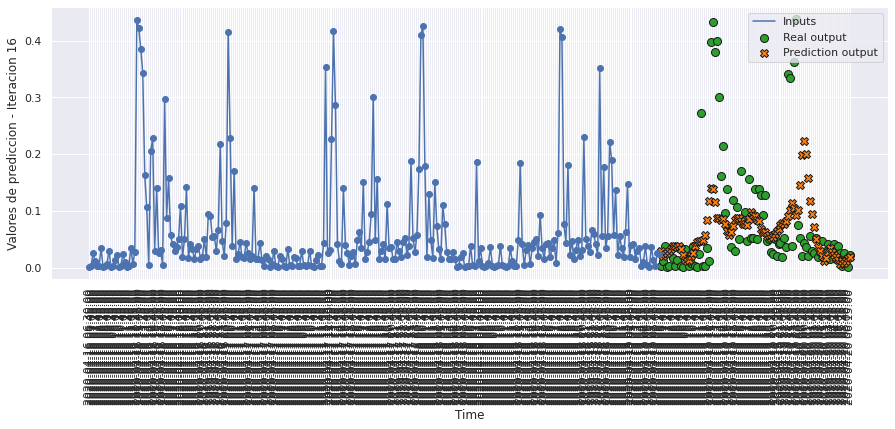

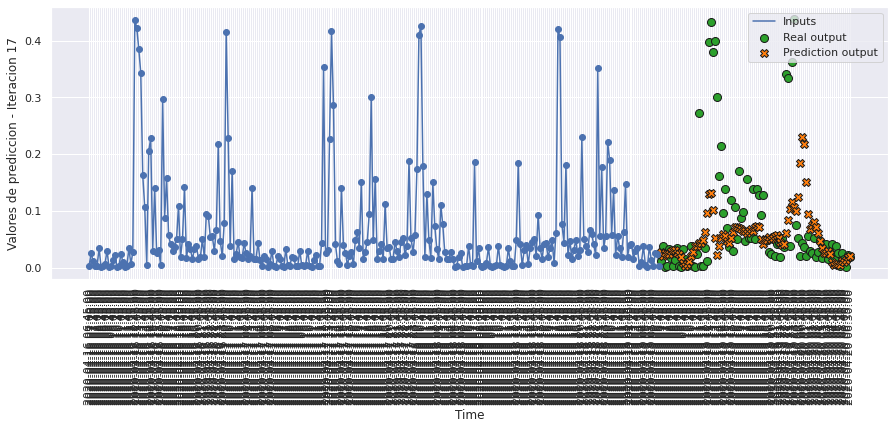

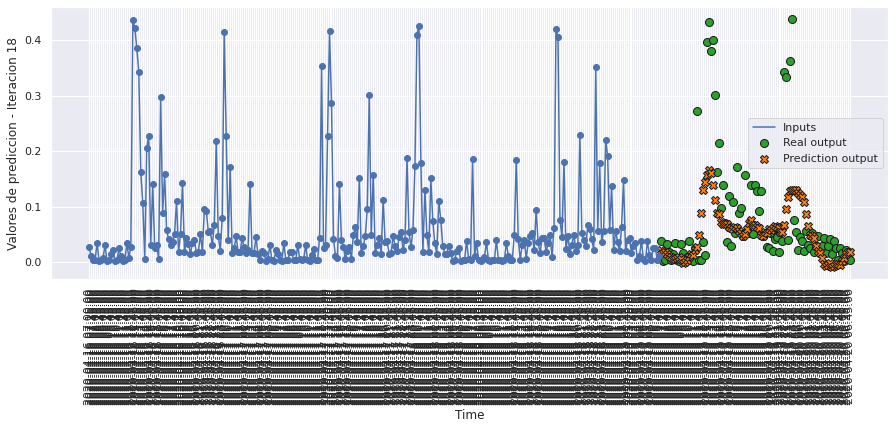

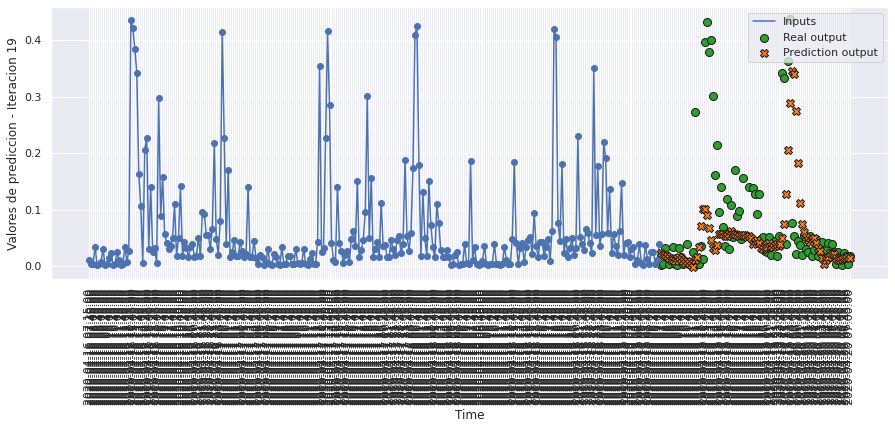

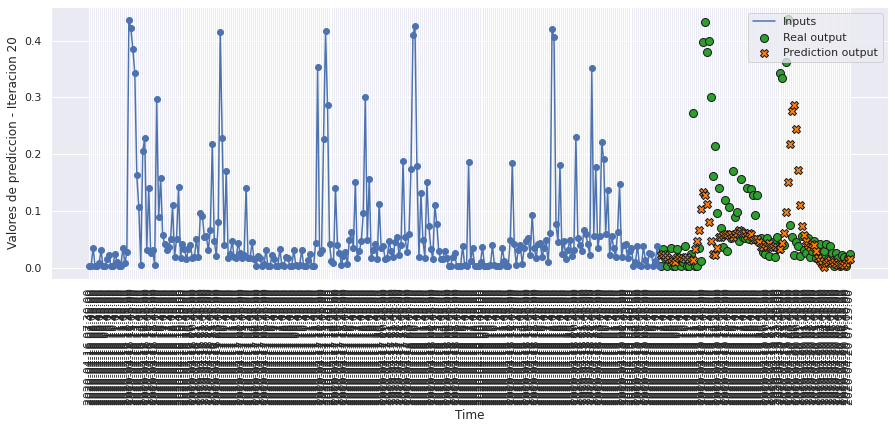

In [108]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_window_predictions(int(test_df.iloc[0].name), int(test_df.iloc[-1].name), data_testY, 
                        testPredict6.reshape(testPredict6.shape[0],n_predicciones), 20, 0)

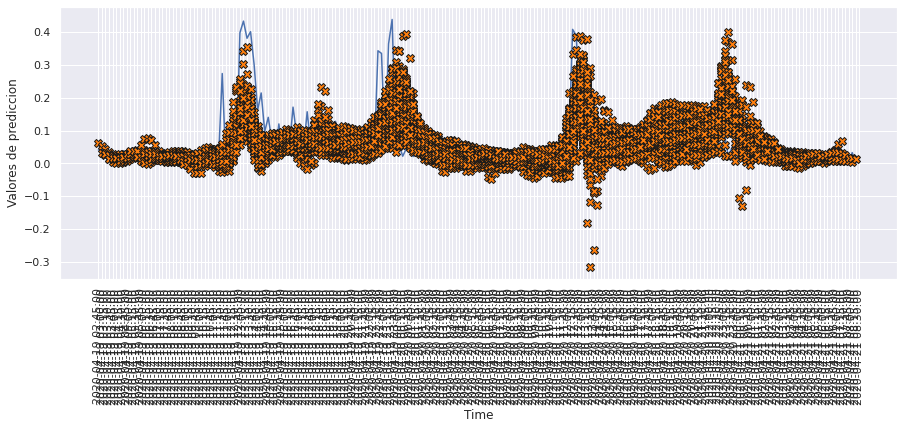

In [109]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict6.reshape(testPredict6.shape[0],n_predicciones), 120)

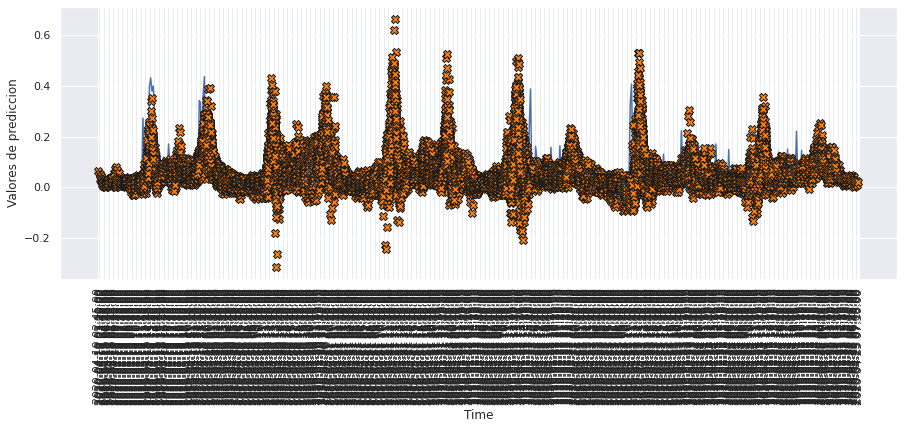

In [110]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict6.reshape(testPredict6.shape[0],n_predicciones), 500)

# MODELO 7: CONVLSTM1D

### Construimos el modelo

In [111]:
def build_model7():
    model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(None, n_entrada, n_features)),
        tf.keras.layers.ConvLSTM1D(filters=64, kernel_size=1, activation='tanh'),
        tf.keras.layers.Flatten(),
        tf.keras.layers.Dense(n_predicciones),
    ])

    optimizer = tf.keras.optimizers.Adam()

    model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', smape])

    return model

In [112]:
model7 = build_model7()
model7.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv_lstm1d (ConvLSTM1D)    (None, 288, 64)           16896     
                                                                 
 flatten_2 (Flatten)         (None, 18432)             0         
                                                                 
 dense_6 (Dense)             (None, 96)                1769568   
                                                                 
Total params: 1,786,464
Trainable params: 1,786,464
Non-trainable params: 0
_________________________________________________________________


### Entrenamiento del modelo

In [113]:
history7 = model7.fit(scaled_trainX_4D, data_trainY, epochs=n_epochs, batch_size = batch_size, 
                    validation_data=(scaled_valX_4D, data_valY), verbose = 1, callbacks=[early_stop])

Epoch 1/200
351/351 [==============================] - 10s 23ms/step - loss: 0.0058 - mae: 0.0447 - mse: 0.0058 - smape: 0.7932 - val_loss: 0.0064 - val_mae: 0.0451 - val_mse: 0.0064 - val_smape: 0.7803
Epoch 2/200
351/351 [==============================] - 8s 22ms/step - loss: 0.0057 - mae: 0.0440 - mse: 0.0057 - smape: 0.7809 - val_loss: 0.0065 - val_mae: 0.0472 - val_mse: 0.0065 - val_smape: 0.8066
Epoch 3/200
351/351 [==============================] - 8s 22ms/step - loss: 0.0056 - mae: 0.0439 - mse: 0.0056 - smape: 0.7783 - val_loss: 0.0064 - val_mae: 0.0443 - val_mse: 0.0064 - val_smape: 0.7696
Epoch 4/200
351/351 [==============================] - 8s 22ms/step - loss: 0.0056 - mae: 0.0438 - mse: 0.0056 - smape: 0.7767 - val_loss: 0.0064 - val_mae: 0.0449 - val_mse: 0.0064 - val_smape: 0.7762
Epoch 5/200
351/351 [==============================] - 8s 22ms/step - loss: 0.0056 - mae: 0.0438 - mse: 0.0056 - smape: 0.7752 - val_loss: 0.0063 - val_mae: 0.0436 - val_mse: 0.0063 - val_sma

351/351 [==============================] - 7s 21ms/step - loss: 0.0053 - mae: 0.0433 - mse: 0.0053 - smape: 0.7939 - val_loss: 0.0064 - val_mae: 0.0444 - val_mse: 0.0064 - val_smape: 0.7911
Epoch 82/200
351/351 [==============================] - 7s 21ms/step - loss: 0.0053 - mae: 0.0433 - mse: 0.0053 - smape: 0.7942 - val_loss: 0.0064 - val_mae: 0.0445 - val_mse: 0.0064 - val_smape: 0.7922
Epoch 83/200
351/351 [==============================] - 7s 21ms/step - loss: 0.0053 - mae: 0.0433 - mse: 0.0053 - smape: 0.7944 - val_loss: 0.0064 - val_mae: 0.0441 - val_mse: 0.0064 - val_smape: 0.7869
Epoch 84/200
351/351 [==============================] - 7s 21ms/step - loss: 0.0053 - mae: 0.0433 - mse: 0.0053 - smape: 0.7948 - val_loss: 0.0064 - val_mae: 0.0443 - val_mse: 0.0064 - val_smape: 0.7916
Epoch 85/200
351/351 [==============================] - 7s 21ms/step - loss: 0.0053 - mae: 0.0433 - mse: 0.0053 - smape: 0.7945 - val_loss: 0.0064 - val_mae: 0.0439 - val_mse: 0.0064 - val_smape: 0.786

In [114]:
hist7 = pd.DataFrame(history7.history)
hist7['epoch'] = history7.epoch
hist7

,loss,mae,mse,smape,val_loss,val_mae,val_mse,val_smape,epoch
0,0.005814,0.044746,0.005814,0.793235,0.006433,0.045111,0.006433,0.780345,0
1,0.005653,0.044044,0.005653,0.780866,0.006462,0.047179,0.006462,0.806585,1
2,0.005629,0.043916,0.005629,0.778295,0.006377,0.044337,0.006377,0.769644,2
3,0.005612,0.043827,0.005612,0.776722,0.006383,0.044870,0.006383,0.776177,3
4,0.005594,0.043754,0.005594,0.775155,0.006348,0.043618,0.006348,0.760780,4
...,...,...,...,...,...,...,...,...,...
110,0.005291,0.043312,0.005291,0.798343,0.006378,0.043966,0.006378,0.791880,110
111,0.005290,0.043294,0.005290,0.797918,0.006387,0.044323,0.006387,0.797406,111
112,0.005289,0.043307,0.005289,0.798182,0.006384,0.044169,0.006384,0.793819,112
113,0.005289,0.043308,0.005289,0.798033,0.006383,0.044014,0.006383,0.792871,113


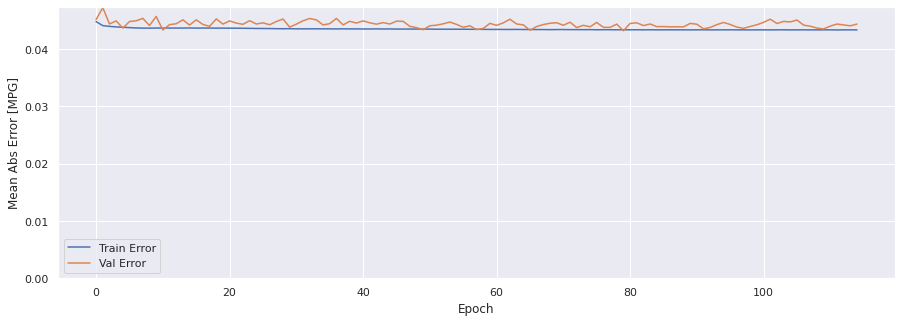

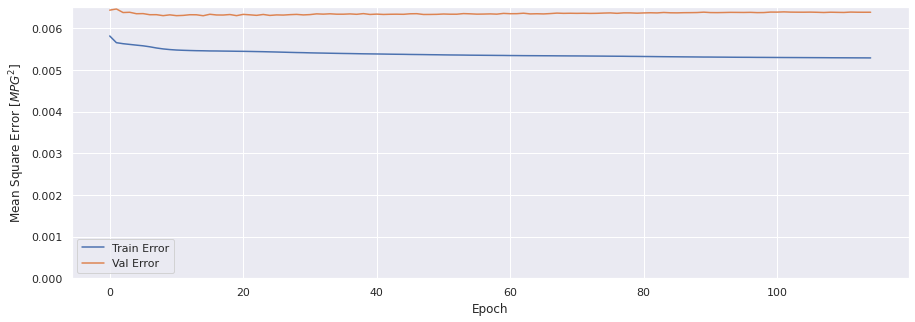

In [115]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_history(history7)

### Evaluar predicciones

In [116]:
score_train7 = model7.evaluate(scaled_trainX_4D, data_trainY, verbose=1)
print(f'Loss:{score_train7[0]}')
print(f'MAE:{score_train7[1]}')
print(f'MSE:{score_train7[2]}')
print(f'SMAPE:{score_train7[3]}')

1401/1401 [==============================] - 10s 7ms/step - loss: 0.0053 - mae: 0.0433 - mse: 0.0053 - smape: 0.7953
Loss:0.005261159967631102
MAE:0.04325515776872635
MSE:0.005261159967631102
SMAPE:0.7953315377235413


In [117]:
score_val7 = model7.evaluate(scaled_valX_4D, data_valY, verbose=1)
print(f'Loss:{score_val7[0]}')
print(f'MAE:{score_val7[1]}')
print(f'MSE:{score_val7[2]}')
print(f'SMAPE:{score_val7[3]}')

291/291 [==============================] - 2s 6ms/step - loss: 0.0064 - mae: 0.0443 - mse: 0.0064 - smape: 0.7950
Loss:0.0063835736364126205
MAE:0.044318076223134995
MSE:0.0063835736364126205
SMAPE:0.7949584722518921


In [118]:
score_test7 = model7.evaluate(scaled_testX_4D, data_testY, verbose=1)
print(f'Loss:{score_test7[0]}')
print(f'MAE:{score_test7[1]}')
print(f'MSE:{score_test7[2]}')
print(f'SMAPE:{score_test7[3]}')

291/291 [==============================] - 2s 6ms/step - loss: 0.0062 - mae: 0.0465 - mse: 0.0062 - smape: 0.8027
Loss:0.006169034168124199
MAE:0.046462103724479675
MSE:0.006169034168124199
SMAPE:0.8027138113975525


### Comparativa de resultados

In [119]:
result = hist7.iloc[-1]
comparativa7 = pd.DataFrame(np.array([[result['mae'], result['mse'], result['smape'], math.sqrt(result['mse'])], 
                                      [result['val_mae'], result['val_mse'], result['val_smape'], math.sqrt(result['val_mse'])],
                                      [score_test7[1], score_test7[2], score_test7[3], math.sqrt(score_test7[2])]]),
                            columns = ['MAE', 'MSE', 'SMAPE', 'RMSE'],
                            index = ['ENTRENAMIENTO', 'VALIDACION', 'TEST'])

comparativa7.style.set_caption("Método de ventana de varios pasos - CONVLSTM 1D")

,MAE,MSE,SMAPE,RMSE
ENTRENAMIENTO,0.043299,0.005288,0.798317,0.072716
VALIDACION,0.044318,0.006384,0.795641,0.079897
TEST,0.046462,0.006169,0.802714,0.078543


### Obtener predicciones

In [120]:
trainPredict7 = model7.predict(scaled_trainX_4D)
testPredict7 = model7.predict(scaled_testX_4D)

### Visualización de las predicciones

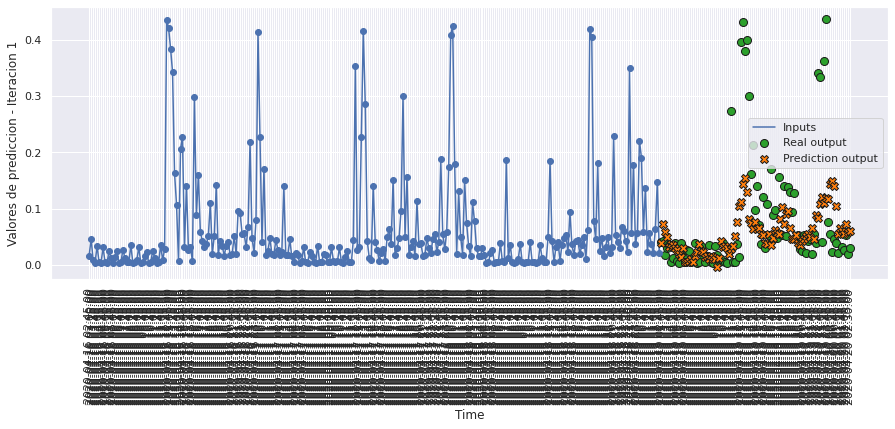

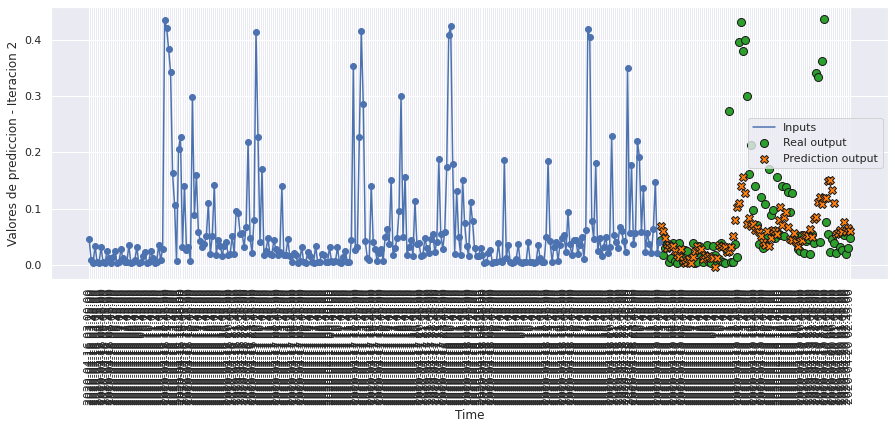

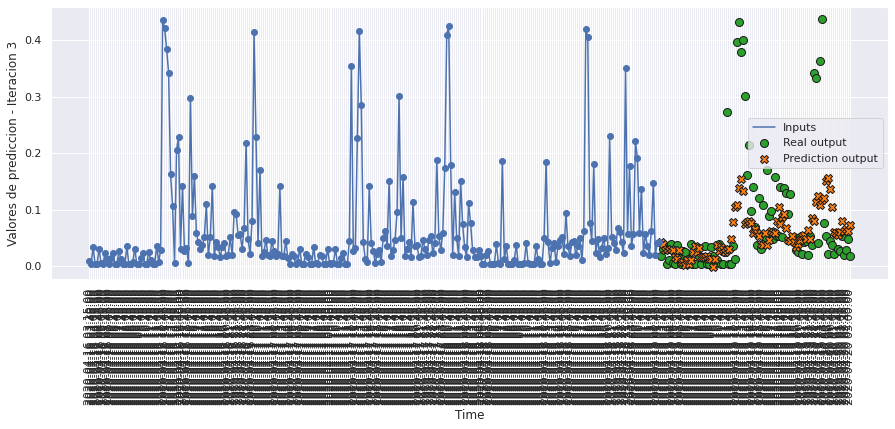

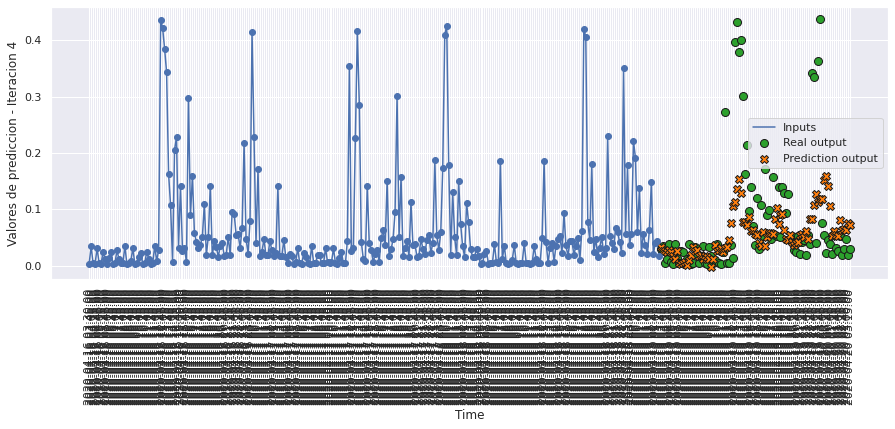

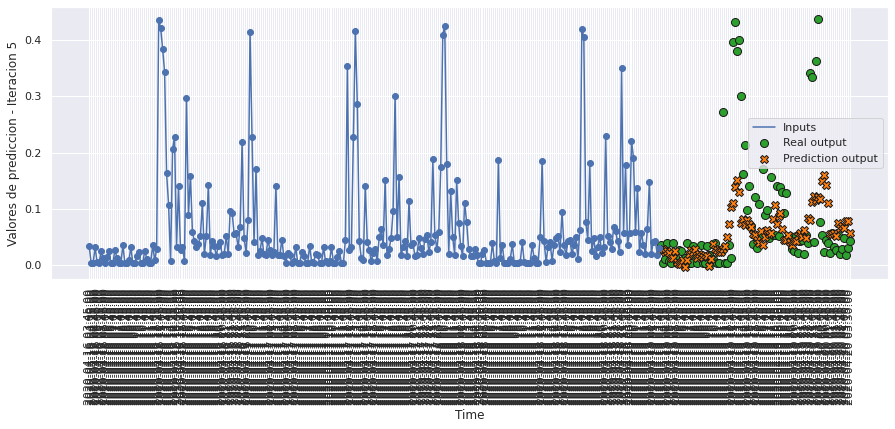

...

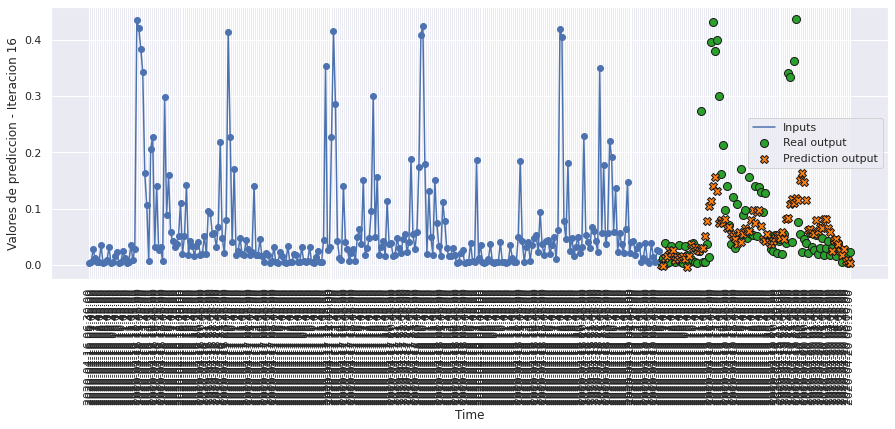

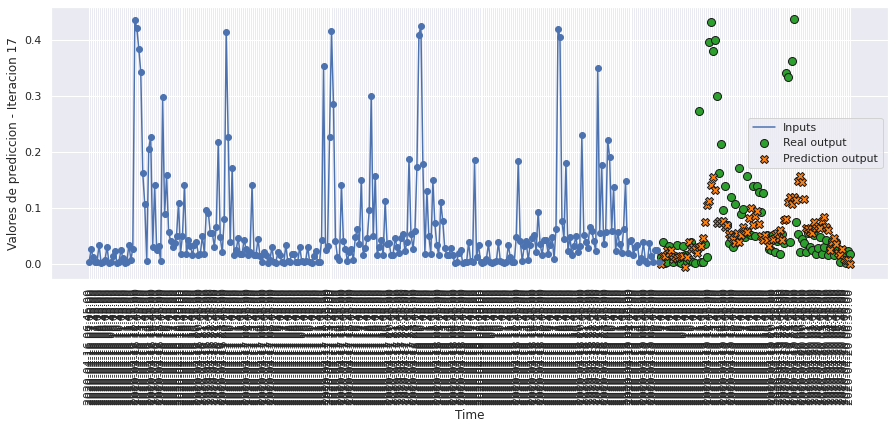

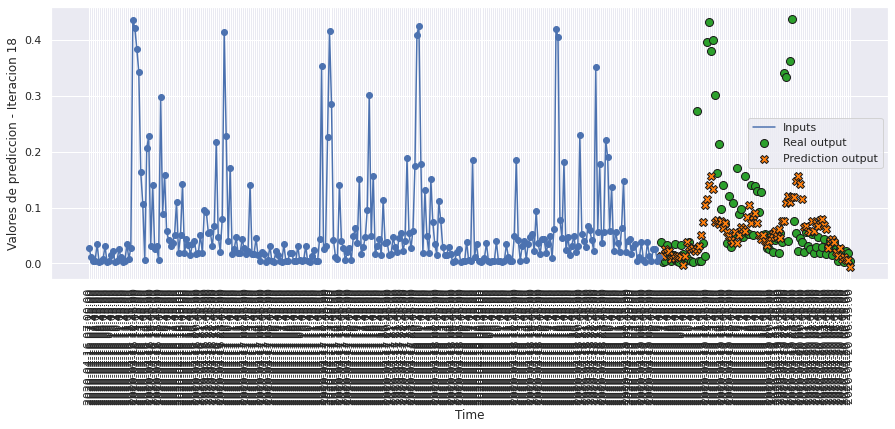

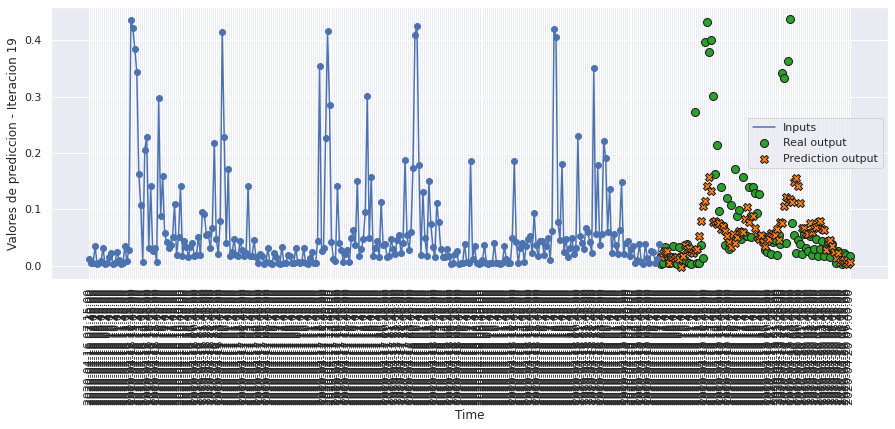

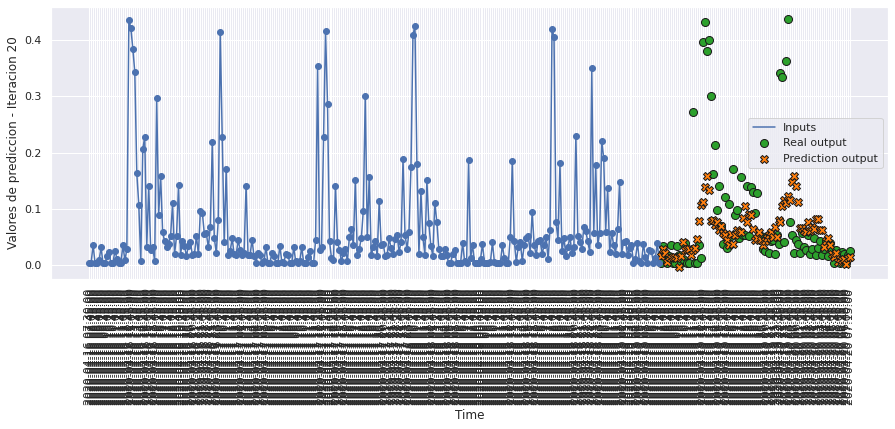

In [121]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_window_predictions(int(test_df.iloc[0].name), int(test_df.iloc[-1].name), data_testY, testPredict7, 20, 0)

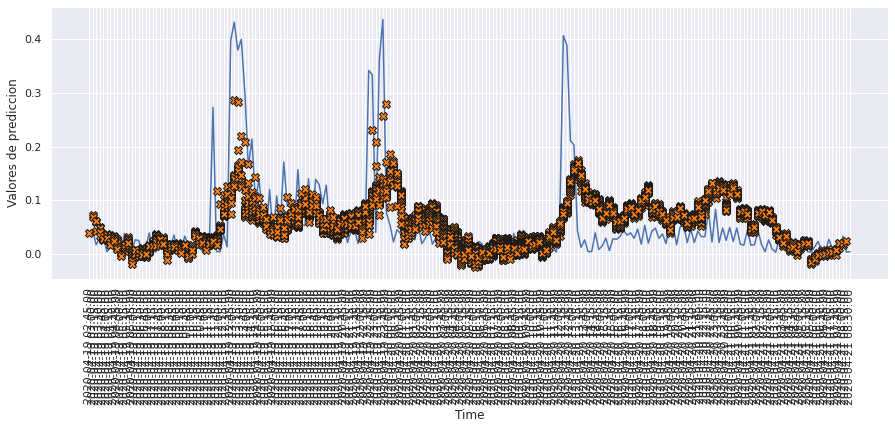

In [122]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict7, 120)

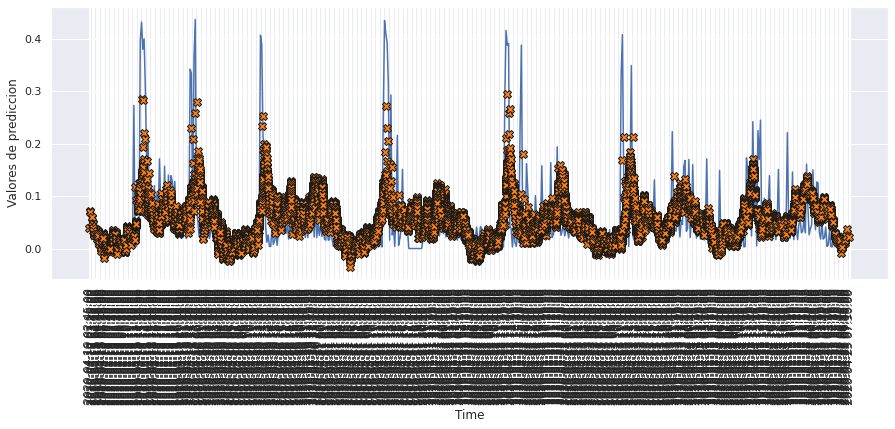

In [123]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict7, 500)

# MODELO 8: CONVLSTM2D

### Construimos el modelo

In [124]:
def build_model8():
    model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(1, 1, n_entrada, n_features)),
        tf.keras.layers.ConvLSTM2D(filters=64, kernel_size=(1,1), activation='relu'),
        tf.keras.layers.Flatten(),
        tf.keras.layers.Dense(n_predicciones),
    ])

    optimizer = tf.keras.optimizers.Adam()

    model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', smape])

    return model

In [125]:
model8 = build_model8()
model8.summary()

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv_lstm2d (ConvLSTM2D)    (None, 1, 288, 64)        16896     
                                                                 
 flatten_3 (Flatten)         (None, 18432)             0         
                                                                 
 dense_7 (Dense)             (None, 96)                1769568   
                                                                 
Total params: 1,786,464
Trainable params: 1,786,464
Non-trainable params: 0
_________________________________________________________________


### Entrenamiento del modelo

In [126]:
history8 = model8.fit(scaled_trainX_5D, data_trainY, epochs=n_epochs, batch_size = batch_size, 
                    validation_data=(scaled_valX_5D, data_valY), verbose = 1, callbacks=[early_stop])

Epoch 1/200
351/351 [==============================] - 9s 21ms/step - loss: 0.0058 - mae: 0.0448 - mse: 0.0058 - smape: 0.7923 - val_loss: 0.0064 - val_mae: 0.0442 - val_mse: 0.0064 - val_smape: 0.7673
Epoch 2/200
351/351 [==============================] - 7s 20ms/step - loss: 0.0056 - mae: 0.0440 - mse: 0.0056 - smape: 0.7790 - val_loss: 0.0064 - val_mae: 0.0435 - val_mse: 0.0064 - val_smape: 0.7625
Epoch 3/200
351/351 [==============================] - 7s 21ms/step - loss: 0.0056 - mae: 0.0439 - mse: 0.0056 - smape: 0.7797 - val_loss: 0.0064 - val_mae: 0.0439 - val_mse: 0.0064 - val_smape: 0.7700
Epoch 4/200
351/351 [==============================] - 7s 21ms/step - loss: 0.0056 - mae: 0.0439 - mse: 0.0056 - smape: 0.7809 - val_loss: 0.0063 - val_mae: 0.0435 - val_mse: 0.0063 - val_smape: 0.7665
Epoch 5/200
351/351 [==============================] - 7s 21ms/step - loss: 0.0056 - mae: 0.0438 - mse: 0.0056 - smape: 0.7811 - val_loss: 0.0063 - val_mae: 0.0437 - val_mse: 0.0063 - val_smap

351/351 [==============================] - 7s 20ms/step - loss: 0.0052 - mae: 0.0432 - mse: 0.0052 - smape: 0.8013 - val_loss: 0.0064 - val_mae: 0.0441 - val_mse: 0.0064 - val_smape: 0.8009
Epoch 82/200
351/351 [==============================] - 7s 21ms/step - loss: 0.0052 - mae: 0.0431 - mse: 0.0052 - smape: 0.8011 - val_loss: 0.0064 - val_mae: 0.0438 - val_mse: 0.0064 - val_smape: 0.7966
Epoch 83/200
351/351 [==============================] - 7s 21ms/step - loss: 0.0052 - mae: 0.0431 - mse: 0.0052 - smape: 0.8015 - val_loss: 0.0064 - val_mae: 0.0445 - val_mse: 0.0064 - val_smape: 0.8056
Epoch 84/200
351/351 [==============================] - 7s 21ms/step - loss: 0.0052 - mae: 0.0432 - mse: 0.0052 - smape: 0.8019 - val_loss: 0.0064 - val_mae: 0.0439 - val_mse: 0.0064 - val_smape: 0.8004
Epoch 85/200
351/351 [==============================] - 7s 21ms/step - loss: 0.0052 - mae: 0.0431 - mse: 0.0052 - smape: 0.8021 - val_loss: 0.0064 - val_mae: 0.0439 - val_mse: 0.0064 - val_smape: 0.798

In [127]:
hist8 = pd.DataFrame(history8.history)
hist8['epoch'] = history8.epoch
hist8

,loss,mae,mse,smape,val_loss,val_mae,val_mse,val_smape,epoch
0,0.005846,0.044770,0.005846,0.792261,0.006408,0.044179,0.006408,0.767318,0
1,0.005643,0.043951,0.005643,0.778965,0.006354,0.043528,0.006354,0.762497,1
2,0.005596,0.043880,0.005596,0.779700,0.006351,0.043872,0.006351,0.770042,2
3,0.005569,0.043868,0.005569,0.780914,0.006332,0.043548,0.006332,0.766524,3
4,0.005552,0.043826,0.005552,0.781147,0.006325,0.043726,0.006325,0.769559,4
...,...,...,...,...,...,...,...,...,...
123,0.005130,0.043132,0.005130,0.809618,0.006420,0.044607,0.006420,0.814763,123
124,0.005130,0.043123,0.005130,0.809747,0.006411,0.044178,0.006411,0.810983,124
125,0.005127,0.043125,0.005127,0.810026,0.006423,0.044312,0.006423,0.811310,125
126,0.005125,0.043120,0.005125,0.810126,0.006419,0.044295,0.006419,0.810988,126


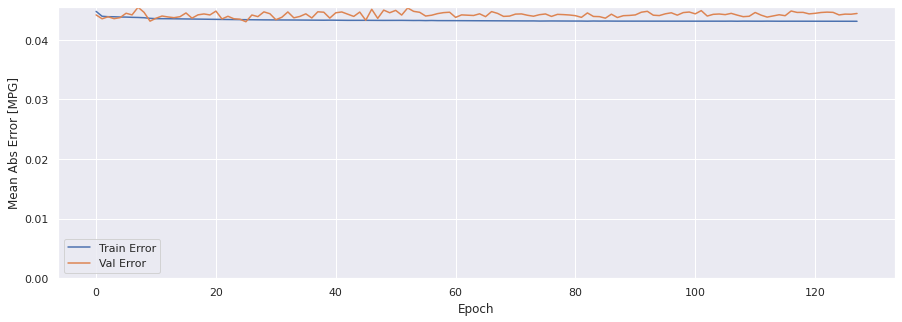

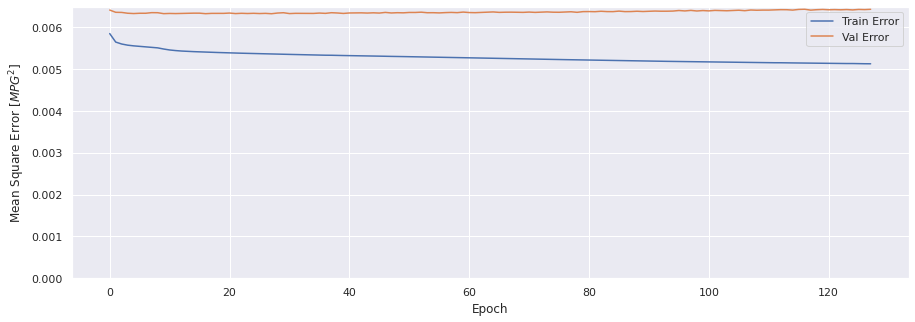

In [128]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_history(history8)

### Evaluar predicciones

In [129]:
score_train8 = model8.evaluate(scaled_trainX_5D, data_trainY, verbose=1)
print(f'Loss:{score_train8[0]}')
print(f'MAE:{score_train8[1]}')
print(f'MSE:{score_train8[2]}')
print(f'SMAPE:{score_train8[3]}')

1401/1401 [==============================] - 9s 7ms/step - loss: 0.0051 - mae: 0.0428 - mse: 0.0051 - smape: 0.8063
Loss:0.005081590265035629
MAE:0.04280656576156616
MSE:0.005081590265035629
SMAPE:0.8062689900398254


In [130]:
score_val8 = model8.evaluate(scaled_valX_5D, data_valY, verbose=1)
print(f'Loss:{score_val8[0]}')
print(f'MAE:{score_val8[1]}')
print(f'MSE:{score_val8[2]}')
print(f'SMAPE:{score_val8[3]}')

291/291 [==============================] - 2s 6ms/step - loss: 0.0064 - mae: 0.0444 - mse: 0.0064 - smape: 0.8115
Loss:0.006426115054637194
MAE:0.04442145675420761
MSE:0.006426115054637194
SMAPE:0.8114503026008606


In [131]:
score_test8 = model8.evaluate(scaled_testX_5D, data_testY, verbose=1)
print(f'Loss:{score_test8[0]}')
print(f'MAE:{score_test8[1]}')
print(f'MSE:{score_test8[2]}')
print(f'SMAPE:{score_test8[3]}')

291/291 [==============================] - 2s 6ms/step - loss: 0.0063 - mae: 0.0469 - mse: 0.0063 - smape: 0.8257
Loss:0.006296954117715359
MAE:0.046937696635723114
MSE:0.006296954117715359
SMAPE:0.8256864547729492


### Comparativa de resultados

In [132]:
result = hist8.iloc[-1]
comparativa8 = pd.DataFrame(np.array([[result['mae'], result['mse'], result['smape'], math.sqrt(result['mse'])], 
                                      [result['val_mae'], result['val_mse'], result['val_smape'], math.sqrt(result['val_mse'])],
                                      [score_test8[1], score_test8[2], score_test8[3], math.sqrt(score_test8[2])]]),
                            columns = ['MAE', 'MSE', 'SMAPE', 'RMSE'],
                            index = ['ENTRENAMIENTO', 'VALIDACION', 'TEST'])

comparativa8.style.set_caption("Método de ventana de varios pasos - CONVLSTM 2D")

,MAE,MSE,SMAPE,RMSE
ENTRENAMIENTO,0.043113,0.005124,0.809933,0.071584
VALIDACION,0.044421,0.006426,0.812103,0.080163
TEST,0.046938,0.006297,0.825686,0.079353


### Obtener predicciones

In [133]:
trainPredict8 = model8.predict(scaled_trainX_5D)
testPredict8 = model8.predict(scaled_testX_5D)

### Visualización de las predicciones

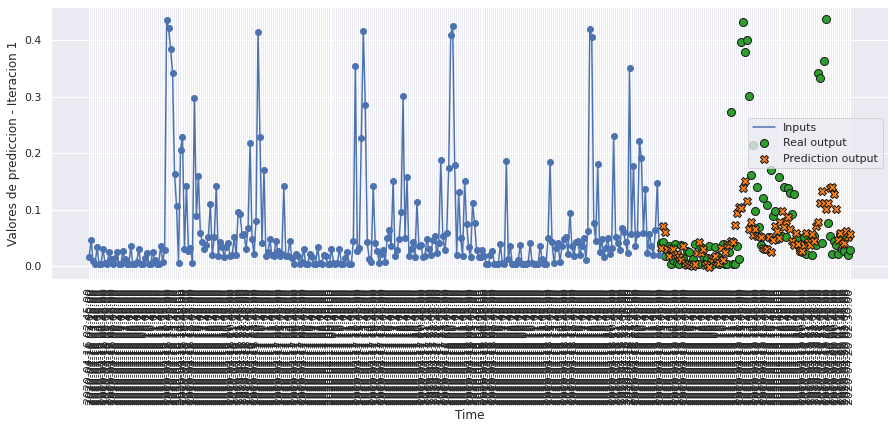

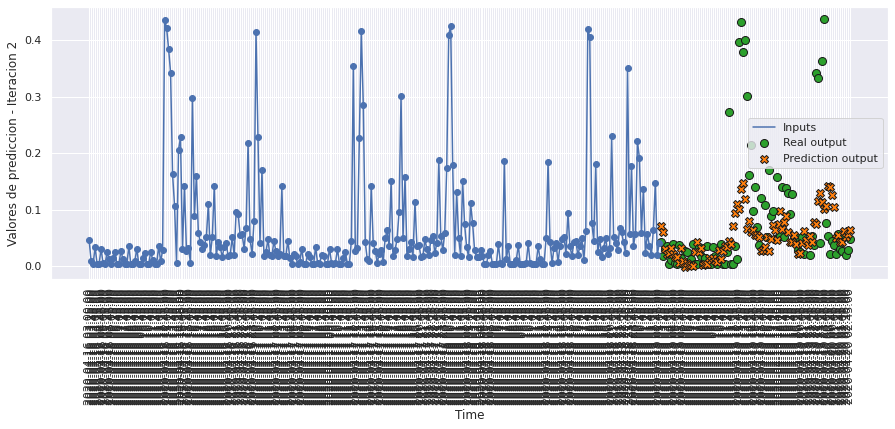

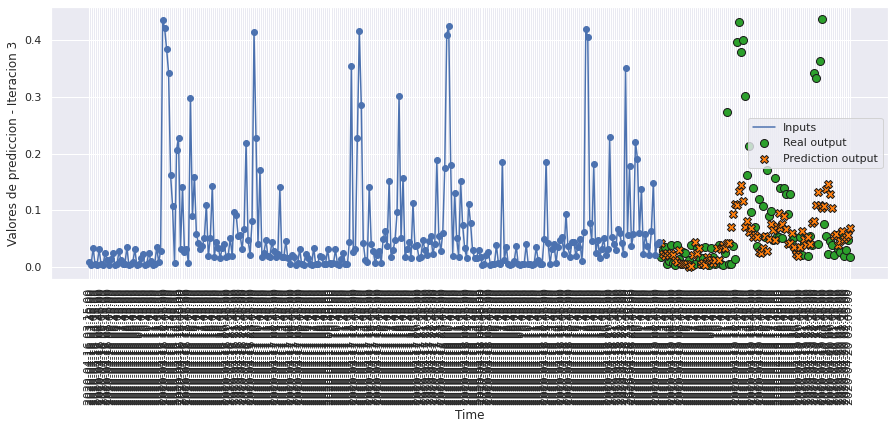

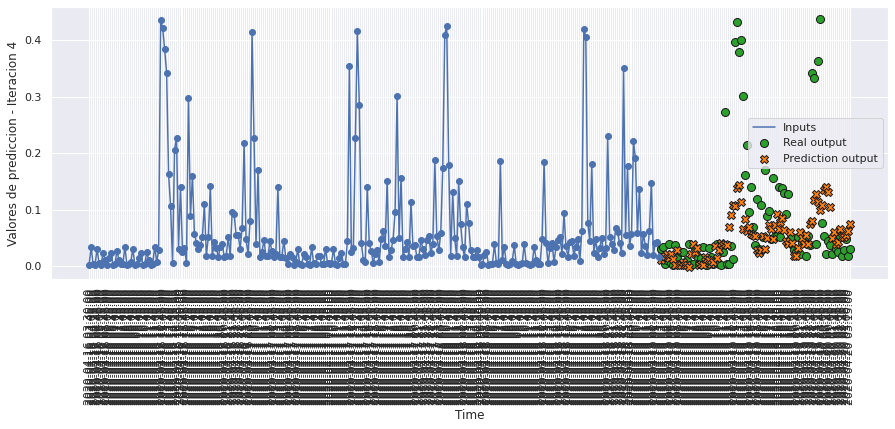

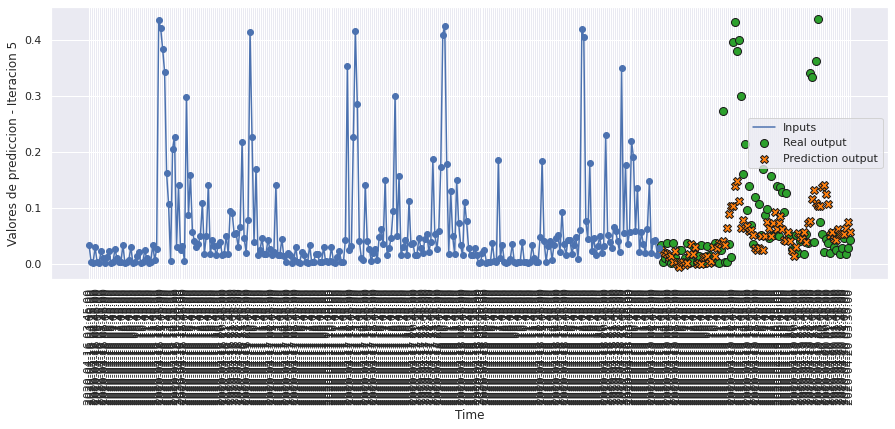

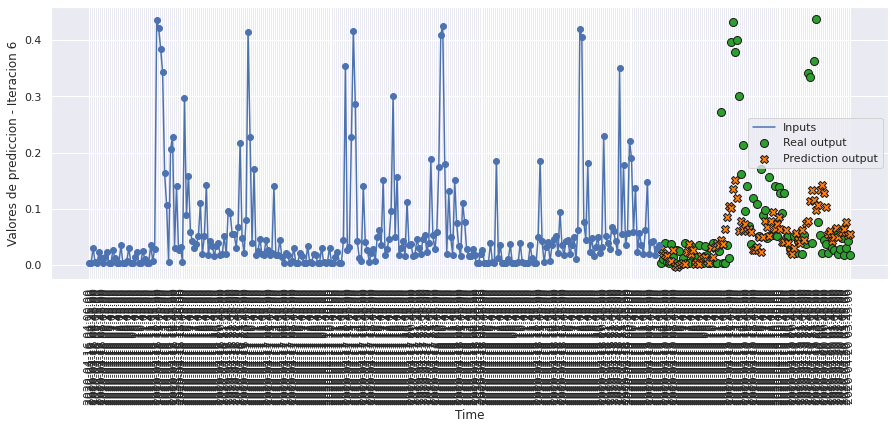

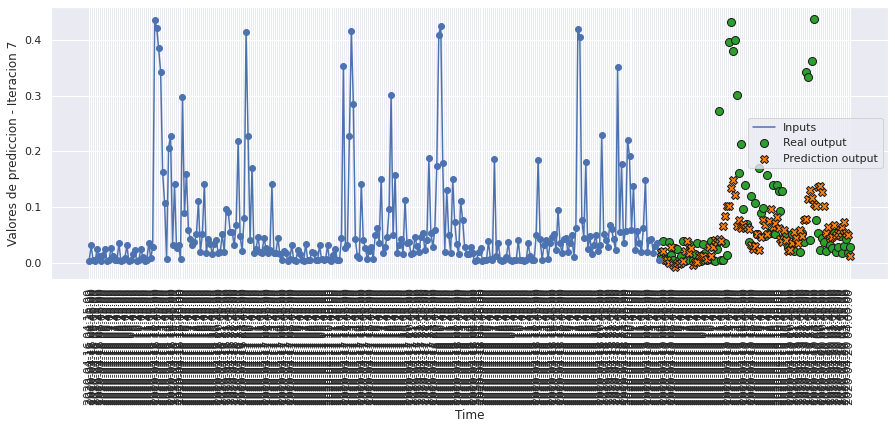

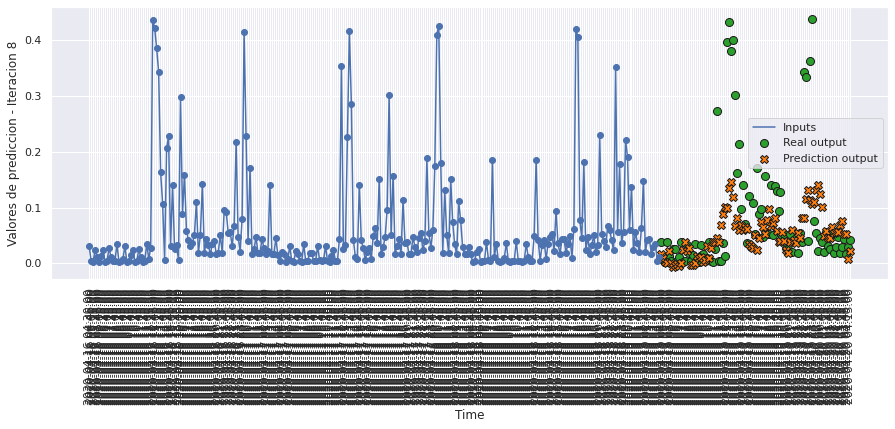

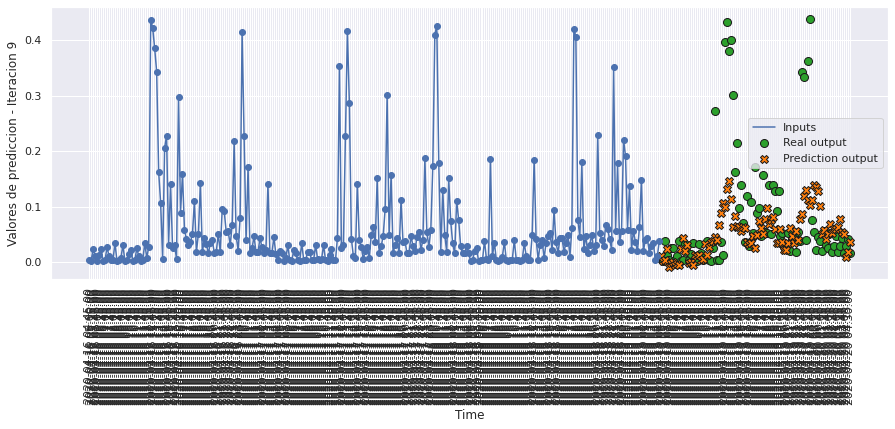

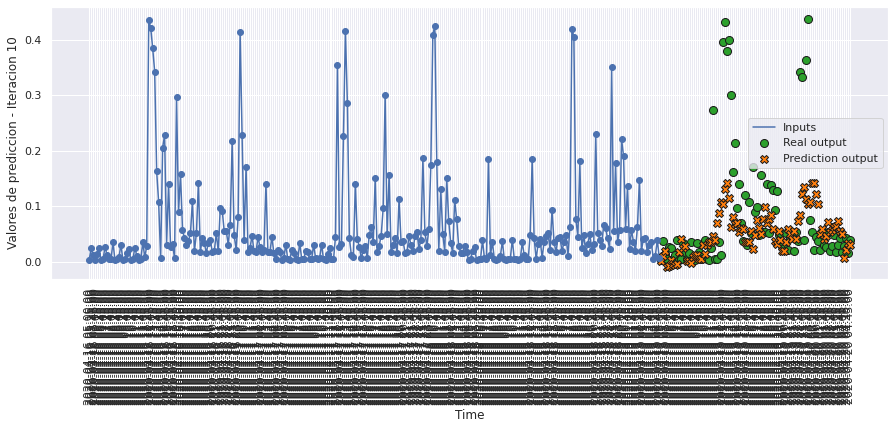

In [134]:
plot_window_predictions(int(test_df.iloc[0].name), int(test_df.iloc[-1].name), data_testY, testPredict8, 10, 0)

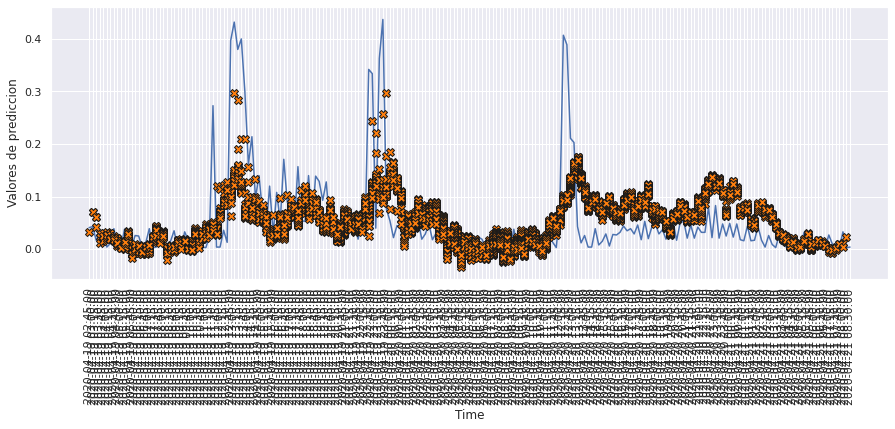

In [135]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict8, 120)

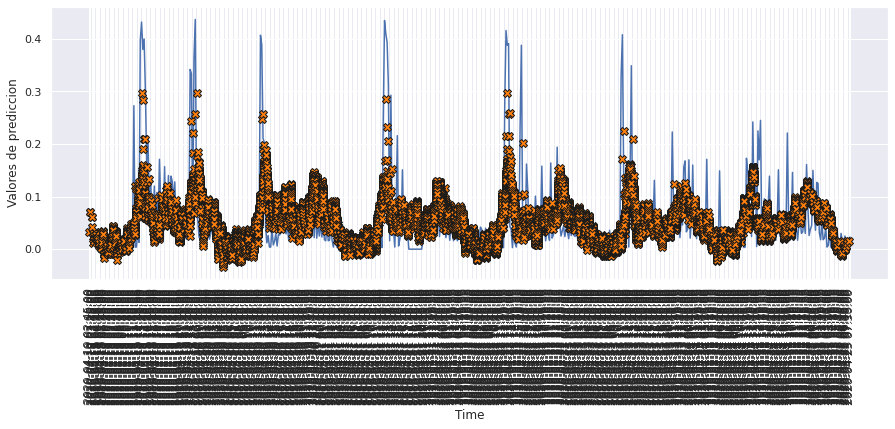

In [136]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict8, 500)

# MODELO 9: LSTM ENCODE DECODE

### Construimos el modelo

In [137]:
def build_model9():
    model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(n_entrada, n_features)),
        tf.keras.layers.LSTM(128, activation='tanh'),
        tf.keras.layers.RepeatVector(n_predicciones),
        tf.keras.layers.LSTM(128, activation='tanh', return_sequences=True),
        tf.keras.layers.TimeDistributed(tf.keras.layers.Dense(100)),
        tf.keras.layers.TimeDistributed(tf.keras.layers.Dense(1))
    ])

    optimizer = tf.keras.optimizers.Adam()

    model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', smape])

    return model

In [138]:
model9 = build_model9()
model9.summary()

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_8 (LSTM)               (None, 128)               66560     
                                                                 
 repeat_vector (RepeatVector  (None, 96, 128)          0         
 )                                                               
                                                                 
 lstm_9 (LSTM)               (None, 96, 128)           131584    
                                                                 
 time_distributed_6 (TimeDis  (None, 96, 100)          12900     
 tributed)                                                       
                                                                 
 time_distributed_7 (TimeDis  (None, 96, 1)            101       
 tributed)                                                       
                                                      

### Entrenamiento del modelo

In [139]:
history9 = model9.fit(scaled_trainX, data_trainY_3D_2, epochs=n_epochs, batch_size = batch_size, 
                    validation_data=(scaled_valX, data_valY_3D_2), verbose = 1, callbacks=[early_stop])

Epoch 1/200
351/351 [==============================] - 19s 47ms/step - loss: 0.0069 - mae: 0.0504 - mse: 0.0069 - smape: 0.8762 - val_loss: 0.0071 - val_mae: 0.0523 - val_mse: 0.0071 - val_smape: 0.9069
Epoch 2/200
351/351 [==============================] - 16s 46ms/step - loss: 0.0069 - mae: 0.0502 - mse: 0.0069 - smape: 0.8712 - val_loss: 0.0070 - val_mae: 0.0505 - val_mse: 0.0070 - val_smape: 0.8850
Epoch 3/200
351/351 [==============================] - 16s 46ms/step - loss: 0.0069 - mae: 0.0502 - mse: 0.0069 - smape: 0.8711 - val_loss: 0.0070 - val_mae: 0.0509 - val_mse: 0.0070 - val_smape: 0.8903
Epoch 4/200
351/351 [==============================] - 16s 46ms/step - loss: 0.0069 - mae: 0.0502 - mse: 0.0069 - smape: 0.8705 - val_loss: 0.0070 - val_mae: 0.0489 - val_mse: 0.0070 - val_smape: 0.8633
Epoch 5/200
351/351 [==============================] - 16s 46ms/step - loss: 0.0069 - mae: 0.0501 - mse: 0.0069 - smape: 0.8697 - val_loss: 0.0070 - val_mae: 0.0499 - val_mse: 0.0070 - val

351/351 [==============================] - 16s 46ms/step - loss: 0.0033 - mae: 0.0336 - mse: 0.0033 - smape: 0.6869 - val_loss: 0.0083 - val_mae: 0.0464 - val_mse: 0.0083 - val_smape: 0.7475
Epoch 82/200
351/351 [==============================] - 16s 46ms/step - loss: 0.0031 - mae: 0.0328 - mse: 0.0031 - smape: 0.6810 - val_loss: 0.0084 - val_mae: 0.0458 - val_mse: 0.0084 - val_smape: 0.7375
Epoch 83/200
351/351 [==============================] - 16s 45ms/step - loss: 0.0031 - mae: 0.0326 - mse: 0.0031 - smape: 0.6799 - val_loss: 0.0082 - val_mae: 0.0463 - val_mse: 0.0082 - val_smape: 0.7473
Epoch 84/200
351/351 [==============================] - 16s 46ms/step - loss: 0.0031 - mae: 0.0326 - mse: 0.0031 - smape: 0.6798 - val_loss: 0.0084 - val_mae: 0.0469 - val_mse: 0.0084 - val_smape: 0.7498
Epoch 85/200
351/351 [==============================] - 16s 45ms/step - loss: 0.0031 - mae: 0.0325 - mse: 0.0031 - smape: 0.6788 - val_loss: 0.0080 - val_mae: 0.0453 - val_mse: 0.0080 - val_smape: 

351/351 [==============================] - 16s 45ms/step - loss: 0.0031 - mae: 0.0327 - mse: 0.0031 - smape: 0.6831 - val_loss: 0.0080 - val_mae: 0.0441 - val_mse: 0.0080 - val_smape: 0.7305
Epoch 162/200
351/351 [==============================] - 15s 43ms/step - loss: 0.0031 - mae: 0.0323 - mse: 0.0031 - smape: 0.6812 - val_loss: 0.0082 - val_mae: 0.0450 - val_mse: 0.0082 - val_smape: 0.7371
Epoch 163/200
351/351 [==============================] - 15s 44ms/step - loss: 0.0030 - mae: 0.0323 - mse: 0.0030 - smape: 0.6809 - val_loss: 0.0082 - val_mae: 0.0449 - val_mse: 0.0082 - val_smape: 0.7351
Epoch 164/200
351/351 [==============================] - 16s 45ms/step - loss: 0.0030 - mae: 0.0323 - mse: 0.0030 - smape: 0.6808 - val_loss: 0.0081 - val_mae: 0.0443 - val_mse: 0.0081 - val_smape: 0.7327
Epoch 165/200
351/351 [==============================] - 15s 44ms/step - loss: 0.0031 - mae: 0.0324 - mse: 0.0031 - smape: 0.6811 - val_loss: 0.0081 - val_mae: 0.0445 - val_mse: 0.0081 - val_sma

In [140]:
hist9 = pd.DataFrame(history9.history)
hist9['epoch'] = history9.epoch
hist9

,loss,mae,mse,smape,val_loss,val_mae,val_mse,val_smape,epoch
0,0.006936,0.050438,0.006936,0.876215,0.007091,0.052290,0.007091,0.906923,0
1,0.006898,0.050242,0.006898,0.871207,0.007047,0.050487,0.007047,0.885001,1
2,0.006897,0.050206,0.006897,0.871087,0.007048,0.050867,0.007048,0.890268,2
3,0.006882,0.050163,0.006882,0.870459,0.007009,0.048871,0.007009,0.863314,3
4,0.006876,0.050102,0.006876,0.869737,0.007014,0.049899,0.007014,0.877696,4
...,...,...,...,...,...,...,...,...,...
195,0.002661,0.030556,0.002661,0.667195,0.008172,0.045127,0.008172,0.737640,195
196,0.002620,0.030352,0.002620,0.665970,0.008159,0.044435,0.008159,0.732112,196
197,0.002607,0.030291,0.002607,0.665627,0.008182,0.045420,0.008182,0.743096,197
198,0.002590,0.030214,0.002590,0.665284,0.008225,0.044873,0.008225,0.736277,198


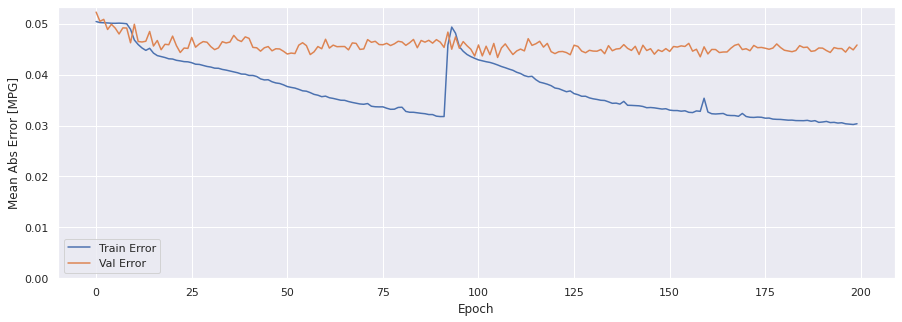

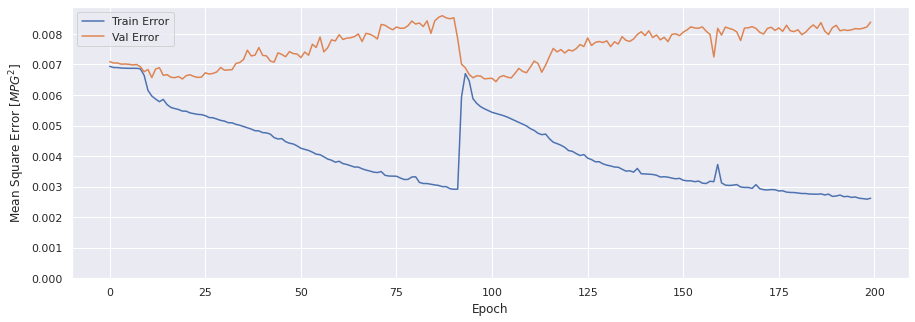

In [141]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_history(history9)

### Evaluar predicciones

In [142]:
score_train9 = model9.evaluate(scaled_trainX, data_trainY_3D_2, verbose=1)
print(f'Loss:{score_train9[0]}')
print(f'MAE:{score_train9[1]}')
print(f'MSE:{score_train9[2]}')
print(f'SMAPE:{score_train9[3]}')

1401/1401 [==============================] - 27s 19ms/step - loss: 0.0027 - mae: 0.0305 - mse: 0.0027 - smape: 0.6665
Loss:0.0026505282148718834
MAE:0.030512861907482147
MSE:0.002650525886565447
SMAPE:0.6664549708366394


In [143]:
score_val9 = model9.evaluate(scaled_valX, data_valY_3D_2, verbose=1)
print(f'Loss:{score_val9[0]}')
print(f'MAE:{score_val9[1]}')
print(f'MSE:{score_val9[2]}')
print(f'SMAPE:{score_val9[3]}')

291/291 [==============================] - 6s 19ms/step - loss: 0.0084 - mae: 0.0458 - mse: 0.0084 - smape: 0.7424
Loss:0.008383971638977528
MAE:0.0458323210477829
MSE:0.008383969776332378
SMAPE:0.7423756718635559


In [144]:
score_test9 = model9.evaluate(scaled_testX, data_testY_3D_2, verbose=1)
print(f'Loss:{score_test9[0]}')
print(f'MAE:{score_test9[1]}')
print(f'MSE:{score_test9[2]}')
print(f'SMAPE:{score_test9[3]}')

291/291 [==============================] - 6s 19ms/step - loss: 0.0077 - mae: 0.0471 - mse: 0.0077 - smape: 0.7625
Loss:0.007693913299590349
MAE:0.047072961926460266
MSE:0.007693914696574211
SMAPE:0.7625018954277039


### Comparativa de resultados

In [145]:
result = hist9.iloc[-1]
comparativa9 = pd.DataFrame(np.array([[result['mae'], result['mse'], result['smape'], math.sqrt(result['mse'])], 
                                      [result['val_mae'], result['val_mse'], result['val_smape'], math.sqrt(result['val_mse'])],
                                      [score_test9[1], score_test9[2], score_test9[3], math.sqrt(score_test9[2])]]),
                            columns = ['MAE', 'MSE', 'SMAPE', 'RMSE'],
                            index = ['ENTRENAMIENTO', 'VALIDACION', 'TEST'])

comparativa9.style.set_caption("Método de ventana de varios pasos - LSTM ENCODE DECODE")

,MAE,MSE,SMAPE,RMSE
ENTRENAMIENTO,0.030361,0.002620,0.665796,0.051182
VALIDACION,0.045832,0.008384,0.743092,0.091564
TEST,0.047073,0.007694,0.762502,0.087715


### Obtener predicciones

In [146]:
trainPredict9 = model9.predict(scaled_trainX)
testPredict9 = model9.predict(scaled_testX)

### Visualización de las predicciones

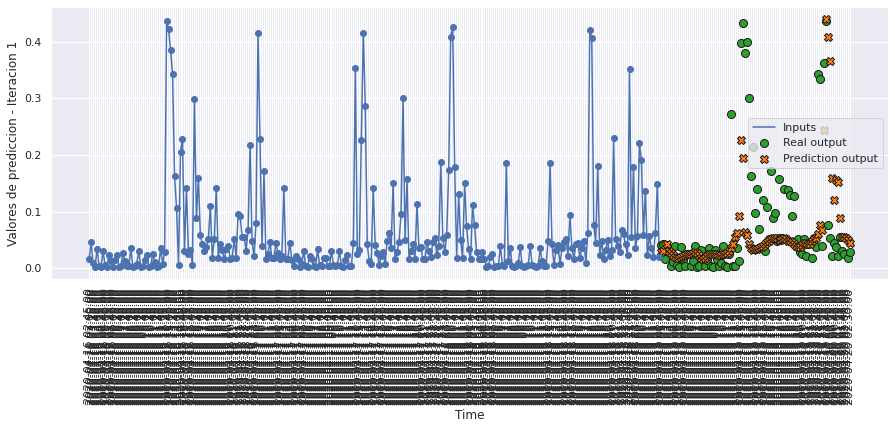

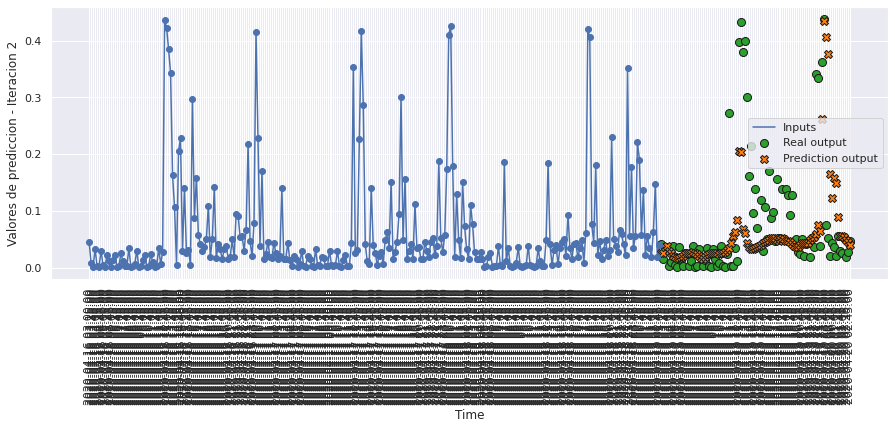

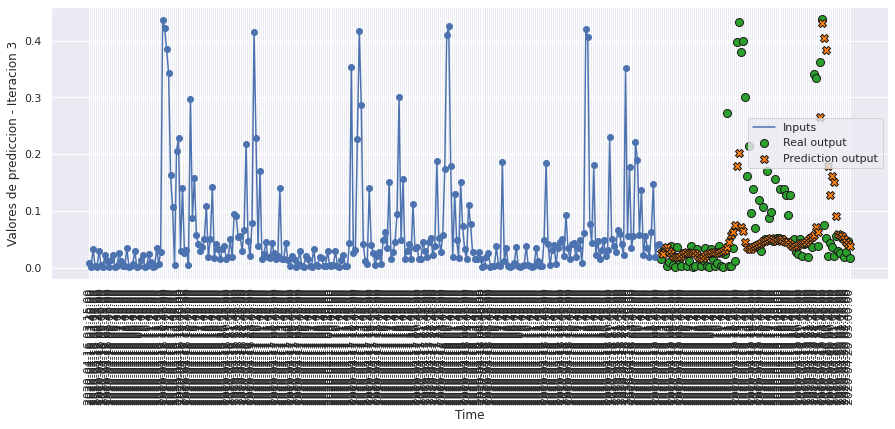

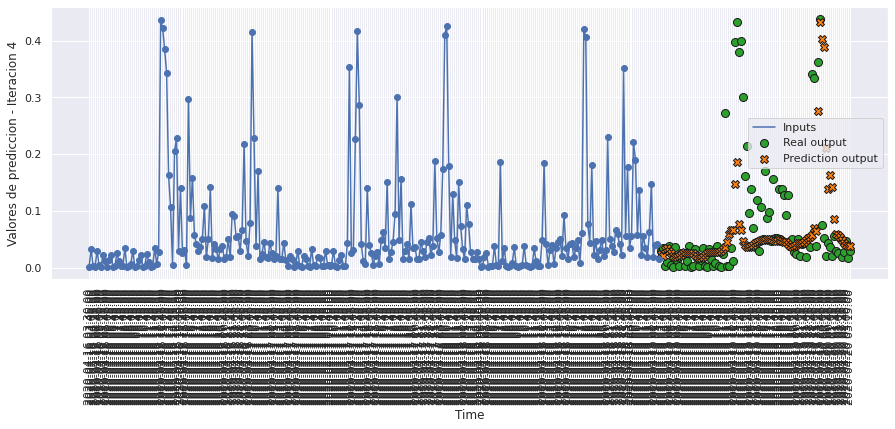

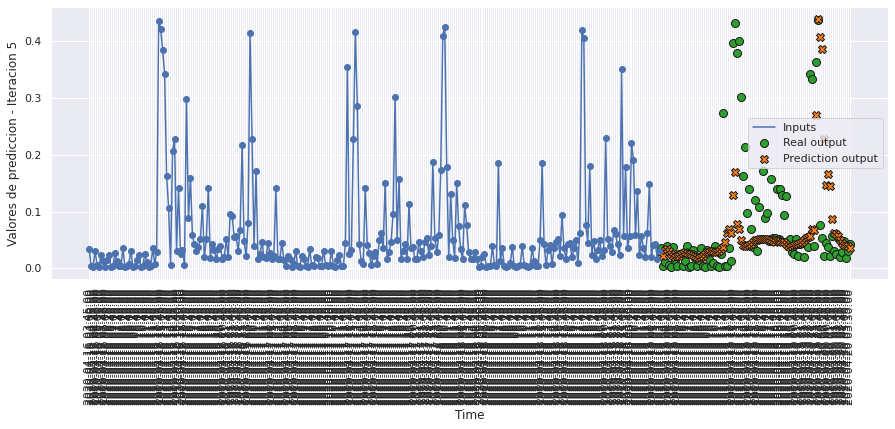

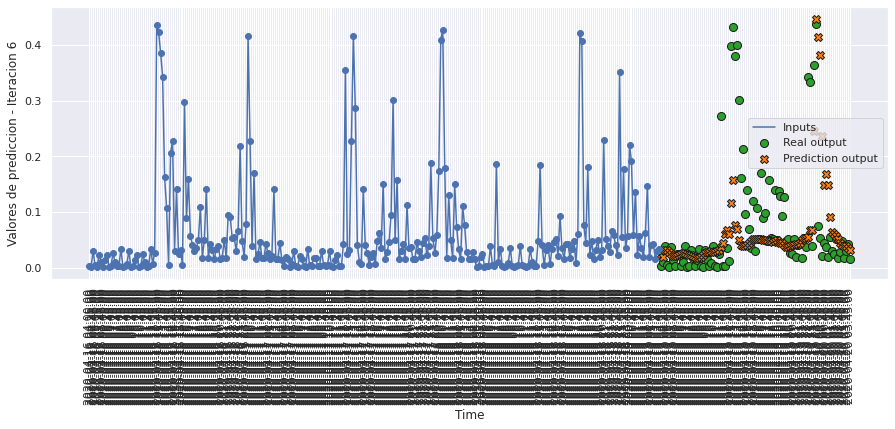

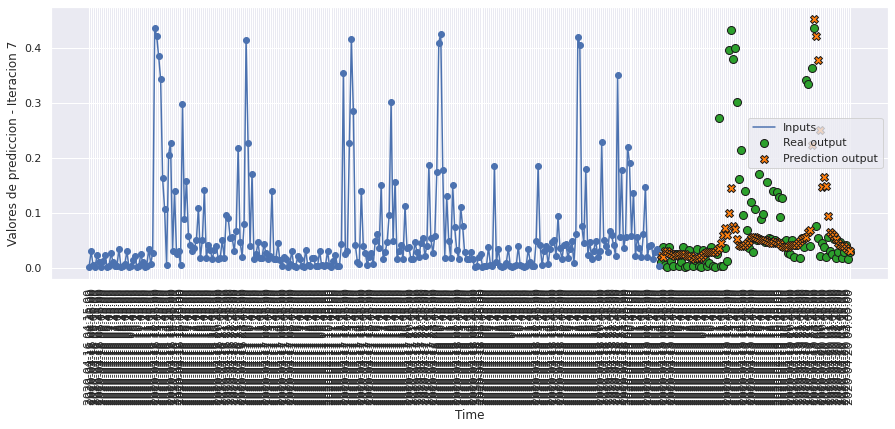

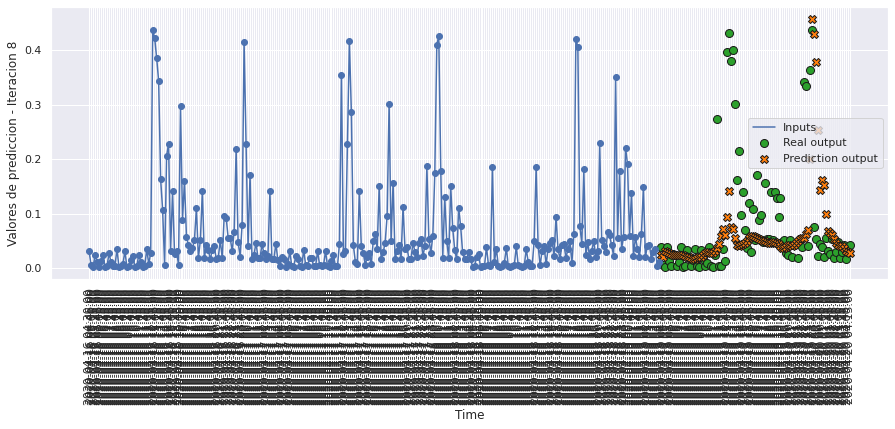

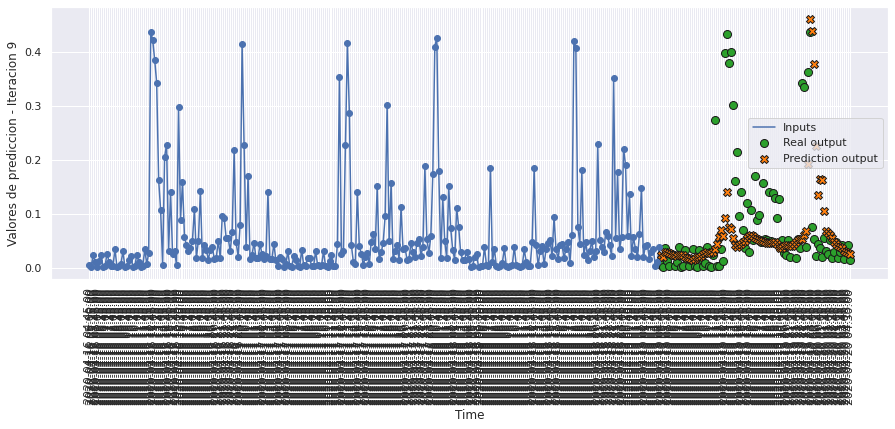

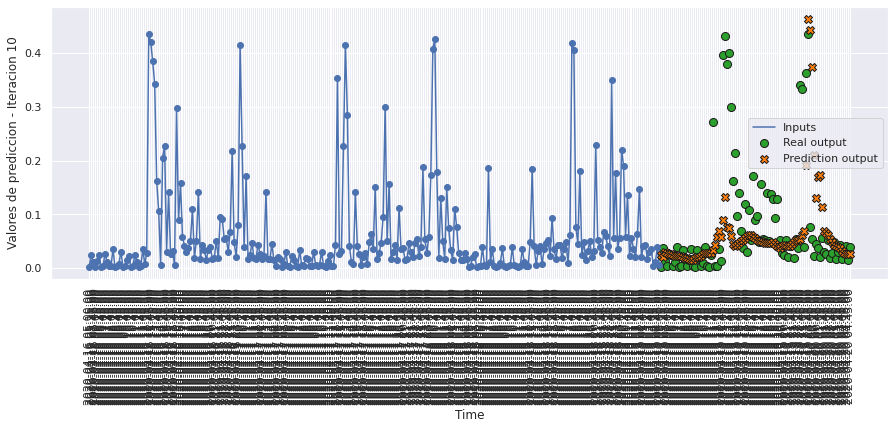

In [147]:
plot_window_predictions(int(test_df.iloc[0].name), int(test_df.iloc[-1].name), data_testY, 
                        testPredict9.reshape(testPredict9.shape[0],n_predicciones), 10, 0)

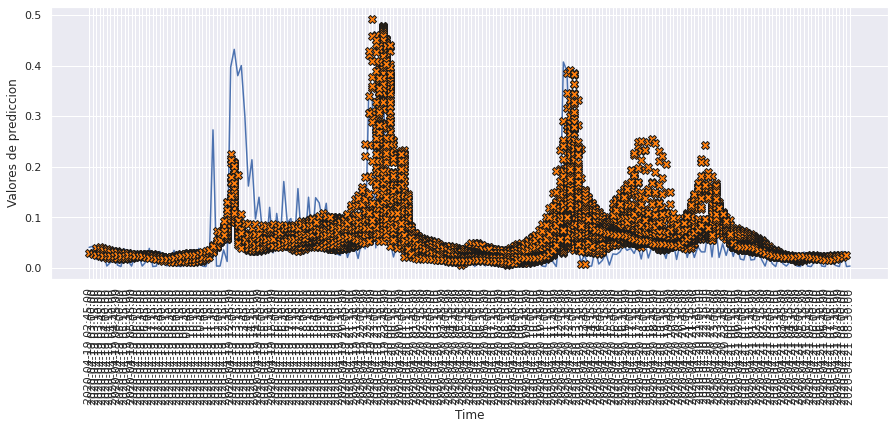

In [148]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_window_predictions_values(int(test_df.iloc[0].name), 
                        testPredict9.reshape(testPredict9.shape[0],n_predicciones), 120)

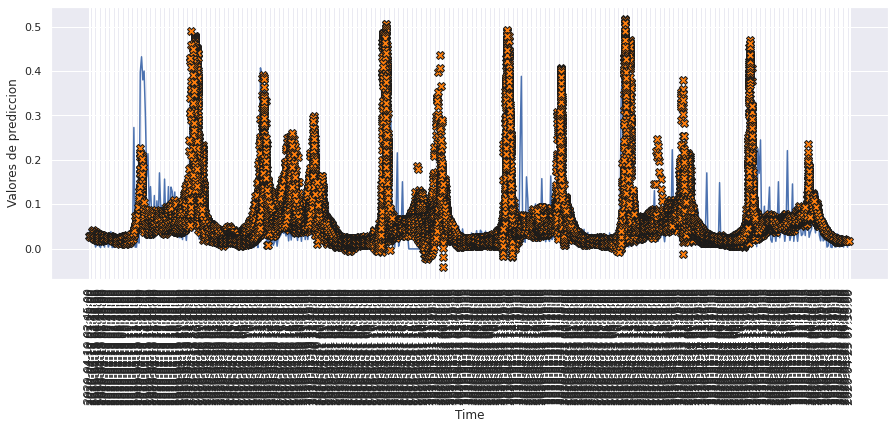

In [149]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_window_predictions_values(int(test_df.iloc[0].name), 
                        testPredict9.reshape(testPredict9.shape[0],n_predicciones), 500)

# MODELO 10: GRU UNA CAPA

### Construimos el modelo

In [150]:
def build_model10():
    model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(n_entrada, n_features)),
        tf.keras.layers.GRU(128, activation='tanh'),
        tf.keras.layers.Dense(n_predicciones)
    ])

    optimizer = tf.keras.optimizers.Adam()

    model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', smape])

    return model

In [151]:
model10 = build_model10()
model10.summary()

Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru (GRU)                   (None, 128)               50304     
                                                                 
 dense_10 (Dense)            (None, 96)                12384     
                                                                 
Total params: 62,688
Trainable params: 62,688
Non-trainable params: 0
_________________________________________________________________


### Entrenamiento del modelo

In [152]:
history10 = model10.fit(scaled_trainX, data_trainY, epochs=n_epochs, batch_size = batch_size, 
                    validation_data=(scaled_valX, data_valY), verbose = 1, callbacks=[early_stop])

Epoch 1/200
351/351 [==============================] - 13s 34ms/step - loss: 0.0067 - mae: 0.0489 - mse: 0.0067 - smape: 0.8614 - val_loss: 0.0067 - val_mae: 0.0490 - val_mse: 0.0067 - val_smape: 0.8609
Epoch 2/200
351/351 [==============================] - 12s 33ms/step - loss: 0.0063 - mae: 0.0472 - mse: 0.0063 - smape: 0.8387 - val_loss: 0.0067 - val_mae: 0.0488 - val_mse: 0.0067 - val_smape: 0.8667
Epoch 3/200
351/351 [==============================] - 12s 34ms/step - loss: 0.0060 - mae: 0.0465 - mse: 0.0060 - smape: 0.8204 - val_loss: 0.0066 - val_mae: 0.0472 - val_mse: 0.0066 - val_smape: 0.8271
Epoch 4/200
351/351 [==============================] - 12s 33ms/step - loss: 0.0059 - mae: 0.0459 - mse: 0.0059 - smape: 0.8077 - val_loss: 0.0064 - val_mae: 0.0454 - val_mse: 0.0064 - val_smape: 0.7991
Epoch 5/200
351/351 [==============================] - 12s 33ms/step - loss: 0.0058 - mae: 0.0456 - mse: 0.0058 - smape: 0.8043 - val_loss: 0.0065 - val_mae: 0.0471 - val_mse: 0.0065 - val

351/351 [==============================] - 12s 34ms/step - loss: 0.0041 - mae: 0.0381 - mse: 0.0041 - smape: 0.7513 - val_loss: 0.0077 - val_mae: 0.0458 - val_mse: 0.0077 - val_smape: 0.7978
Epoch 82/200
351/351 [==============================] - 12s 34ms/step - loss: 0.0040 - mae: 0.0380 - mse: 0.0040 - smape: 0.7512 - val_loss: 0.0079 - val_mae: 0.0467 - val_mse: 0.0079 - val_smape: 0.8049
Epoch 83/200
351/351 [==============================] - 12s 33ms/step - loss: 0.0040 - mae: 0.0380 - mse: 0.0040 - smape: 0.7505 - val_loss: 0.0077 - val_mae: 0.0460 - val_mse: 0.0077 - val_smape: 0.8009
Epoch 84/200
351/351 [==============================] - 12s 34ms/step - loss: 0.0040 - mae: 0.0378 - mse: 0.0040 - smape: 0.7504 - val_loss: 0.0078 - val_mae: 0.0464 - val_mse: 0.0078 - val_smape: 0.8047
Epoch 85/200
351/351 [==============================] - 12s 34ms/step - loss: 0.0040 - mae: 0.0378 - mse: 0.0040 - smape: 0.7509 - val_loss: 0.0078 - val_mae: 0.0465 - val_mse: 0.0078 - val_smape: 

In [153]:
hist10 = pd.DataFrame(history10.history)
hist10['epoch'] = history10.epoch
hist10

,loss,mae,mse,smape,val_loss,val_mae,val_mse,val_smape,epoch
0,0.006712,0.048881,0.006712,0.861359,0.006735,0.049039,0.006735,0.860893,0
1,0.006251,0.047238,0.006251,0.838660,0.006709,0.048840,0.006709,0.866718,1
2,0.006048,0.046475,0.006048,0.820421,0.006617,0.047227,0.006617,0.827063,2
3,0.005916,0.045883,0.005916,0.807701,0.006445,0.045431,0.006445,0.799094,3
4,0.005849,0.045599,0.005849,0.804277,0.006509,0.047084,0.006509,0.813766,4
...,...,...,...,...,...,...,...,...,...
107,0.003689,0.036676,0.003689,0.747550,0.007523,0.044379,0.007523,0.788319,107
108,0.003675,0.036633,0.003675,0.747443,0.007967,0.046658,0.007967,0.809572,108
109,0.003678,0.036645,0.003678,0.747785,0.007693,0.045541,0.007693,0.797069,109
110,0.003644,0.036520,0.003644,0.747627,0.007745,0.045374,0.007745,0.791888,110


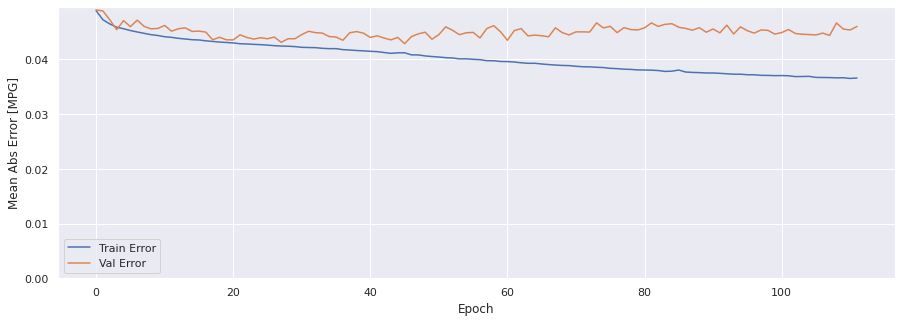

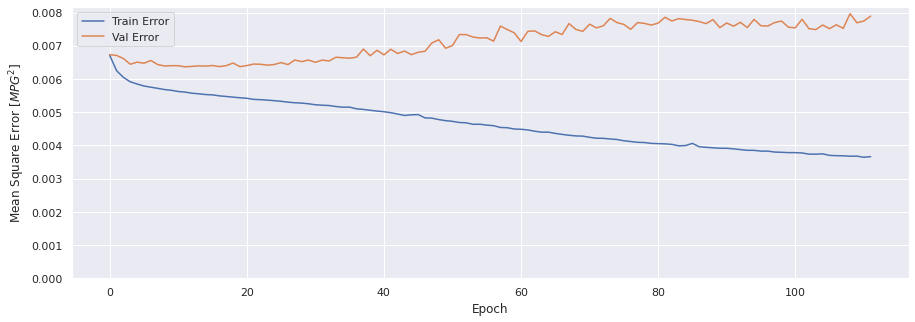

In [154]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_history(history10)

### Evaluar predicciones

In [155]:
score_train10 = model10.evaluate(scaled_trainX, data_trainY, verbose=1)
print(f'Loss:{score_train10[0]}')
print(f'MAE:{score_train10[1]}')
print(f'MSE:{score_train10[2]}')
print(f'SMAPE:{score_train10[3]}')

1401/1401 [==============================] - 17s 12ms/step - loss: 0.0037 - mae: 0.0367 - mse: 0.0037 - smape: 0.7525
Loss:0.0036797935608774424
MAE:0.03666534647345543
MSE:0.0036797935608774424
SMAPE:0.752454936504364


In [156]:
score_val10 = model10.evaluate(scaled_valX, data_valY, verbose=1)
print(f'Loss:{score_val10[0]}')
print(f'MAE:{score_val10[1]}')
print(f'MSE:{score_val10[2]}')
print(f'SMAPE:{score_val10[3]}')

291/291 [==============================] - 4s 12ms/step - loss: 0.0079 - mae: 0.0460 - mse: 0.0079 - smape: 0.8007
Loss:0.007892884314060211
MAE:0.0460226908326149
MSE:0.007892884314060211
SMAPE:0.8006944060325623


In [157]:
score_test10 = model10.evaluate(scaled_testX, data_testY, verbose=1)
print(f'Loss:{score_test10[0]}')
print(f'MAE:{score_test10[1]}')
print(f'MSE:{score_test10[2]}')
print(f'SMAPE:{score_test10[3]}')

291/291 [==============================] - 4s 12ms/step - loss: 0.0078 - mae: 0.0486 - mse: 0.0078 - smape: 0.8228
Loss:0.007795230019837618
MAE:0.04860302433371544
MSE:0.007795230019837618
SMAPE:0.822847843170166


### Comparativa de resultados

In [158]:
result = hist10.iloc[-1]
comparativa10 = pd.DataFrame(np.array([[result['mae'], result['mse'], result['smape'], math.sqrt(result['mse'])], 
                                      [result['val_mae'], result['val_mse'], result['val_smape'], math.sqrt(result['val_mse'])],
                                      [score_test10[1], score_test10[2], score_test10[3], math.sqrt(score_test10[2])]]),
                            columns = ['MAE', 'MSE', 'SMAPE', 'RMSE'],
                            index = ['ENTRENAMIENTO', 'VALIDACION', 'TEST'])

comparativa10.style.set_caption("Método de ventana de varios pasos - GRU una capa")

,MAE,MSE,SMAPE,RMSE
ENTRENAMIENTO,0.036596,0.003664,0.747479,0.060528
VALIDACION,0.046023,0.007893,0.801386,0.088842
TEST,0.048603,0.007795,0.822848,0.088291


### Obtener predicciones

In [159]:
trainPredict10 = model10.predict(scaled_trainX)
testPredict10 = model10.predict(scaled_testX)

### Visualización de las predicciones

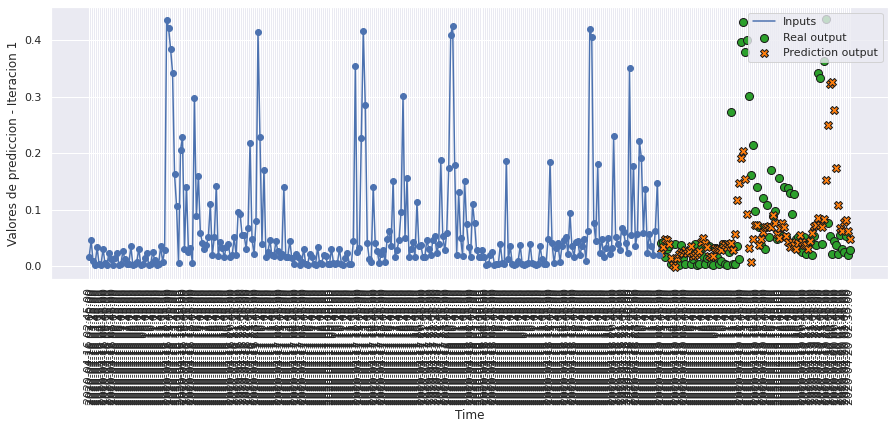

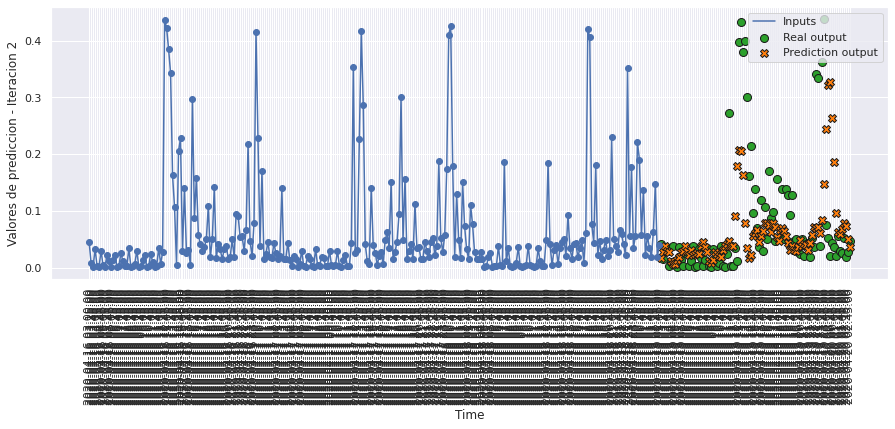

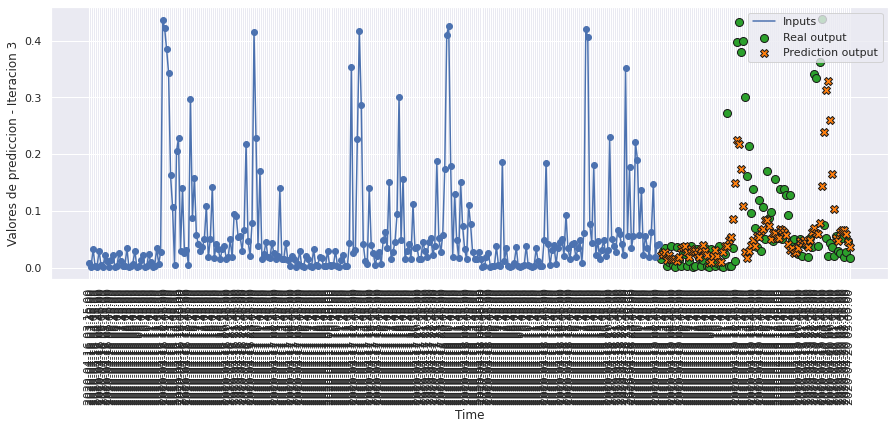

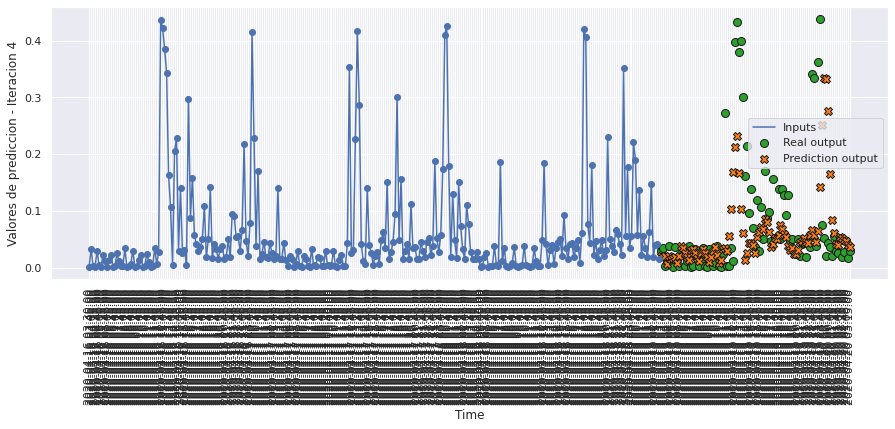

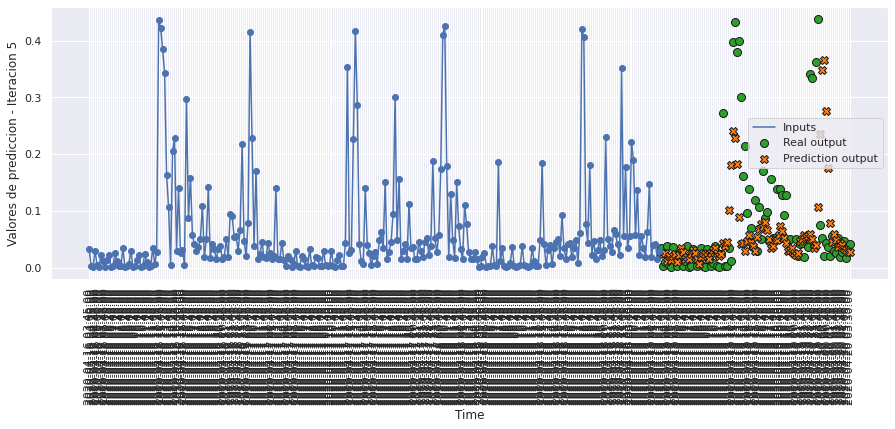

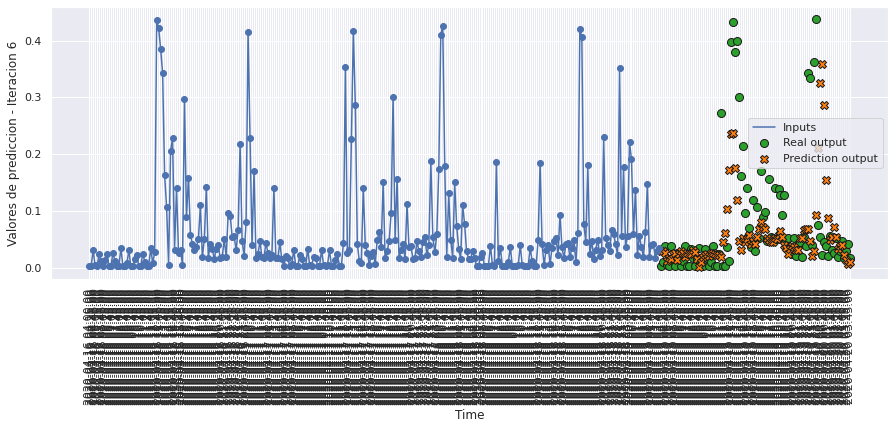

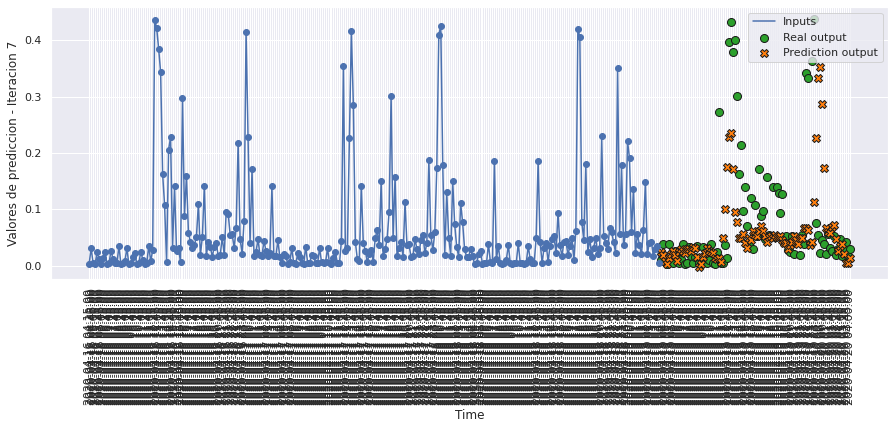

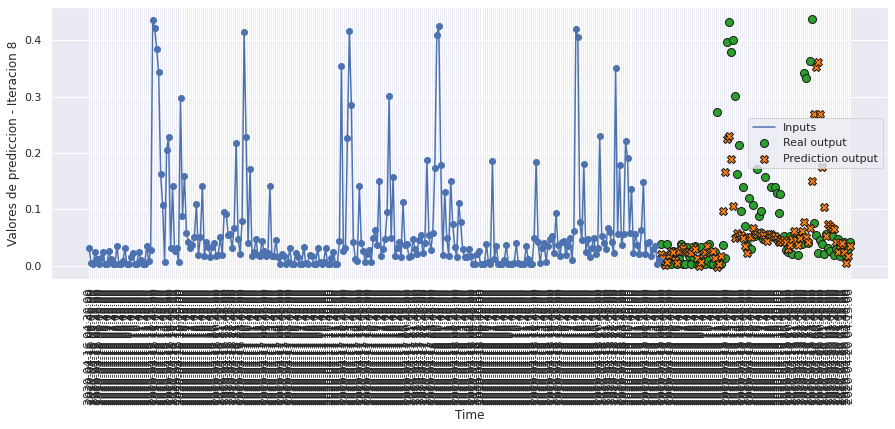

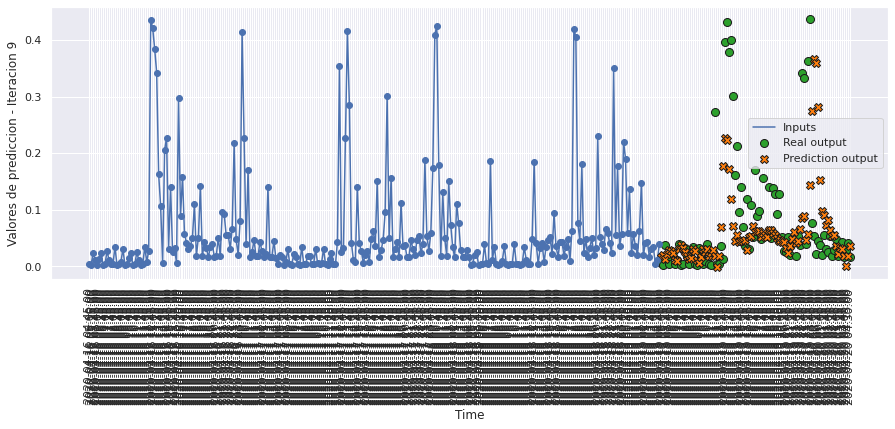

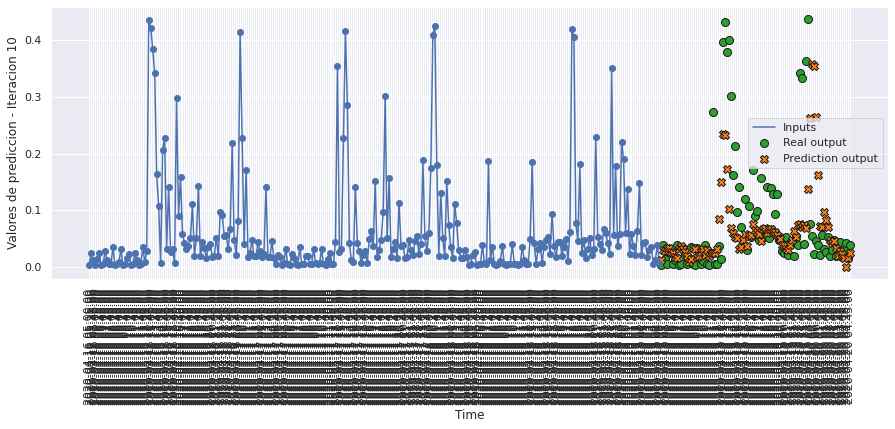

In [160]:
plot_window_predictions(int(test_df.iloc[0].name), int(test_df.iloc[-1].name), data_testY, testPredict10, 10, 0)

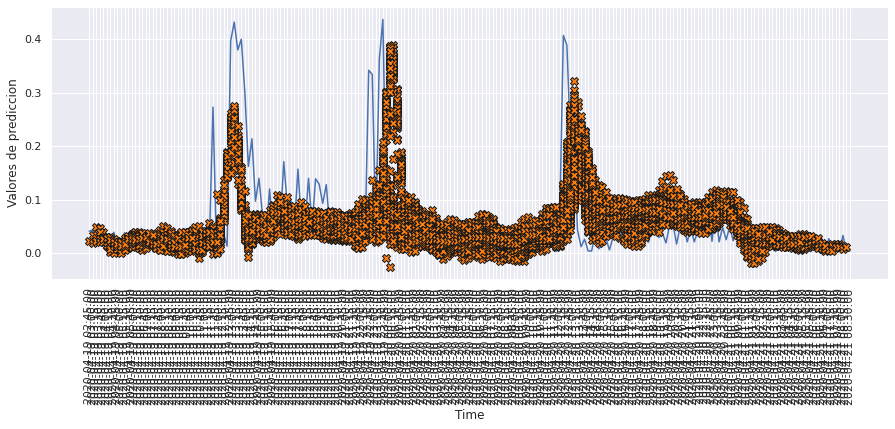

In [161]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict10, 120)

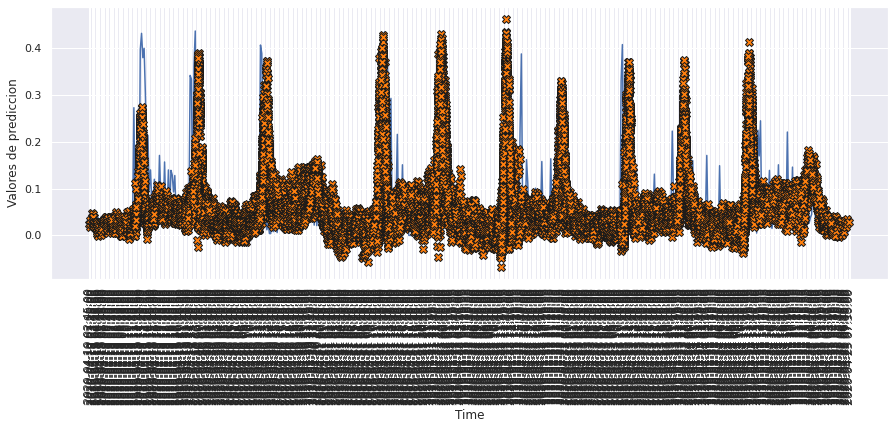

In [162]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict10, 500)

# MODELO 11: GRU DOS CAPAS

### Construimos el modelo

In [163]:
def build_model11():
    model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(n_entrada, n_features)),
        tf.keras.layers.GRU(128, activation='tanh', return_sequences=True),
        tf.keras.layers.GRU(128, activation='tanh'),
        tf.keras.layers.Dense(n_predicciones)
    ])

    optimizer = tf.keras.optimizers.Adam()

    model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', smape])

    return model

In [164]:
model11 = build_model11()
model11.summary()

Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_1 (GRU)                 (None, 288, 128)          50304     
                                                                 
 gru_2 (GRU)                 (None, 128)               99072     
                                                                 
 dense_11 (Dense)            (None, 96)                12384     
                                                                 
Total params: 161,760
Trainable params: 161,760
Non-trainable params: 0
_________________________________________________________________


### Entrenamiento del modelo

In [165]:
history11 = model11.fit(scaled_trainX, data_trainY, epochs=n_epochs, batch_size = batch_size, 
                    validation_data=(scaled_valX, data_valY), verbose = 1, callbacks=[early_stop])

Epoch 1/200
351/351 [==============================] - 25s 64ms/step - loss: 0.0067 - mae: 0.0491 - mse: 0.0067 - smape: 0.8608 - val_loss: 0.0067 - val_mae: 0.0490 - val_mse: 0.0067 - val_smape: 0.8503
Epoch 2/200
351/351 [==============================] - 22s 63ms/step - loss: 0.0062 - mae: 0.0471 - mse: 0.0062 - smape: 0.8381 - val_loss: 0.0065 - val_mae: 0.0447 - val_mse: 0.0065 - val_smape: 0.7908
Epoch 3/200
351/351 [==============================] - 22s 63ms/step - loss: 0.0060 - mae: 0.0463 - mse: 0.0060 - smape: 0.8199 - val_loss: 0.0068 - val_mae: 0.0481 - val_mse: 0.0068 - val_smape: 0.8326
Epoch 4/200
351/351 [==============================] - 22s 64ms/step - loss: 0.0059 - mae: 0.0458 - mse: 0.0059 - smape: 0.8132 - val_loss: 0.0066 - val_mae: 0.0457 - val_mse: 0.0066 - val_smape: 0.7957
Epoch 5/200
351/351 [==============================] - 22s 63ms/step - loss: 0.0058 - mae: 0.0453 - mse: 0.0058 - smape: 0.8009 - val_loss: 0.0065 - val_mae: 0.0459 - val_mse: 0.0065 - val

351/351 [==============================] - 21s 60ms/step - loss: 0.0025 - mae: 0.0317 - mse: 0.0025 - smape: 0.7201 - val_loss: 0.0078 - val_mae: 0.0450 - val_mse: 0.0078 - val_smape: 0.7820
Epoch 82/200
351/351 [==============================] - 21s 59ms/step - loss: 0.0025 - mae: 0.0316 - mse: 0.0025 - smape: 0.7193 - val_loss: 0.0077 - val_mae: 0.0449 - val_mse: 0.0077 - val_smape: 0.7773
Epoch 83/200
351/351 [==============================] - 22s 62ms/step - loss: 0.0025 - mae: 0.0315 - mse: 0.0025 - smape: 0.7186 - val_loss: 0.0078 - val_mae: 0.0449 - val_mse: 0.0078 - val_smape: 0.7911
Epoch 84/200
351/351 [==============================] - 22s 64ms/step - loss: 0.0025 - mae: 0.0315 - mse: 0.0025 - smape: 0.7190 - val_loss: 0.0078 - val_mae: 0.0450 - val_mse: 0.0078 - val_smape: 0.7794
Epoch 85/200
351/351 [==============================] - 22s 63ms/step - loss: 0.0024 - mae: 0.0313 - mse: 0.0024 - smape: 0.7165 - val_loss: 0.0078 - val_mae: 0.0450 - val_mse: 0.0078 - val_smape: 

In [166]:
hist11 = pd.DataFrame(history11.history)
hist11['epoch'] = history11.epoch
hist11

,loss,mae,mse,smape,val_loss,val_mae,val_mse,val_smape,epoch
0,0.006716,0.049065,0.006716,0.860784,0.006745,0.049029,0.006745,0.850274,0
1,0.006164,0.047080,0.006164,0.838125,0.006514,0.044725,0.006514,0.790819,1
2,0.006004,0.046281,0.006004,0.819867,0.006814,0.048085,0.006814,0.832613,2
3,0.005875,0.045787,0.005875,0.813193,0.006586,0.045716,0.006586,0.795654,3
4,0.005800,0.045305,0.005800,0.800896,0.006465,0.045883,0.006465,0.794242,4
...,...,...,...,...,...,...,...,...,...
105,0.002144,0.029699,0.002144,0.704069,0.007928,0.044556,0.007928,0.779066,105
106,0.002122,0.029577,0.002122,0.703344,0.007894,0.045028,0.007894,0.778529,106
107,0.002111,0.029527,0.002111,0.703052,0.007983,0.045353,0.007983,0.782227,107
108,0.002090,0.029409,0.002090,0.702198,0.007967,0.045509,0.007967,0.781787,108


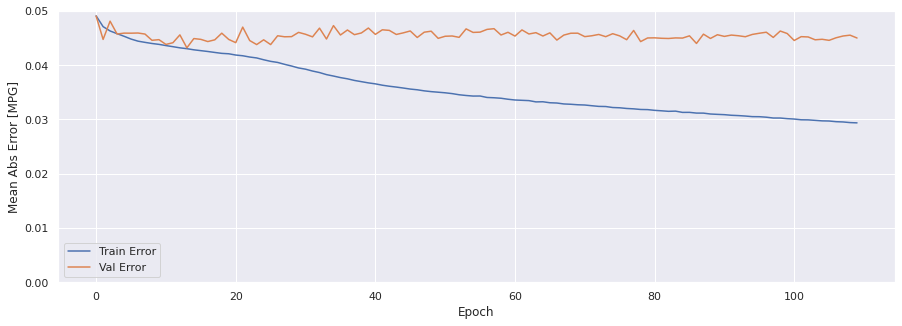

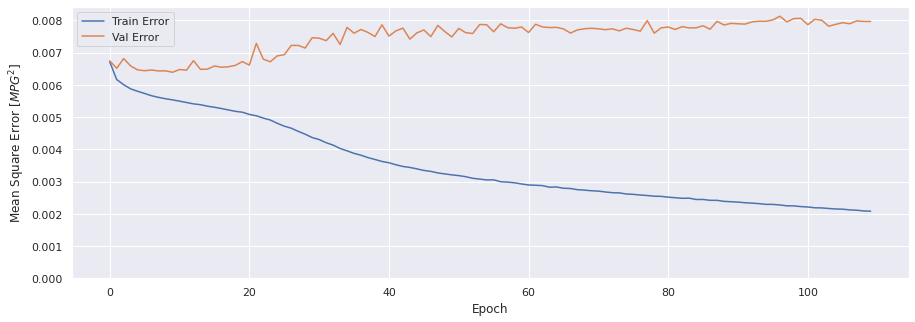

In [167]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_history(history11)

### Evaluar predicciones

In [168]:
score_train11 = model11.evaluate(scaled_trainX, data_trainY, verbose=1)
print(f'Loss:{score_train11[0]}')
print(f'MAE:{score_train11[1]}')
print(f'MSE:{score_train11[2]}')
print(f'SMAPE:{score_train11[3]}')

1401/1401 [==============================] - 30s 21ms/step - loss: 0.0021 - mae: 0.0293 - mse: 0.0021 - smape: 0.6962
Loss:0.002068289089947939
MAE:0.029293915256857872
MSE:0.002068289089947939
SMAPE:0.6961636543273926


In [169]:
score_val11 = model11.evaluate(scaled_valX, data_valY, verbose=1)
print(f'Loss:{score_val11[0]}')
print(f'MAE:{score_val11[1]}')
print(f'MSE:{score_val11[2]}')
print(f'SMAPE:{score_val11[3]}')

291/291 [==============================] - 6s 21ms/step - loss: 0.0080 - mae: 0.0450 - mse: 0.0080 - smape: 0.7756
Loss:0.007966593839228153
MAE:0.044984545558691025
MSE:0.007966593839228153
SMAPE:0.7756342887878418


In [170]:
score_test11 = model11.evaluate(scaled_testX, data_testY, verbose=1)
print(f'Loss:{score_test11[0]}')
print(f'MAE:{score_test11[1]}')
print(f'MSE:{score_test11[2]}')
print(f'SMAPE:{score_test11[3]}')

291/291 [==============================] - 6s 21ms/step - loss: 0.0075 - mae: 0.0468 - mse: 0.0075 - smape: 0.7932
Loss:0.007457887288182974
MAE:0.046824175864458084
MSE:0.007457887288182974
SMAPE:0.7931718826293945


### Comparativa de resultados

In [171]:
result = hist11.iloc[-1]
comparativa11 = pd.DataFrame(np.array([[result['mae'], result['mse'], result['smape'], math.sqrt(result['mse'])], 
                                      [result['val_mae'], result['val_mse'], result['val_smape'], math.sqrt(result['val_mse'])],
                                      [score_test11[1], score_test11[2], score_test11[3], math.sqrt(score_test11[2])]]),
                            columns = ['MAE', 'MSE', 'SMAPE', 'RMSE'],
                            index = ['ENTRENAMIENTO', 'VALIDACION', 'TEST'])

comparativa11.style.set_caption("Método de ventana de varios pasos - GRU dos capas")

,MAE,MSE,SMAPE,RMSE
ENTRENAMIENTO,0.029359,0.002081,0.701724,0.045619
VALIDACION,0.044985,0.007967,0.776233,0.089256
TEST,0.046824,0.007458,0.793172,0.086359


### Obtener predicciones

In [172]:
trainPredict11 = model11.predict(scaled_trainX)
testPredict11 = model11.predict(scaled_testX)

### Visualización de las predicciones

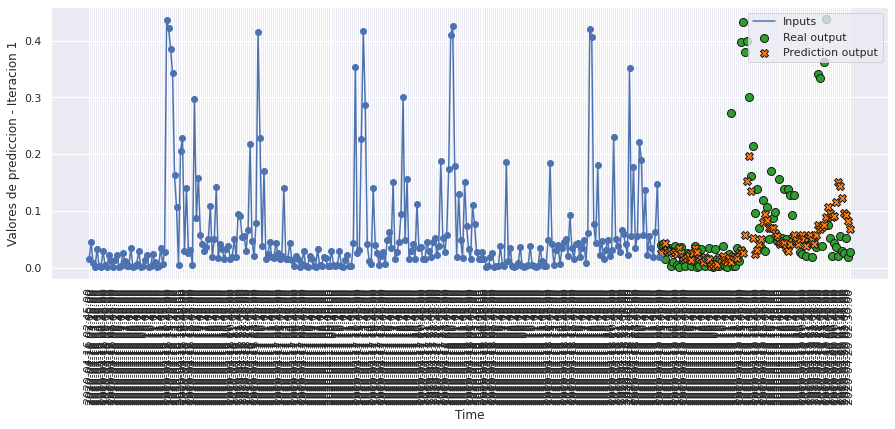

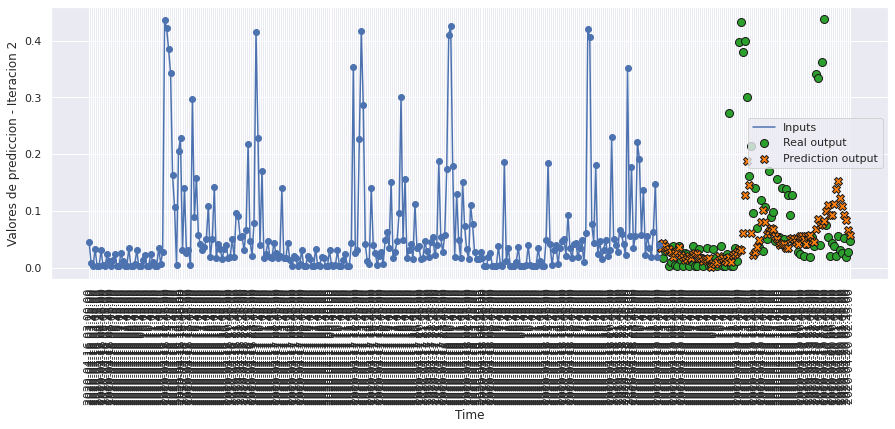

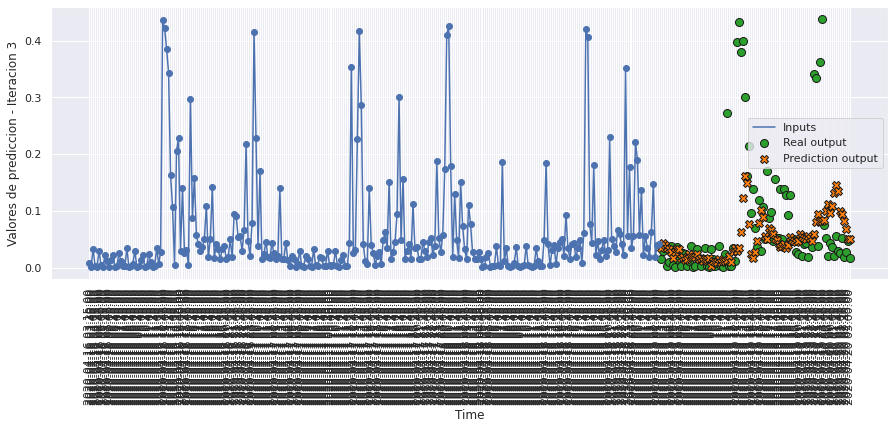

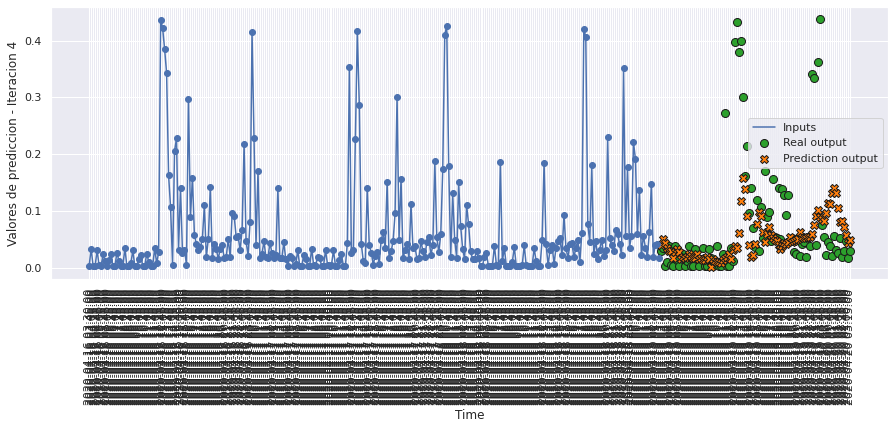

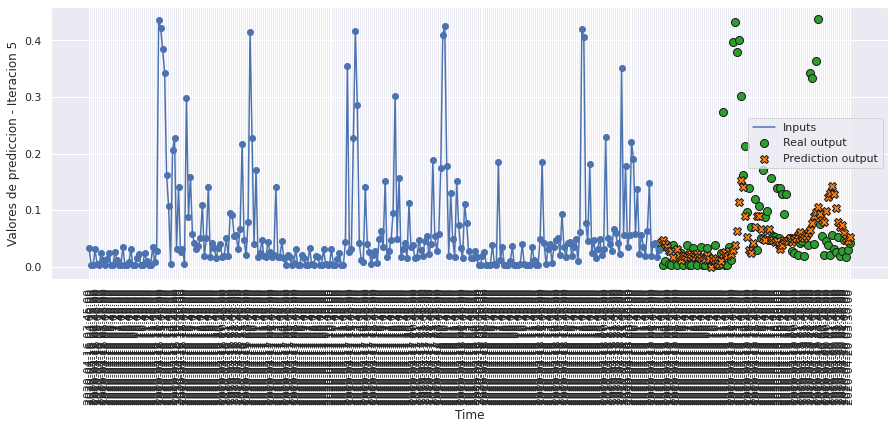

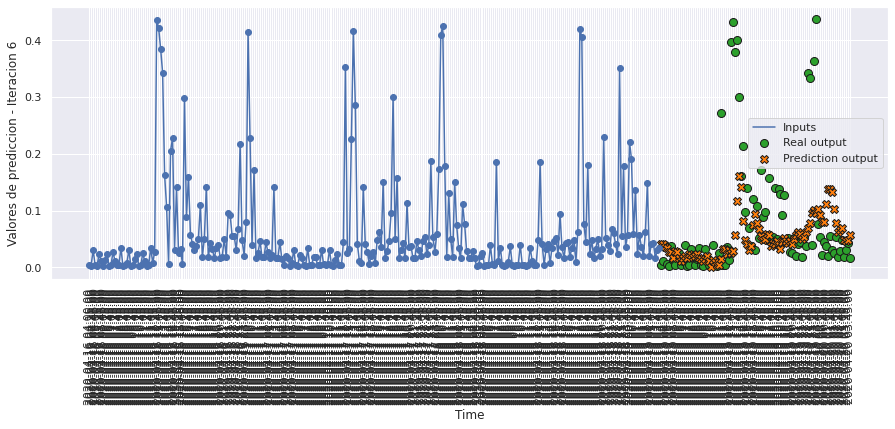

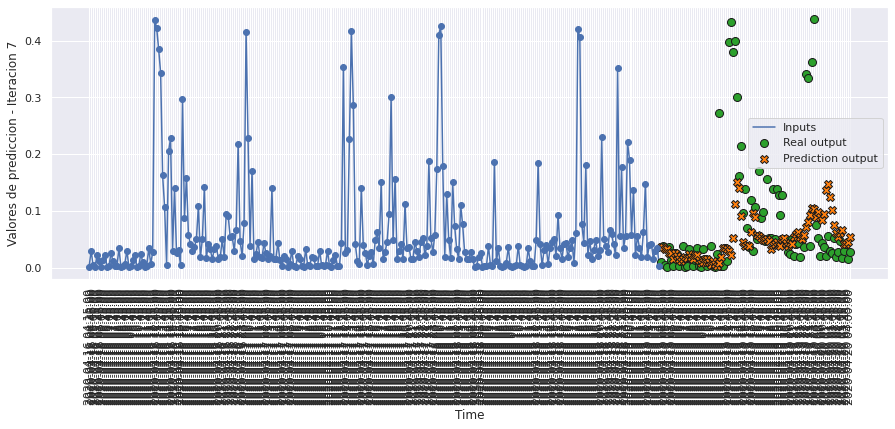

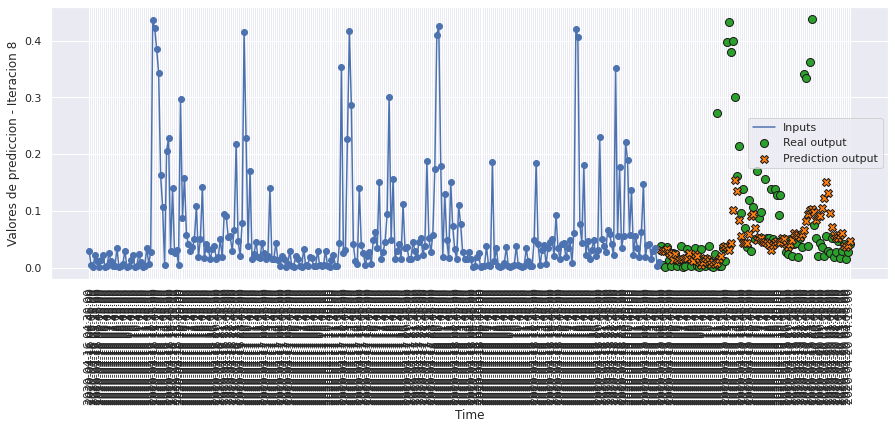

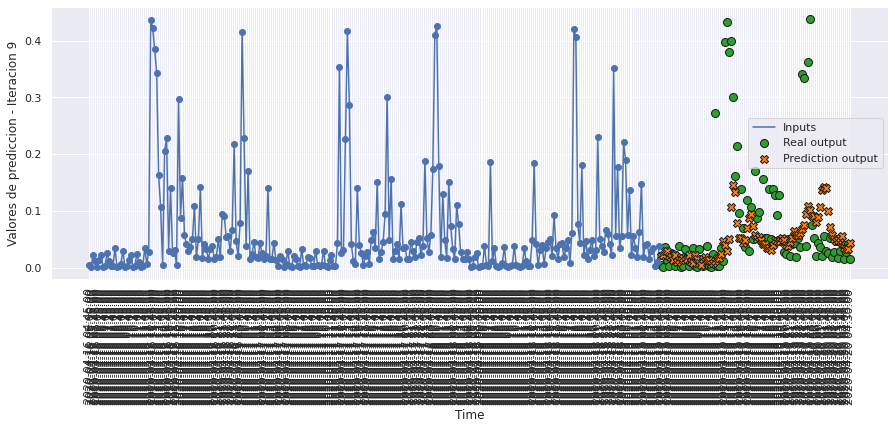

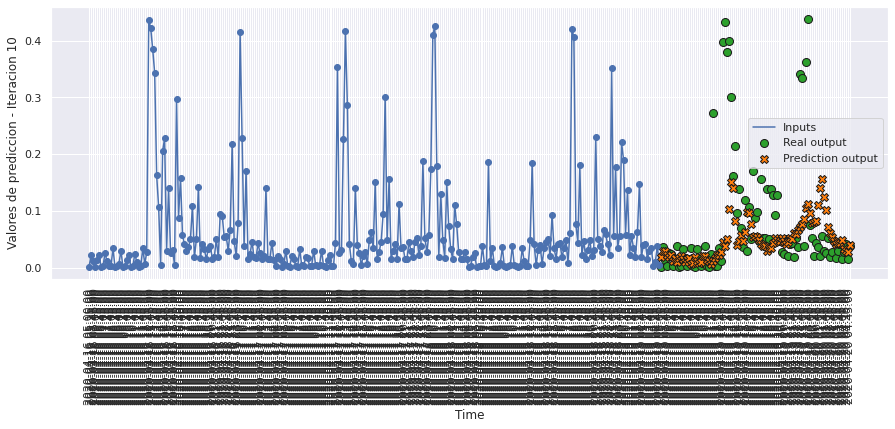

In [173]:
plot_window_predictions(int(test_df.iloc[0].name), int(test_df.iloc[-1].name), data_testY, testPredict11, 10, 0)

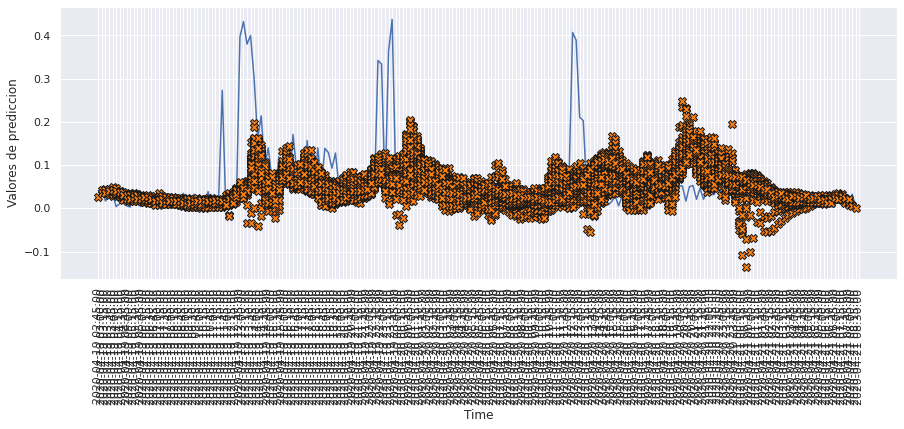

In [174]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict11, 120)

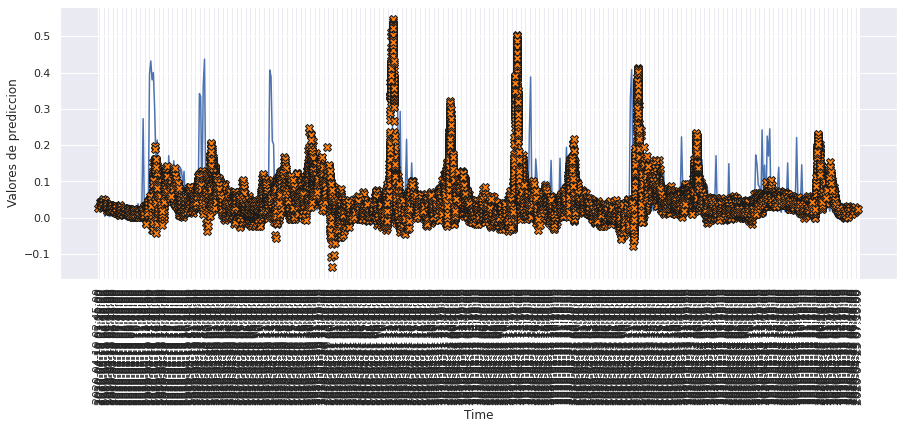

In [175]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict11, 500)

# MODELO 12: LSTM UNRESTRICTED UNA CAPA

### Construimos el modelo

In [176]:
def build_model12():
    model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(n_entrada, n_features)),
        tf.keras.layers.LSTM(128, activation='tanh', return_sequences=True),
        tf.keras.layers.Flatten(),
        tf.keras.layers.Dense(n_predicciones)
    ])

    optimizer = tf.keras.optimizers.Adam()

    model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', smape])

    return model

In [177]:
model12 = build_model12()
model12.summary()

Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_10 (LSTM)              (None, 288, 128)          66560     
                                                                 
 flatten_4 (Flatten)         (None, 36864)             0         
                                                                 
 dense_12 (Dense)            (None, 96)                3539040   
                                                                 
Total params: 3,605,600
Trainable params: 3,605,600
Non-trainable params: 0
_________________________________________________________________


### Entrenamiento del modelo

In [178]:
history12 = model12.fit(scaled_trainX, data_trainY, epochs=n_epochs, batch_size = batch_size, 
                    validation_data=(scaled_valX, data_valY), verbose = 1, callbacks=[early_stop])

Epoch 1/200
351/351 [==============================] - 13s 35ms/step - loss: 0.0058 - mae: 0.0450 - mse: 0.0058 - smape: 0.8017 - val_loss: 0.0064 - val_mae: 0.0421 - val_mse: 0.0064 - val_smape: 0.7594
Epoch 2/200
351/351 [==============================] - 12s 34ms/step - loss: 0.0057 - mae: 0.0442 - mse: 0.0057 - smape: 0.7843 - val_loss: 0.0065 - val_mae: 0.0474 - val_mse: 0.0065 - val_smape: 0.8104
Epoch 3/200
351/351 [==============================] - 12s 34ms/step - loss: 0.0056 - mae: 0.0440 - mse: 0.0056 - smape: 0.7806 - val_loss: 0.0063 - val_mae: 0.0437 - val_mse: 0.0063 - val_smape: 0.7649
Epoch 4/200
351/351 [==============================] - 12s 35ms/step - loss: 0.0056 - mae: 0.0439 - mse: 0.0056 - smape: 0.7812 - val_loss: 0.0063 - val_mae: 0.0435 - val_mse: 0.0063 - val_smape: 0.7640
Epoch 5/200
351/351 [==============================] - 12s 34ms/step - loss: 0.0056 - mae: 0.0438 - mse: 0.0056 - smape: 0.7814 - val_loss: 0.0063 - val_mae: 0.0445 - val_mse: 0.0063 - val

351/351 [==============================] - 12s 34ms/step - loss: 0.0248 - mae: 0.1085 - mse: 0.0248 - smape: 1.3659 - val_loss: 0.0215 - val_mae: 0.1077 - val_mse: 0.0215 - val_smape: 1.4975
Epoch 82/200
351/351 [==============================] - 12s 34ms/step - loss: 0.0186 - mae: 0.1007 - mse: 0.0186 - smape: 1.3469 - val_loss: 0.0572 - val_mae: 0.1236 - val_mse: 0.0572 - val_smape: 1.4571
Epoch 83/200
351/351 [==============================] - 12s 33ms/step - loss: 0.0244 - mae: 0.1089 - mse: 0.0244 - smape: 1.3696 - val_loss: 0.0246 - val_mae: 0.1124 - val_mse: 0.0246 - val_smape: 1.4858
Epoch 84/200
351/351 [==============================] - 12s 34ms/step - loss: 0.0195 - mae: 0.1025 - mse: 0.0195 - smape: 1.3522 - val_loss: 0.0213 - val_mae: 0.1056 - val_mse: 0.0213 - val_smape: 1.4296
Epoch 85/200
351/351 [==============================] - 12s 33ms/step - loss: 0.0241 - mae: 0.1080 - mse: 0.0241 - smape: 1.3666 - val_loss: 0.0224 - val_mae: 0.1078 - val_mse: 0.0224 - val_smape: 

In [179]:
hist12 = pd.DataFrame(history12.history)
hist12['epoch'] = history12.epoch
hist12

,loss,mae,mse,smape,val_loss,val_mae,val_mse,val_smape,epoch
0,0.005817,0.045041,0.005817,0.801709,0.006450,0.042122,0.006450,0.759406,0
1,0.005672,0.044202,0.005672,0.784350,0.006474,0.047386,0.006474,0.810432,1
2,0.005626,0.044005,0.005626,0.780623,0.006336,0.043723,0.006336,0.764929,2
3,0.005581,0.043917,0.005581,0.781226,0.006314,0.043472,0.006314,0.763968,3
4,0.005556,0.043843,0.005556,0.781372,0.006328,0.044458,0.006328,0.778427,4
...,...,...,...,...,...,...,...,...,...
111,0.023797,0.105831,0.023797,1.338466,0.029777,0.118882,0.029777,1.305755,111
112,0.021988,0.098972,0.021988,1.310863,0.020500,0.108233,0.020500,1.352540,112
113,0.016648,0.093154,0.016648,1.307227,0.015698,0.088719,0.015698,1.382015,113
114,0.017528,0.095730,0.017528,1.321044,0.019865,0.101842,0.019865,1.414375,114


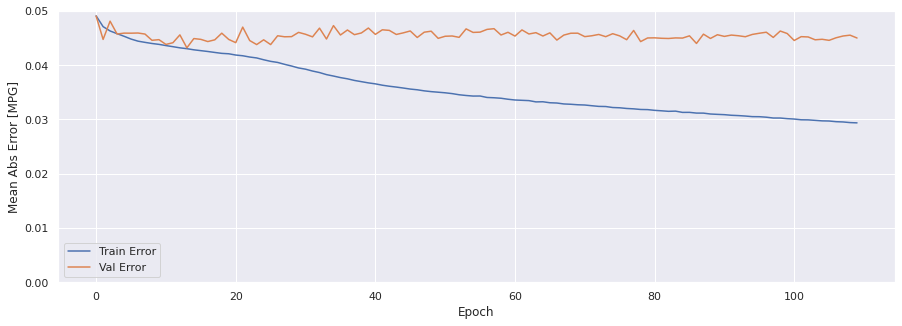

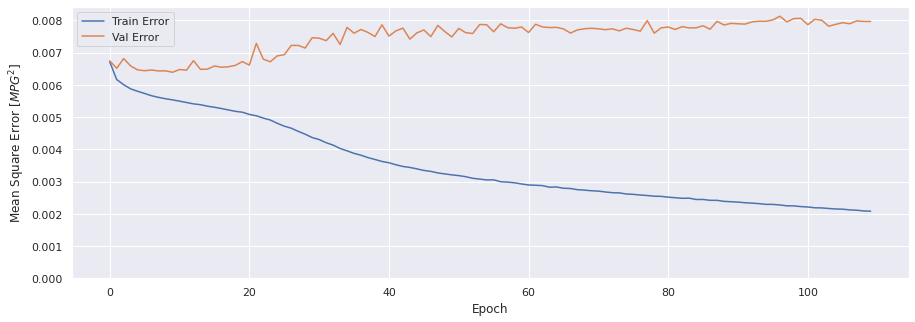

In [180]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_history(history11)

### Evaluar predicciones

In [181]:
score_train12 = model12.evaluate(scaled_trainX, data_trainY, verbose=1)
print(f'Loss:{score_train12[0]}')
print(f'MAE:{score_train12[1]}')
print(f'MSE:{score_train12[2]}')
print(f'SMAPE:{score_train12[3]}')

1401/1401 [==============================] - 19s 13ms/step - loss: 0.0260 - mae: 0.1170 - mse: 0.0260 - smape: 1.3408
Loss:0.025970958173274994
MAE:0.11704743653535843
MSE:0.025970958173274994
SMAPE:1.3408076763153076


In [182]:
score_val12 = model12.evaluate(scaled_valX, data_valY, verbose=1)
print(f'Loss:{score_val12[0]}')
print(f'MAE:{score_val12[1]}')
print(f'MSE:{score_val12[2]}')
print(f'SMAPE:{score_val12[3]}')

291/291 [==============================] - 4s 15ms/step - loss: 0.0281 - mae: 0.1209 - mse: 0.0281 - smape: 1.3801
Loss:0.028075547888875008
MAE:0.12091490626335144
MSE:0.028075547888875008
SMAPE:1.3801116943359375


In [183]:
score_test12 = model12.evaluate(scaled_testX, data_testY, verbose=1)
print(f'Loss:{score_test12[0]}')
print(f'MAE:{score_test12[1]}')
print(f'MSE:{score_test12[2]}')
print(f'SMAPE:{score_test12[3]}')

291/291 [==============================] - 4s 15ms/step - loss: 0.0271 - mae: 0.1204 - mse: 0.0271 - smape: 1.3668
Loss:0.0271142590790987
MAE:0.12042319029569626
MSE:0.0271142590790987
SMAPE:1.3667795658111572


### Comparativa de resultados

In [184]:
result = hist12.iloc[-1]
comparativa12 = pd.DataFrame(np.array([[result['mae'], result['mse'], result['smape'], math.sqrt(result['mse'])], 
                                      [result['val_mae'], result['val_mse'], result['val_smape'], math.sqrt(result['val_mse'])],
                                      [score_test12[1], score_test12[2], score_test12[3], math.sqrt(score_test12[2])]]),
                            columns = ['MAE', 'MSE', 'SMAPE', 'RMSE'],
                            index = ['ENTRENAMIENTO', 'VALIDACION', 'TEST'])

comparativa12.style.set_caption("Método de ventana de varios pasos - LSTM UNRESTRICTED una capa")

,MAE,MSE,SMAPE,RMSE
ENTRENAMIENTO,0.101193,0.022142,1.327881,0.148800
VALIDACION,0.120915,0.028076,1.380451,0.167558
TEST,0.120423,0.027114,1.366780,0.164664


### Obtener predicciones

In [185]:
trainPredict12 = model12.predict(scaled_trainX)
testPredict12 = model12.predict(scaled_testX)

### Visualización de las predicciones

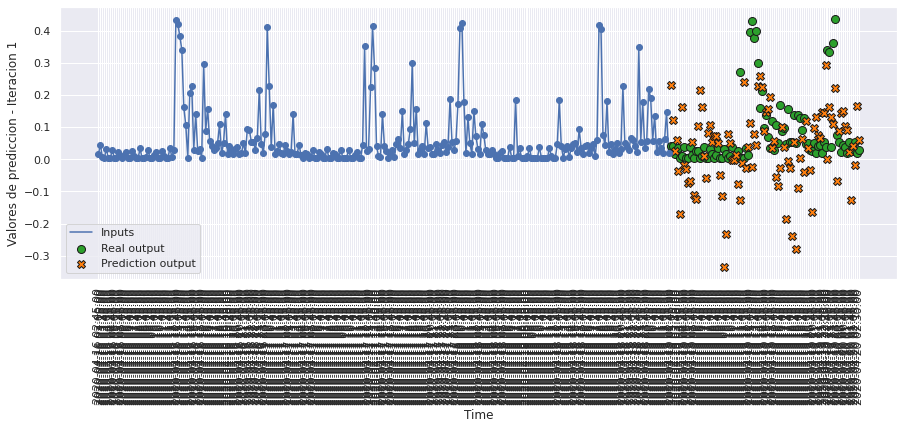

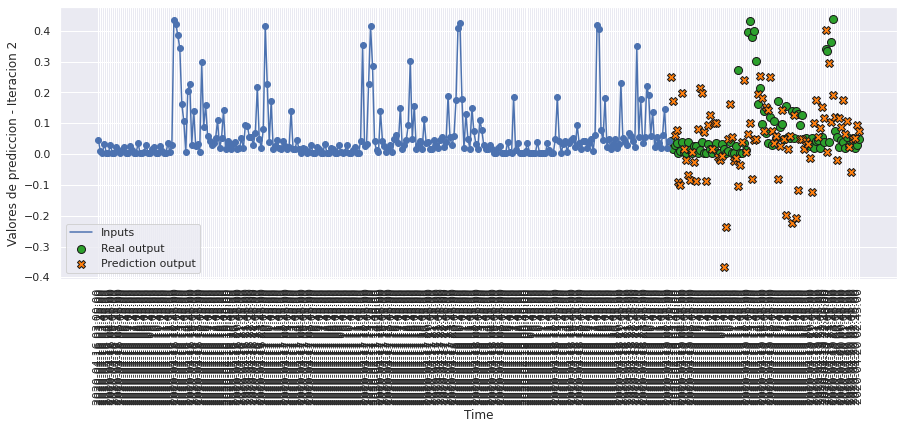

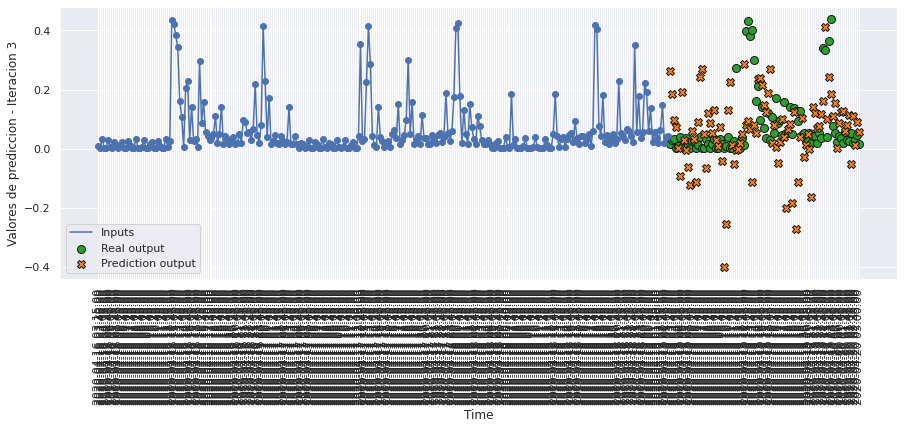

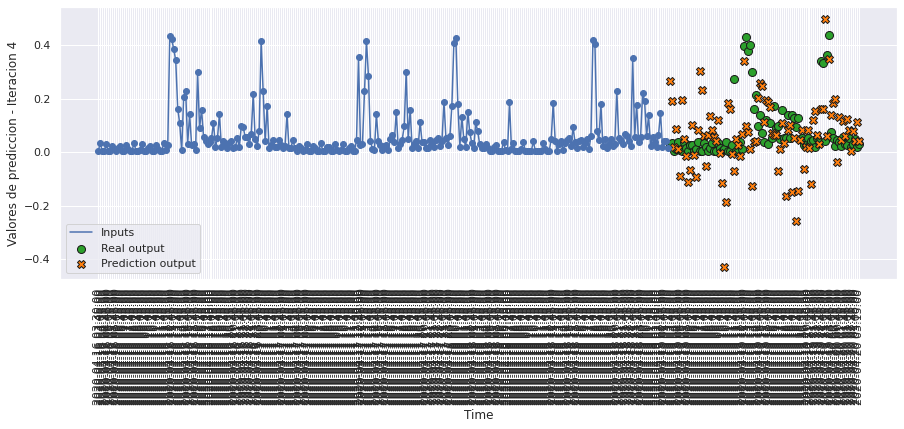

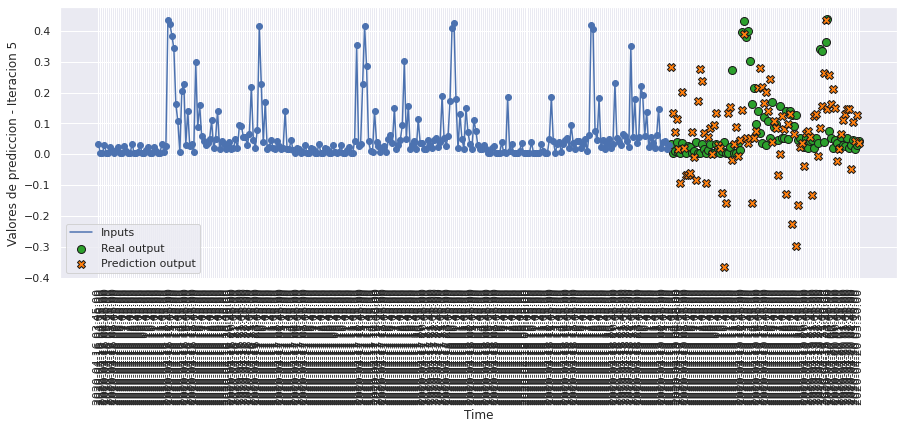

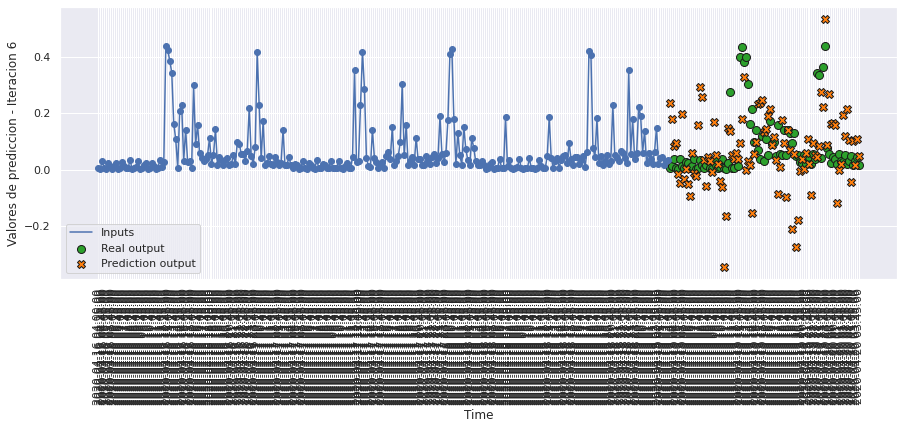

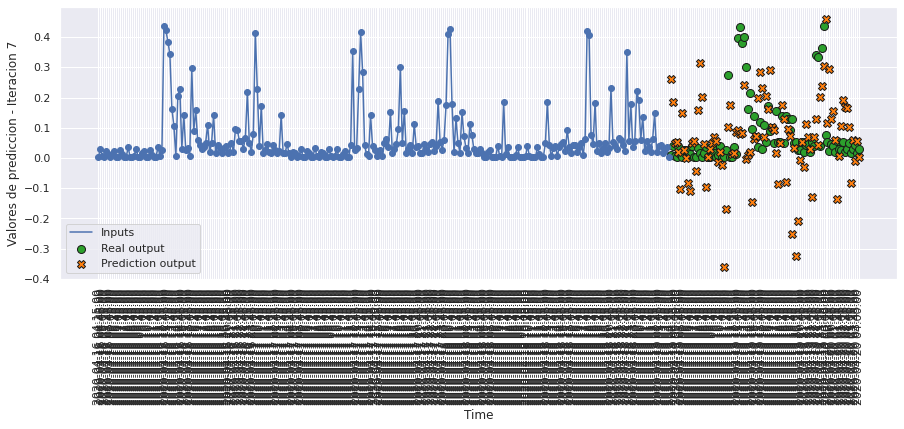

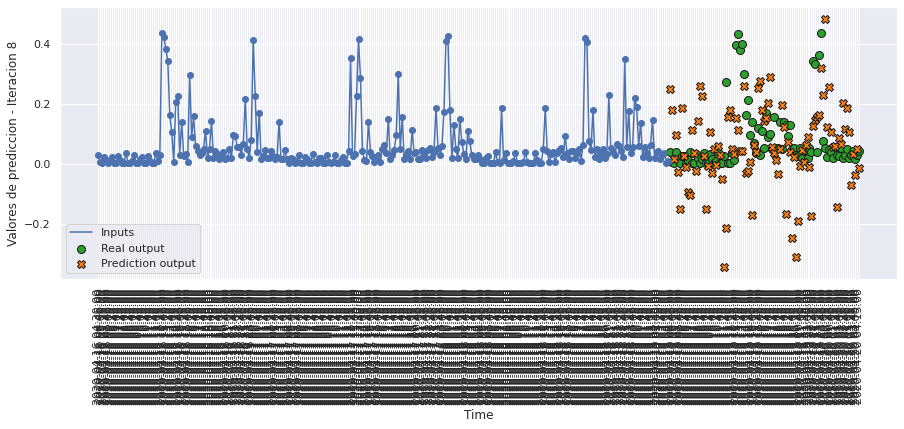

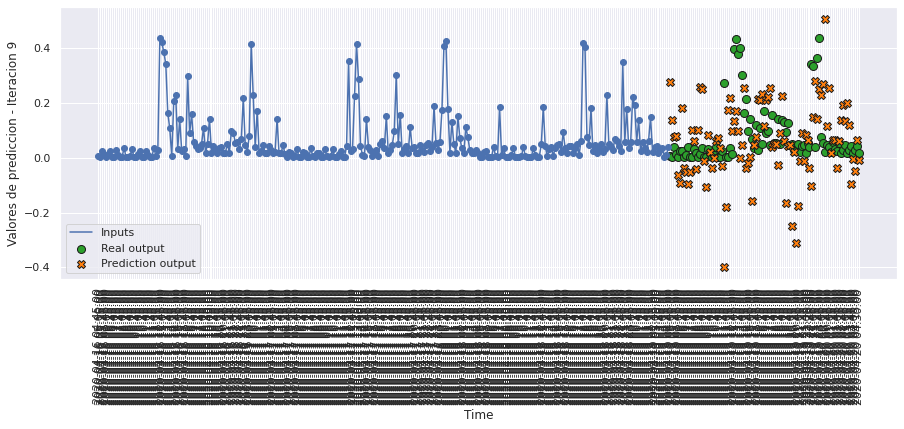

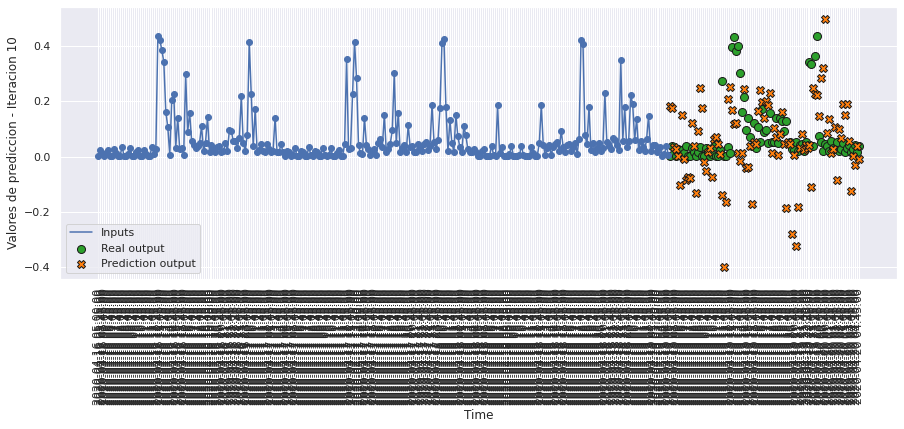

In [186]:
plot_window_predictions(int(test_df.iloc[0].name), int(test_df.iloc[-1].name), data_testY, testPredict12, 10, 0)

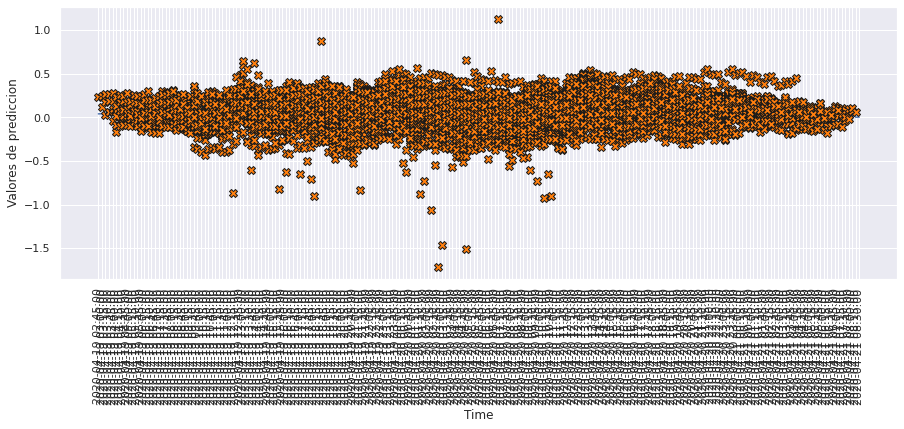

In [187]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict12, 120)

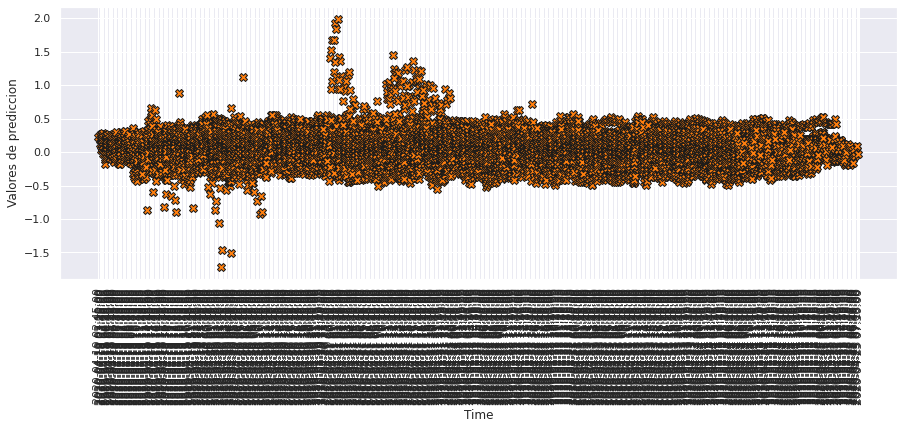

In [188]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict12, 500)

# MODELO 13: LSTM UNRESTRICTED DOS CAPAS

### Construimos el modelo

In [189]:
def build_model13():
    model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(n_entrada, n_features)),
        tf.keras.layers.LSTM(128, activation='tanh', return_sequences=True),
        tf.keras.layers.LSTM(128, activation='tanh', return_sequences=True),
        tf.keras.layers.Flatten(),
        tf.keras.layers.Dense(n_predicciones)
    ])

    optimizer = tf.keras.optimizers.Adam()

    model.compile(loss='mse', optimizer=optimizer, metrics=['mae', 'mse', smape])

    return model

In [190]:
model13 = build_model13()
model13.summary()

Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_11 (LSTM)              (None, 288, 128)          66560     
                                                                 
 lstm_12 (LSTM)              (None, 288, 128)          131584    
                                                                 
 flatten_5 (Flatten)         (None, 36864)             0         
                                                                 
 dense_13 (Dense)            (None, 96)                3539040   
                                                                 
Total params: 3,737,184
Trainable params: 3,737,184
Non-trainable params: 0
_________________________________________________________________


### Entrenamiento del modelo

In [191]:
history13 = model13.fit(scaled_trainX, data_trainY, epochs=n_epochs, batch_size = batch_size, 
                    validation_data=(scaled_valX, data_valY), verbose = 1, callbacks=[early_stop])

Epoch 1/200
351/351 [==============================] - 25s 66ms/step - loss: 0.0059 - mae: 0.0452 - mse: 0.0059 - smape: 0.7981 - val_loss: 0.0064 - val_mae: 0.0439 - val_mse: 0.0064 - val_smape: 0.7660
Epoch 2/200
351/351 [==============================] - 23s 65ms/step - loss: 0.0056 - mae: 0.0441 - mse: 0.0056 - smape: 0.7809 - val_loss: 0.0064 - val_mae: 0.0463 - val_mse: 0.0064 - val_smape: 0.8016
Epoch 3/200
351/351 [==============================] - 22s 64ms/step - loss: 0.0056 - mae: 0.0440 - mse: 0.0056 - smape: 0.7820 - val_loss: 0.0063 - val_mae: 0.0416 - val_mse: 0.0063 - val_smape: 0.7494
Epoch 4/200
351/351 [==============================] - 22s 63ms/step - loss: 0.0056 - mae: 0.0439 - mse: 0.0056 - smape: 0.7840 - val_loss: 0.0063 - val_mae: 0.0436 - val_mse: 0.0063 - val_smape: 0.7714
Epoch 5/200
351/351 [==============================] - 22s 64ms/step - loss: 0.0055 - mae: 0.0437 - mse: 0.0055 - smape: 0.7840 - val_loss: 0.0063 - val_mae: 0.0442 - val_mse: 0.0063 - val

351/351 [==============================] - 22s 63ms/step - loss: 5.0172e-04 - mae: 0.0167 - mse: 5.0172e-04 - smape: 0.6285 - val_loss: 0.0094 - val_mae: 0.0612 - val_mse: 0.0094 - val_smape: 1.0864
Epoch 42/200
351/351 [==============================] - 22s 63ms/step - loss: 4.5028e-04 - mae: 0.0159 - mse: 4.5028e-04 - smape: 0.6136 - val_loss: 0.0095 - val_mae: 0.0612 - val_mse: 0.0095 - val_smape: 1.0940
Epoch 43/200
351/351 [==============================] - 22s 63ms/step - loss: 4.1529e-04 - mae: 0.0153 - mse: 4.1529e-04 - smape: 0.6025 - val_loss: 0.0094 - val_mae: 0.0613 - val_mse: 0.0094 - val_smape: 1.0849
Epoch 44/200
351/351 [==============================] - 23s 65ms/step - loss: 3.6838e-04 - mae: 0.0144 - mse: 3.6838e-04 - smape: 0.5859 - val_loss: 0.0096 - val_mae: 0.0617 - val_mse: 0.0096 - val_smape: 1.0956
Epoch 45/200
351/351 [==============================] - 23s 64ms/step - loss: 3.4944e-04 - mae: 0.0141 - mse: 3.4944e-04 - smape: 0.5793 - val_loss: 0.0096 - val_mae

Epoch 80/200
351/351 [==============================] - 22s 63ms/step - loss: 8.0357e-05 - mae: 0.0069 - mse: 8.0357e-05 - smape: 0.3802 - val_loss: 0.0095 - val_mae: 0.0620 - val_mse: 0.0095 - val_smape: 1.1084
Epoch 81/200
351/351 [==============================] - 22s 63ms/step - loss: 7.9519e-05 - mae: 0.0068 - mse: 7.9519e-05 - smape: 0.3793 - val_loss: 0.0095 - val_mae: 0.0621 - val_mse: 0.0095 - val_smape: 1.1050
Epoch 82/200
351/351 [==============================] - 22s 64ms/step - loss: 8.2339e-05 - mae: 0.0070 - mse: 8.2339e-05 - smape: 0.3824 - val_loss: 0.0095 - val_mae: 0.0615 - val_mse: 0.0095 - val_smape: 1.1112
Epoch 83/200
351/351 [==============================] - 23s 64ms/step - loss: 8.2016e-05 - mae: 0.0070 - mse: 8.2016e-05 - smape: 0.3826 - val_loss: 0.0093 - val_mae: 0.0611 - val_mse: 0.0093 - val_smape: 1.0983
Epoch 84/200
351/351 [==============================] - 23s 64ms/step - loss: 7.7201e-05 - mae: 0.0068 - mse: 7.7201e-05 - smape: 0.3756 - val_loss: 0.0

In [192]:
hist13 = pd.DataFrame(history13.history)
hist13['epoch'] = history13.epoch
hist13

,loss,mae,mse,smape,val_loss,val_mae,val_mse,val_smape,epoch
0,0.005874,0.045160,0.005874,0.798077,0.006412,0.043912,0.006412,0.765970,0
1,0.005630,0.044056,0.005630,0.780915,0.006351,0.046343,0.006351,0.801611,1
2,0.005587,0.043960,0.005587,0.781958,0.006329,0.041615,0.006329,0.749404,2
3,0.005559,0.043868,0.005559,0.783982,0.006291,0.043568,0.006291,0.771406,3
4,0.005513,0.043684,0.005513,0.783956,0.006261,0.044196,0.006261,0.780481,4
...,...,...,...,...,...,...,...,...,...
105,0.000058,0.005820,0.000058,0.338708,0.009307,0.060718,0.009307,1.096556,105
106,0.000054,0.005637,0.000054,0.332020,0.009363,0.061165,0.009363,1.100551,106
107,0.000056,0.005723,0.000056,0.334954,0.009370,0.061137,0.009370,1.102832,107
108,0.000053,0.005616,0.000053,0.331285,0.009370,0.061314,0.009370,1.099503,108


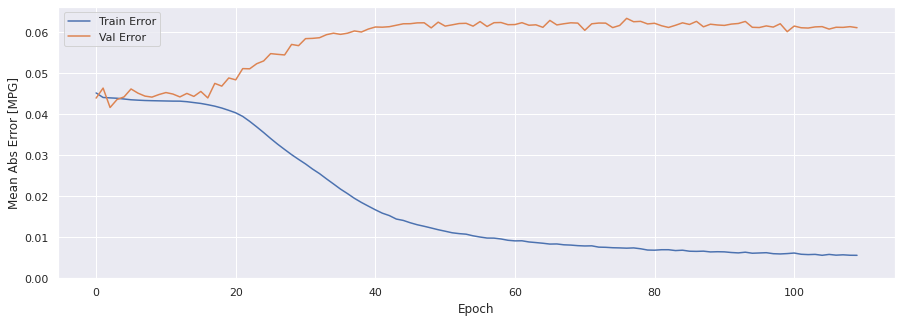

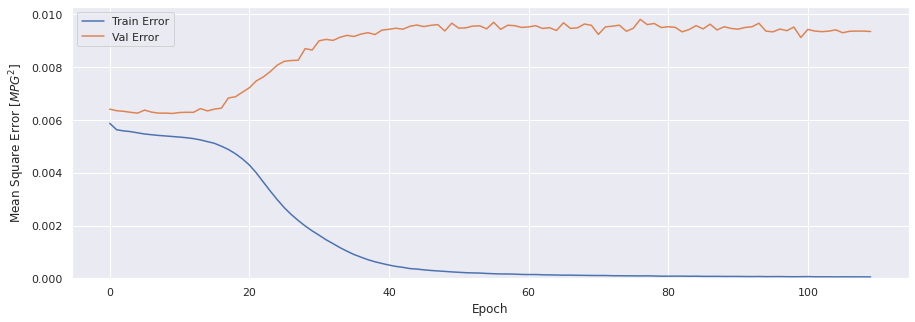

In [193]:
sns.set(rc = {'figure.figsize':(15,5)})
plot_history(history13)

### Evaluar predicciones

In [194]:
score_train13 = model13.evaluate(scaled_trainX, data_trainY, verbose=1)
print(f'Loss:{score_train13[0]}')
print(f'MAE:{score_train13[1]}')
print(f'MSE:{score_train13[2]}')
print(f'SMAPE:{score_train13[3]}')

1401/1401 [==============================] - 35s 25ms/step - loss: 5.4008e-05 - mae: 0.0056 - mse: 5.4008e-05 - smape: 0.3304
Loss:5.400783265940845e-05
MAE:0.005619632545858622
MSE:5.400783265940845e-05
SMAPE:0.33044296503067017


In [195]:
score_val13 = model13.evaluate(scaled_valX, data_valY, verbose=1)
print(f'Loss:{score_val13[0]}')
print(f'MAE:{score_val13[1]}')
print(f'MSE:{score_val13[2]}')
print(f'SMAPE:{score_val13[3]}')

291/291 [==============================] - 7s 25ms/step - loss: 0.0094 - mae: 0.0611 - mse: 0.0094 - smape: 1.1020
Loss:0.009354019537568092
MAE:0.06105754151940346
MSE:0.009354019537568092
SMAPE:1.1020243167877197


In [196]:
score_test13 = model13.evaluate(scaled_testX, data_testY, verbose=1)
print(f'Loss:{score_test13[0]}')
print(f'MAE:{score_test13[1]}')
print(f'MSE:{score_test13[2]}')
print(f'SMAPE:{score_test13[3]}')

291/291 [==============================] - 7s 25ms/step - loss: 0.0092 - mae: 0.0626 - mse: 0.0092 - smape: 1.0940
Loss:0.009201441891491413
MAE:0.06255903840065002
MSE:0.009201441891491413
SMAPE:1.093997597694397


### Comparativa de resultados

In [197]:
result = hist13.iloc[-1]
comparativa13 = pd.DataFrame(np.array([[result['mae'], result['mse'], result['smape'], math.sqrt(result['mse'])], 
                                      [result['val_mae'], result['val_mse'], result['val_smape'], math.sqrt(result['val_mse'])],
                                      [score_test13[1], score_test13[2], score_test13[3], math.sqrt(score_test13[2])]]),
                            columns = ['MAE', 'MSE', 'SMAPE', 'RMSE'],
                            index = ['ENTRENAMIENTO', 'VALIDACION', 'TEST'])

comparativa13.style.set_caption("Método de ventana de varios pasos - LSTM UNRESTRICTED dos capas")

,MAE,MSE,SMAPE,RMSE
ENTRENAMIENTO,0.005600,0.000053,0.330248,0.007286
VALIDACION,0.061058,0.009354,1.101965,0.096716
TEST,0.062559,0.009201,1.093998,0.095924


### Obtener predicciones

In [198]:
trainPredict13 = model13.predict(scaled_trainX)
testPredict13 = model13.predict(scaled_testX)

### Visualización de las predicciones

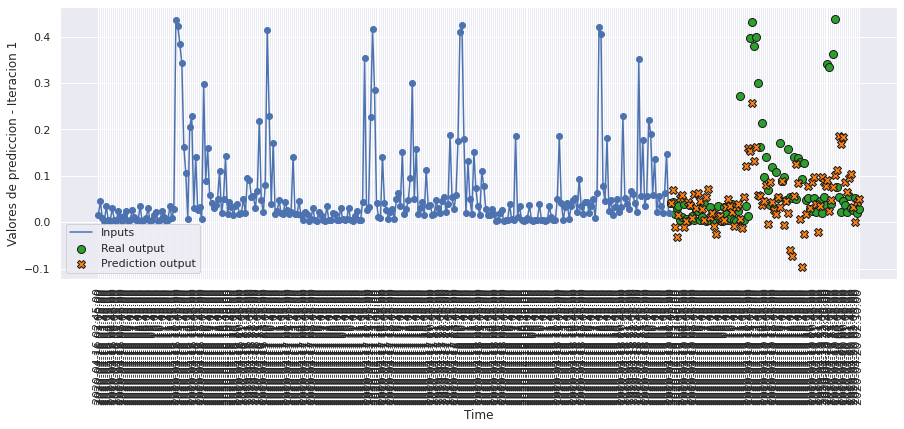

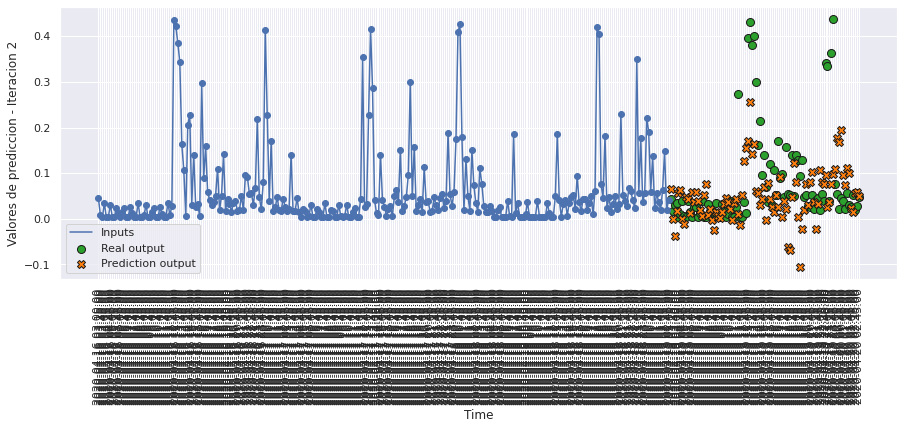

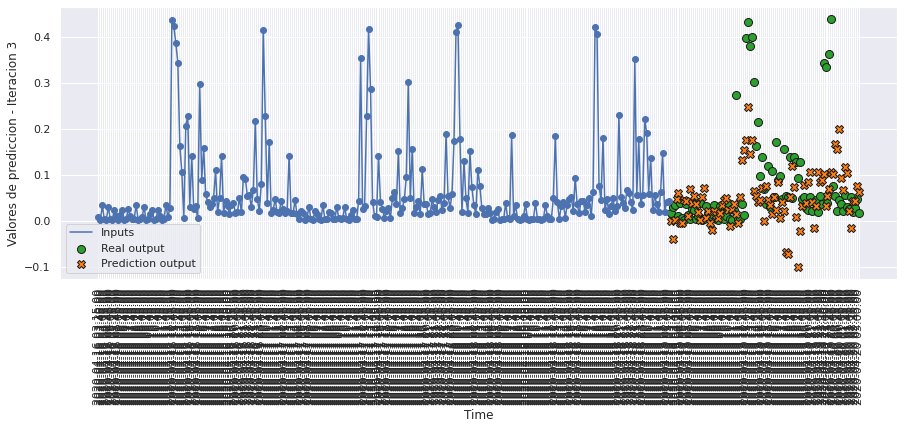

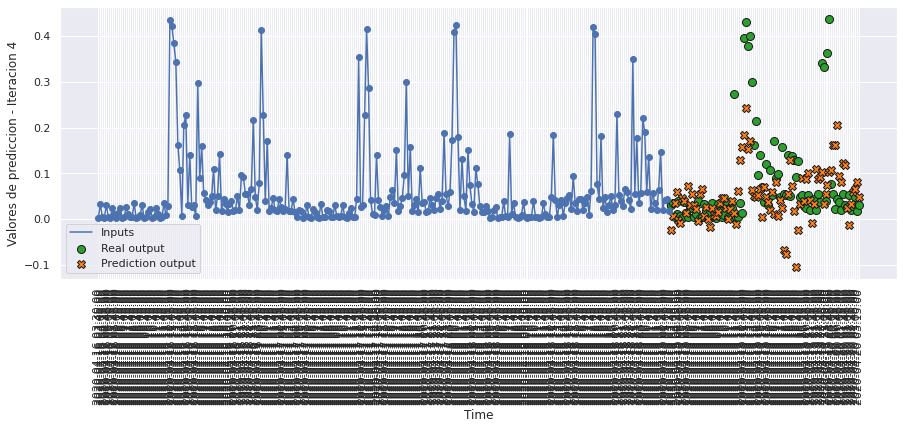

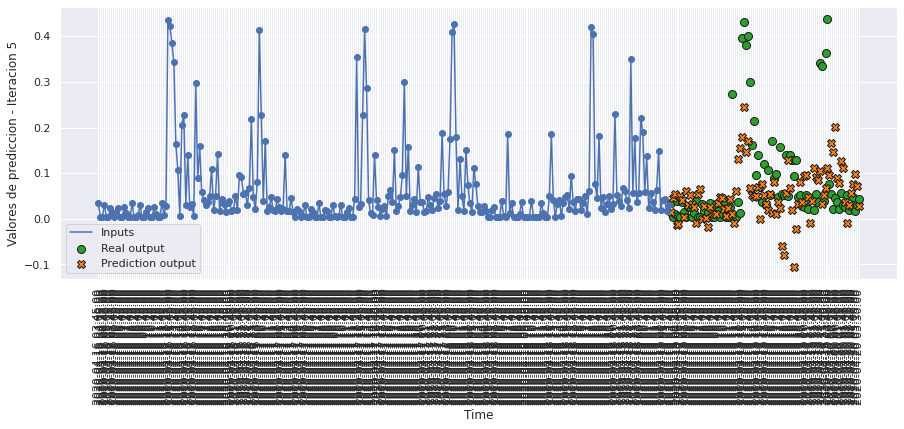

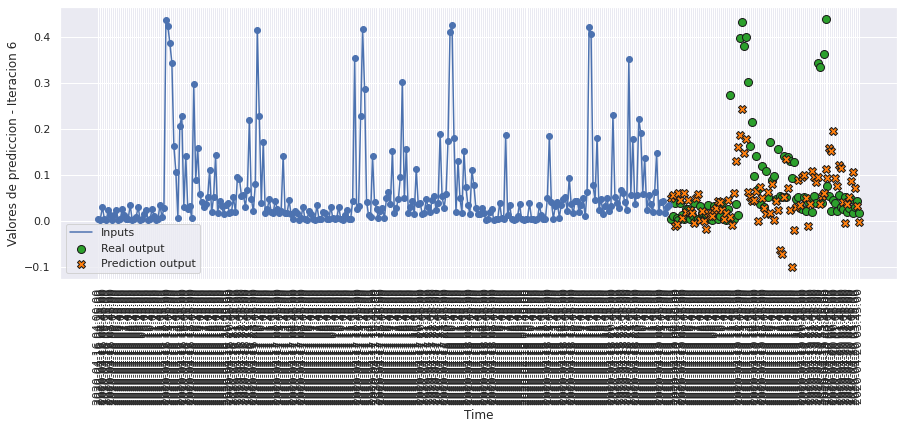

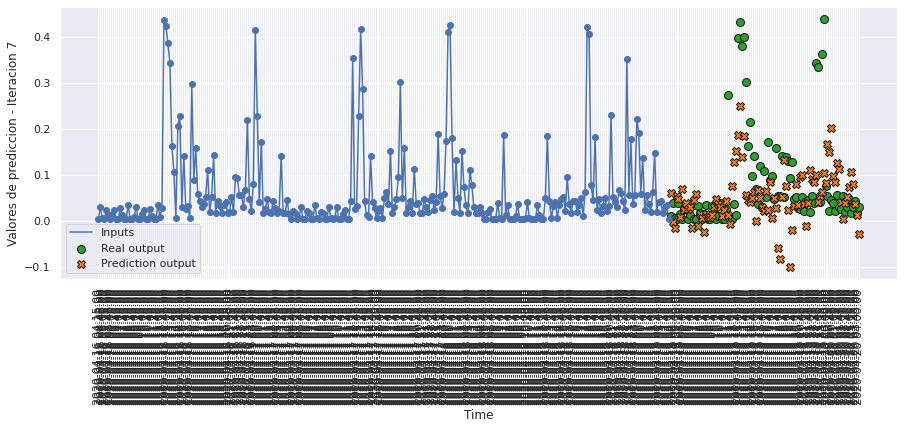

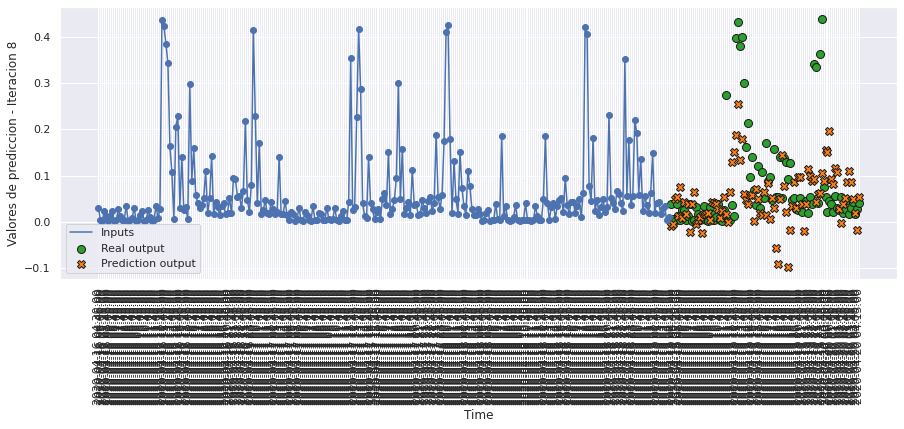

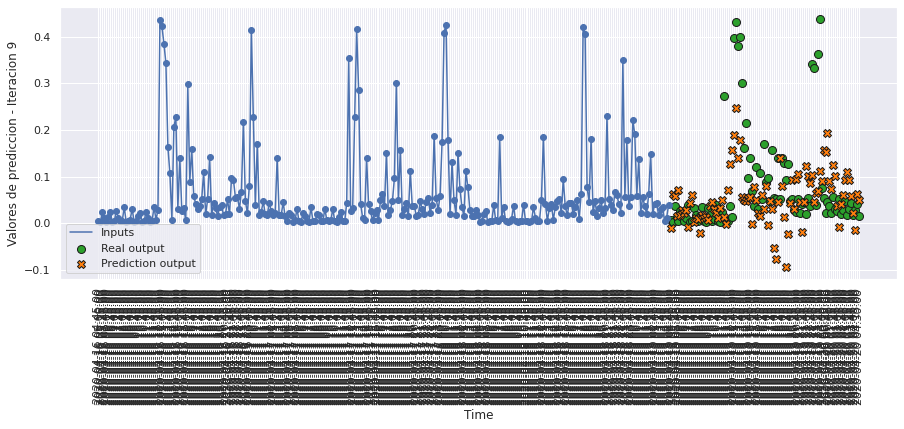

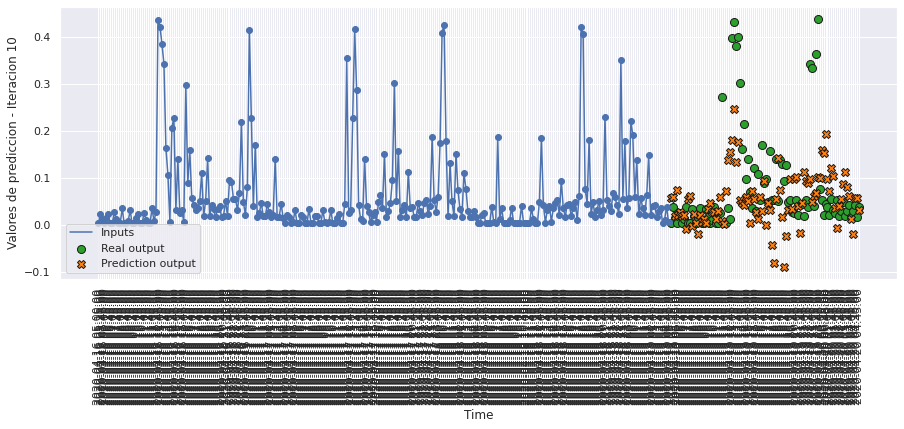

In [199]:
plot_window_predictions(int(test_df.iloc[0].name), int(test_df.iloc[-1].name), data_testY, testPredict13, 10, 0)

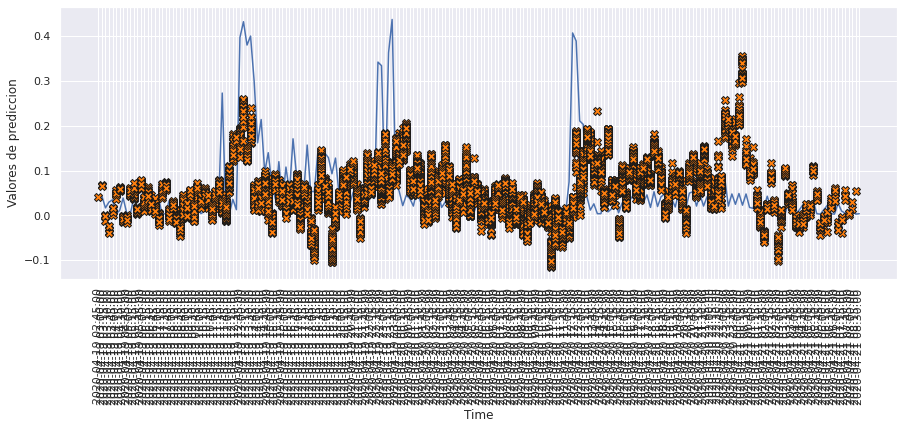

In [200]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict13, 120)

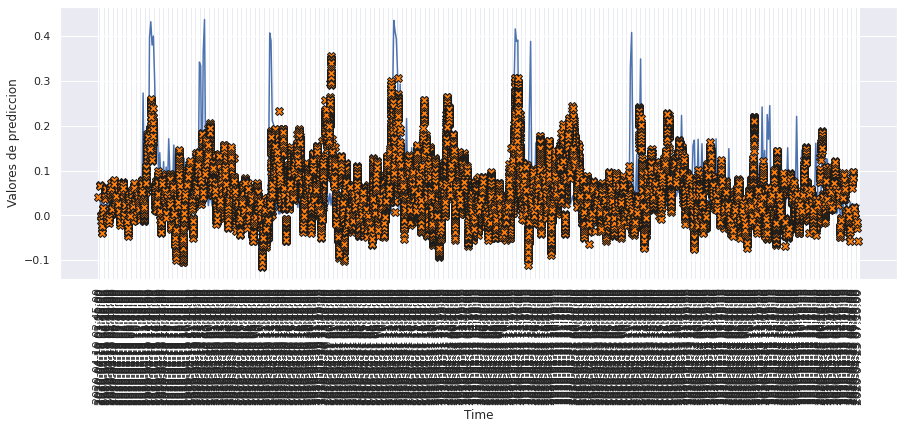

In [201]:
plot_window_predictions_values(int(test_df.iloc[0].name), testPredict13, 500)

# Comparación de modelos

In [202]:
idx = ['LSTM 1 Layer', 'LSTM 2 Layer', 'LSTM 3 Layer', 'Bidirectional LSTM', 
         'Conv 1D', 'Conv 1D con LSTM', 'ConvLSTM1D', 'ConvLSTM2D', 'LSTM Encode Decode', 
         'GRU 1 Layer', 'GRU 2 Layer', 'LSTM unrestricted 1 layer', 'LSTM unrestricted 2 layer']

col = ['TR_MAE', 'TR_MSE', 'TR_SMAPE', 'TR_RMSE',
       'V_MAE', 'V_MSE', 'V_SMAPE', 'V_RMSE',
       'TS_MAE', 'TS_MSE', 'TS_SMAPE', 'TS_RMSE']

datos = [[score_train1[1], score_train1[2], score_train1[3], math.sqrt(score_train1[2]),
            score_val1[1],   score_val1[2],   score_val1[3],   math.sqrt(score_val1[2]),
           score_test1[1],  score_test1[2],  score_test1[3],  math.sqrt(score_test1[2])],
         [score_train2[1], score_train2[2], score_train2[3], math.sqrt(score_train2[2]),
            score_val2[1],   score_val2[2],   score_val2[3],   math.sqrt(score_val2[2]),
           score_test2[1],  score_test2[2],  score_test2[3],  math.sqrt(score_test2[2])],
         [score_train3[1], score_train3[2], score_train3[3], math.sqrt(score_train3[2]),
            score_val3[1],   score_val3[2],   score_val3[3],   math.sqrt(score_val3[2]),
           score_test3[1],  score_test3[2],  score_test3[3],  math.sqrt(score_test3[2])],
         [score_train4[1], score_train4[2], score_train4[3], math.sqrt(score_train4[2]),
            score_val4[1],   score_val4[2],   score_val4[3],   math.sqrt(score_val4[2]),
           score_test4[1],  score_test4[2],  score_test4[3],  math.sqrt(score_test4[2])],
         [score_train5[1], score_train5[2], score_train5[3], math.sqrt(score_train5[2]),
            score_val5[1],   score_val5[2],   score_val5[3],   math.sqrt(score_val5[2]),
           score_test5[1],  score_test5[2],  score_test5[3],  math.sqrt(score_test5[2])],
         [score_train6[1], score_train6[2], score_train6[3], math.sqrt(score_train6[2]),
            score_val6[1],   score_val6[2],   score_val6[3],   math.sqrt(score_val6[2]),
           score_test6[1],  score_test6[2],  score_test6[3],  math.sqrt(score_test6[2])],
         [score_train7[1], score_train7[2], score_train7[3], math.sqrt(score_train7[2]),
            score_val7[1],   score_val7[2],   score_val7[3],   math.sqrt(score_val7[2]),
           score_test7[1],  score_test7[2],  score_test7[3],  math.sqrt(score_test7[2])],
         [score_train8[1], score_train8[2], score_train8[3], math.sqrt(score_train8[2]),
            score_val8[1],   score_val8[2],   score_val8[3],   math.sqrt(score_val8[2]),
           score_test8[1],  score_test8[2],  score_test8[3],  math.sqrt(score_test8[2])],
         [score_train9[1], score_train9[2], score_train9[3], math.sqrt(score_train9[2]),
            score_val9[1],   score_val9[2],   score_val9[3],   math.sqrt(score_val9[2]),
           score_test9[1],  score_test9[2],  score_test9[3],  math.sqrt(score_test9[2])],
         [score_train10[1], score_train10[2], score_train10[3], math.sqrt(score_train10[2]),
            score_val10[1],   score_val10[2],   score_val10[3],   math.sqrt(score_val10[2]),
           score_test10[1],  score_test10[2],  score_test10[3],  math.sqrt(score_test10[2])],
         [score_train11[1], score_train11[2], score_train11[3], math.sqrt(score_train11[2]),
            score_val11[1],   score_val11[2],   score_val11[3],   math.sqrt(score_val11[2]),
           score_test11[1],  score_test11[2],  score_test11[3],  math.sqrt(score_test11[2])],
         [score_train12[1], score_train12[2], score_train12[3], math.sqrt(score_train12[2]),
            score_val12[1],   score_val12[2],   score_val12[3],   math.sqrt(score_val12[2]),
           score_test12[1],  score_test12[2],  score_test12[3],  math.sqrt(score_test12[2])],
         [score_train13[1], score_train13[2], score_train13[3], math.sqrt(score_train13[2]),
            score_val13[1],   score_val13[2],   score_val13[3],   math.sqrt(score_val13[2]),
           score_test13[1],  score_test13[2],  score_test13[3],  math.sqrt(score_test13[2])]]

comparativa = pd.DataFrame(datos, columns = col, index = idx)
comparativa.style.set_caption("Tabla de comparación de todos los modelos - Método de ventana sólo valor 288 - 96")

,TR_MAE,TR_MSE,TR_SMAPE,TR_RMSE,V_MAE,V_MSE,V_SMAPE,V_RMSE,TS_MAE,TS_MSE,TS_SMAPE,TS_RMSE
LSTM 1 Layer,0.033896,0.003065,0.734225,0.055359,0.047379,0.008356,0.820066,0.091409,0.047902,0.007712,0.817422,0.087817
LSTM 2 Layer,0.027777,0.001828,0.678928,0.042757,0.044293,0.007981,0.764885,0.089337,0.046457,0.007536,0.782035,0.086808
LSTM 3 Layer,0.027499,0.001771,0.680533,0.042084,0.045645,0.008019,0.781881,0.089551,0.049305,0.008070,0.811237,0.089835
Bidirectional LSTM,0.032435,0.002594,0.731026,0.050934,0.046645,0.007699,0.826987,0.087746,0.048129,0.007335,0.822940,0.085643
Conv 1D,0.043862,0.005332,0.798541,0.073018,0.044440,0.006356,0.800184,0.079722,0.046746,0.006148,0.812746,0.078410
Conv 1D con LSTM,0.038977,0.004026,0.781880,0.063448,0.053306,0.008358,0.954356,0.091423,0.050812,0.007161,0.902259,0.084622
ConvLSTM1D,0.043255,0.005261,0.795332,0.072534,0.044318,0.006384,0.794958,0.079897,0.046462,0.006169,0.802714,0.078543
ConvLSTM2D,0.042807,0.005082,0.806269,0.071285,0.044421,0.006426,0.811450,0.080163,0.046938,0.006297,0.825686,0.079353
LSTM Encode Decode,0.030513,0.002651,0.666455,0.051483,0.045832,0.008384,0.742376,0.091564,0.047073,0.007694,0.762502,0.087715
GRU 1 Layer,0.036665,0.003680,0.752455,0.060661,0.046023,0.007893,0.800694,0.088842,0.048603,0.007795,0.822848,0.088291


<AxesSubplot:title={'center':'Comparativa del error en los modelos para el día del método de ventana de varios pasos con sólo el valor'}>

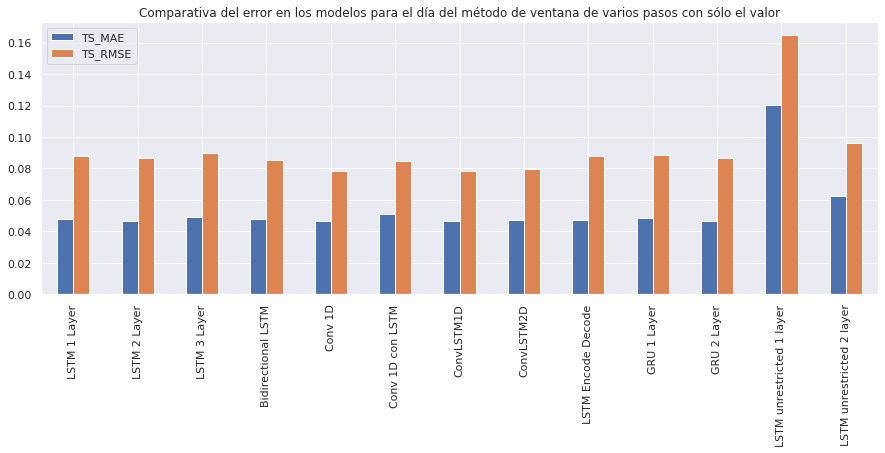

In [203]:
comparativa.loc[:, ['TS_MAE', 'TS_RMSE']].plot(kind='bar', title = 'Comparativa del error en los modelos para el día del método de ventana de varios pasos con sólo el valor')

<AxesSubplot:title={'center':'Comparativa del error porcentual absoluto medio simétrico para el día del método de ventana de varios pasos con sólo el valor'}>

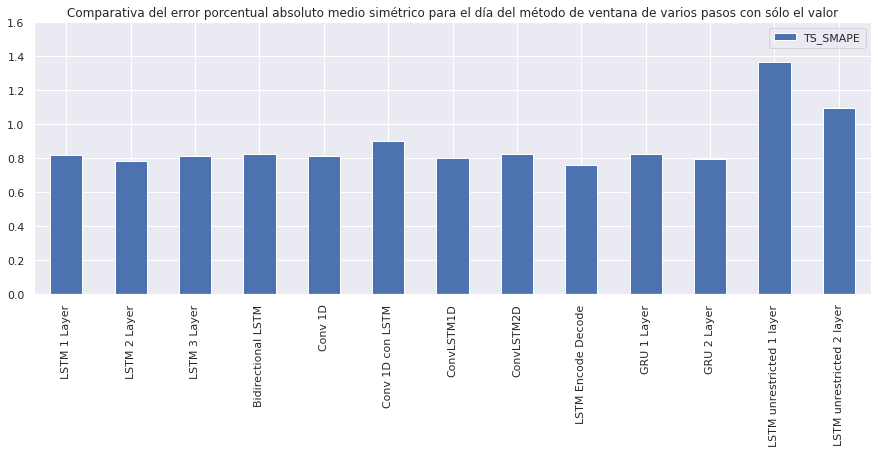

In [204]:
comparativa.loc[:, 'TS_SMAPE'].plot(kind='bar', legend=(['SMAPE']), ylim=(0, 1.6), 
                    title = 'Comparativa del error porcentual absoluto medio simétrico para el día del método de ventana de varios pasos con sólo el valor')

# Elección de modelo

In [207]:
model10.save('../../models/only_value/dayModel/1/')

INFO:tensorflow:Assets written to: ../../models/only_value/dayModel/1/assets


INFO:tensorflow:Assets written to: ../../models/only_value/dayModel/1/assets
